# 5. Chexnet Transformer Model EDA

### About this notebook

To check the input images that are fed into the Transformer model


In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader
import torchvision.transforms as transforms
import torchvision.datasets as datasets
CUDA = torch.cuda.is_available()
device = torch.device("cuda" if CUDA else "cpu")

### Load MNIST

At this point, do I really need to explain what this does?

In [2]:
import sys
# run the below line once only
if "..\\chexnet" not in sys.path:
    sys.path.insert(0,r'..\chexnet')
print(sys.path)

['..\\chexnet', 'c:\\Users\\siyang\\Documents\\GitHub\\DeepLearningProject\\notebooks', 'C:\\Python312\\python312.zip', 'C:\\Python312\\DLLs', 'C:\\Python312\\Lib', 'C:\\Python312', 'c:\\Users\\siyang\\Documents\\GitHub\\DeepLearningProject\\.venv', '', 'c:\\Users\\siyang\\Documents\\GitHub\\DeepLearningProject\\.venv\\Lib\\site-packages', 'C:\\Users\\siyang\\Documents\\GitHub\\DeepLearningProject', 'c:\\Users\\siyang\\Documents\\GitHub\\DeepLearningProject\\.venv\\Lib\\site-packages\\win32', 'c:\\Users\\siyang\\Documents\\GitHub\\DeepLearningProject\\.venv\\Lib\\site-packages\\win32\\lib', 'c:\\Users\\siyang\\Documents\\GitHub\\DeepLearningProject\\.venv\\Lib\\site-packages\\Pythonwin']


In [3]:
from DatasetGenerator import DatasetGenerator

In [4]:
pathDirData = '../raw_data/archive'
pathFileTrain = '../chexnet/dataset/train_1.txt'
pathFileVal = '../chexnet/dataset/val_1.txt'

transResize = 256
transCrop = 224
trBatchSize = 4
num_class = 14

normalize = transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])

transformList = []
# transformList.append(transforms.Resize(transResize))
transformList.append(transforms.RandomResizedCrop(transCrop))
transformList.append(transforms.RandomHorizontalFlip())
transformList.append(transforms.ToTensor())
transformList.append(normalize)      
transformSequence=transforms.Compose(transformList)

datasetTrain = DatasetGenerator(pathImageDirectory=pathDirData, pathDatasetFile=pathFileTrain, transform=transformSequence)
datasetVal =   DatasetGenerator(pathImageDirectory=pathDirData, pathDatasetFile=pathFileVal, transform=transformSequence)
train_loader = DataLoader(dataset=datasetTrain, batch_size=trBatchSize, shuffle=True,  num_workers=12, pin_memory=True)
val_loader = DataLoader(dataset=datasetVal, batch_size=trBatchSize, shuffle=False, num_workers=12, pin_memory=True)

Collected 2048 images from ../chexnet/dataset/train_1.txt
Collected 2048 images from ../chexnet/dataset/val_1.txt


### See the image before it enters the model
After the transformations have been done

In [5]:
import matplotlib.pyplot as plt
import numpy as np

def show_images_from_dataloader(images):
    # Assuming the dataloader returns (images, labels) tuples
        # Assuming images are in (batch_size, channels, height, width) format
        for i in range(len(images)):
            image = images[i]
            print('image tensor shape: ' + str(image.shape))
            # print(filename[i])
            # Convert tensor to numpy array
            image_np = image.permute(1, 2, 0).numpy()  # Change tensor shape from (C, H, W) to (H, W, C)
            # Display image
            plt.imshow(image_np)
            plt.axis('off')
            plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


['../raw_data/archive\\images_011/images/00027192_001.png', '../raw_data/archive\\images_006/images/00012413_003.png', '../raw_data/archive\\images_011/images/00025980_001.png', '../raw_data/archive\\images_004/images/00009001_007.png']
image tensor shape: torch.Size([3, 224, 224])


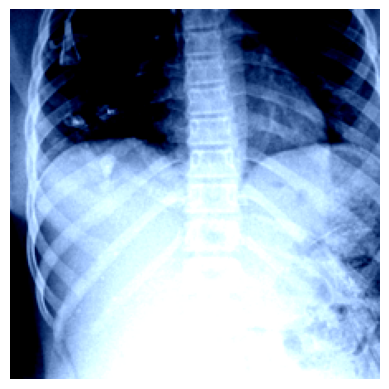

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


image tensor shape: torch.Size([3, 224, 224])


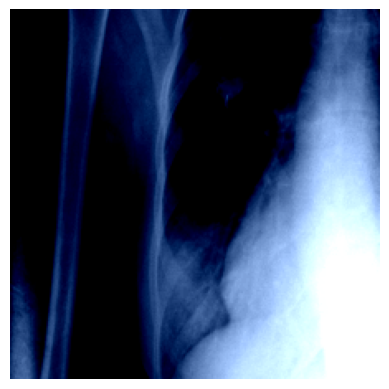

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


image tensor shape: torch.Size([3, 224, 224])


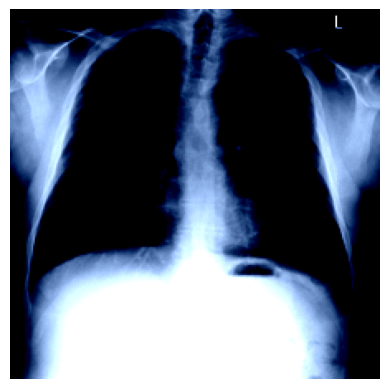

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


image tensor shape: torch.Size([3, 224, 224])


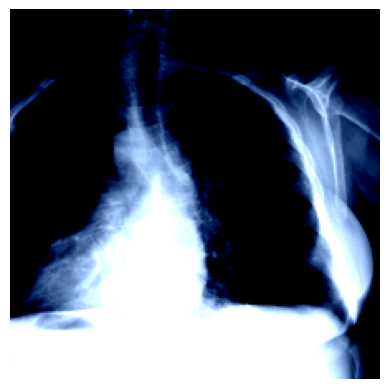

In [6]:
for images, _, filenames in train_loader:
    print(filenames)
    show_images_from_dataloader(images)
    break

### Define self-attention layer, and Transformer model

We will have to flatten the images to process them with Linear operations and attention operations.

In [7]:
## import libraries
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader
import torchvision.transforms as transforms
import torchvision.datasets as datasets

from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.utils.tensorboard import SummaryWriter

CUDA = torch.cuda.is_available()
# device = "cpu"
device = torch.device("cuda" if CUDA else "cpu")

In [8]:
from torchvision.models import maxvit

In [9]:
## Initialise first layer
model = maxvit.maxvit_t(
    weights = maxvit.MaxVit_T_Weights,
    input_size = (transCrop, transCrop)
)
##  Freeze earlier weights
for name, param in model.named_parameters():
    if 'classifier' not in name:
        param.requires_grad= False

##  Replace the last layer 
model.classifier[-1] = nn.Sequential(
    nn.Linear(in_features=model.classifier[5].in_features,out_features= num_class),
    nn.Sigmoid()
)

## set to cuda
model.cuda()

c:\Users\siyang\Documents\GitHub\DeepLearningProject\.venv\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MaxVit_T_Weights.IMAGENET1K_V1`. You can also use `weights=MaxVit_T_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
c:\Users\siyang\Documents\GitHub\DeepLearningProject\.venv\Lib\site-packages\torch\functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ..\aten\src\ATen\native\TensorShape.cpp:3550.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


MaxVit(
  (stem): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(64, eps=0.001, momentum=0.99, affine=True, track_running_stats=True)
      (2): GELU(approximate='none')
    )
    (1): Conv2dNormActivation(
      (0): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    )
  )
  (blocks): ModuleList(
    (0): MaxVitBlock(
      (layers): ModuleList(
        (0): MaxVitLayer(
          (layers): Sequential(
            (MBconv): MBConv(
              (proj): Sequential(
                (0): AvgPool2d(kernel_size=3, stride=2, padding=1)
                (1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1))
              )
              (stochastic_depth): Identity()
              (layers): Sequential(
                (pre_norm): BatchNorm2d(64, eps=0.001, momentum=0.99, affine=True, track_running_stats=True)
                (conv_a): Conv2dNormActivation(
           

In [10]:
model.classifier[-1][-0].weight.requires_grad

True

In [11]:
## function to calculate the F1 score
def f1_score(tp, fp, fn):
    return 2 * (tp) / (2 * tp + fp + fn)

torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


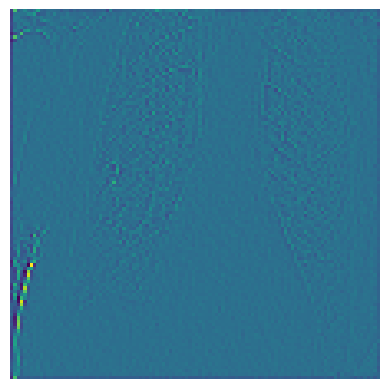

heres an image


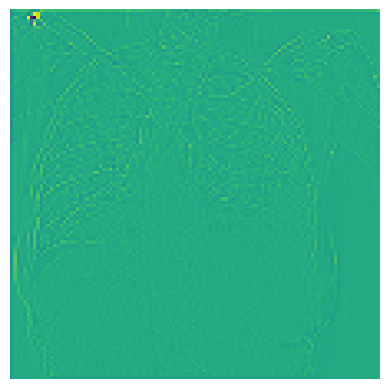

heres an image


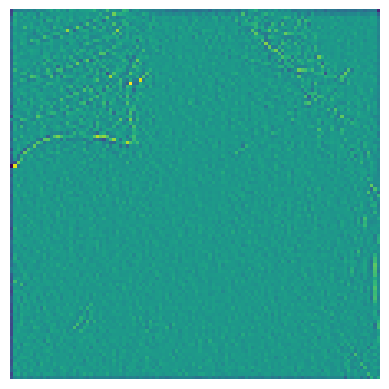

heres an image


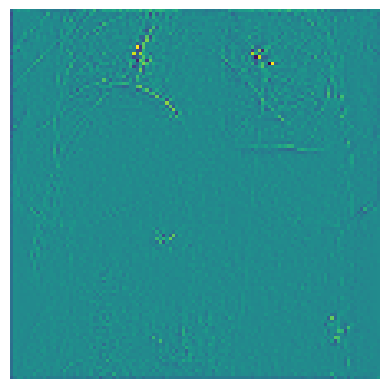

Epoch [1/5], Step [1/512], Loss: 0.6784, tp_sum: 4.0000, fp_sum: 52.0000, fn_sum: 0.0000, cumulative_f1_score: 0.1333
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


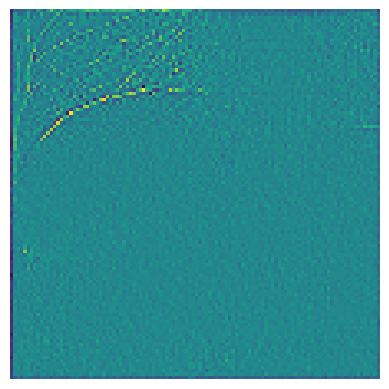

heres an image


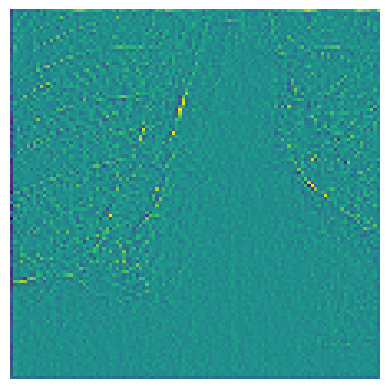

heres an image


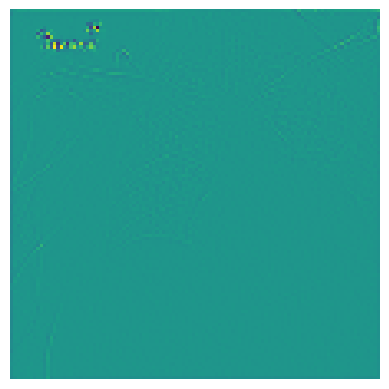

heres an image


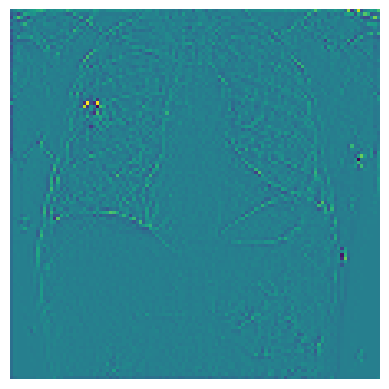

Epoch [1/5], Step [2/512], Loss: 0.6287, tp_sum: 2.0000, fp_sum: 54.0000, fn_sum: 0.0000, cumulative_f1_score: 0.0690
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


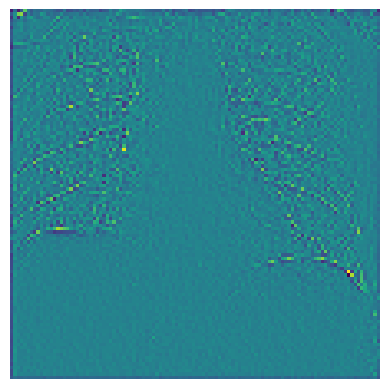

heres an image


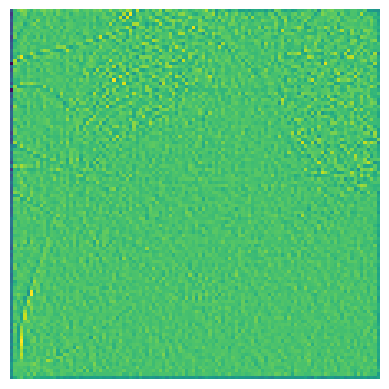

heres an image


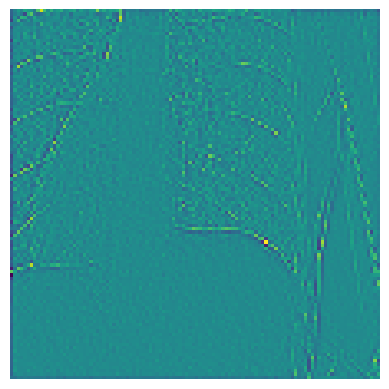

heres an image


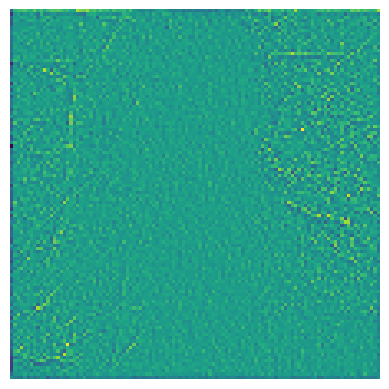

Epoch [1/5], Step [3/512], Loss: 0.6062, tp_sum: 3.0000, fp_sum: 53.0000, fn_sum: 0.0000, cumulative_f1_score: 0.1017
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


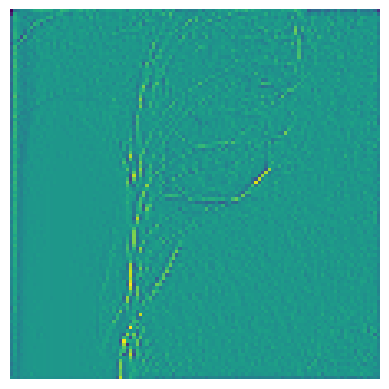

heres an image


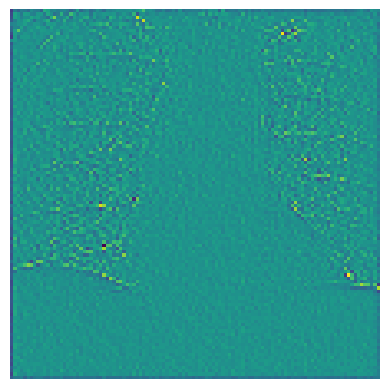

heres an image


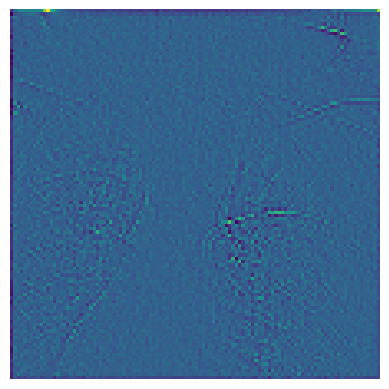

heres an image


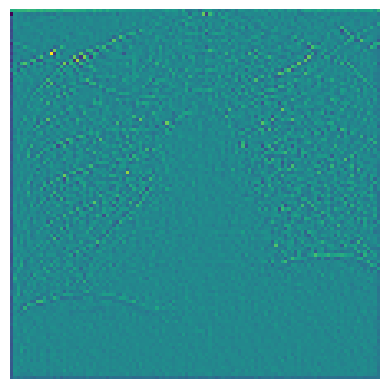

Epoch [1/5], Step [4/512], Loss: 0.5291, tp_sum: 2.0000, fp_sum: 53.0000, fn_sum: 0.0000, cumulative_f1_score: 0.0702
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


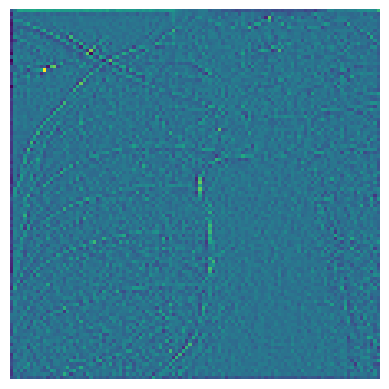

heres an image


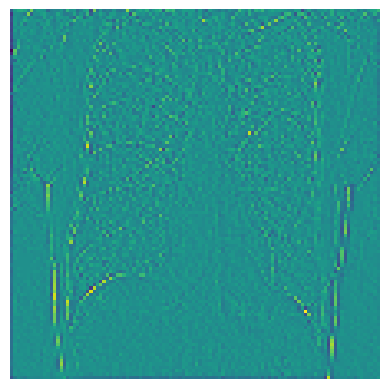

heres an image


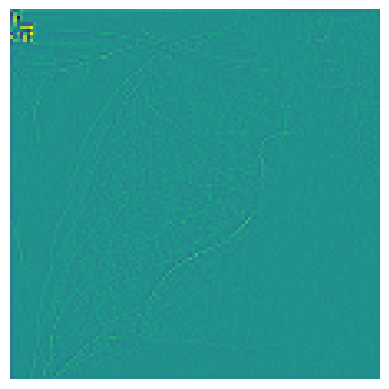

heres an image


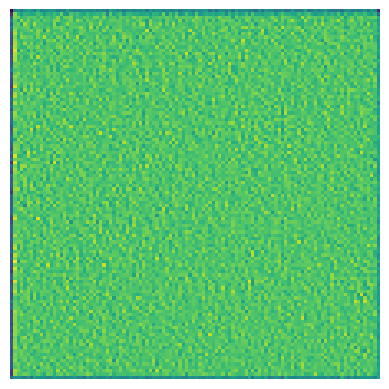

Epoch [1/5], Step [5/512], Loss: 0.4921, tp_sum: 2.0000, fp_sum: 51.0000, fn_sum: 0.0000, cumulative_f1_score: 0.0727
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


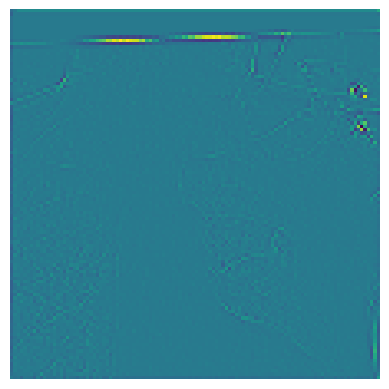

heres an image


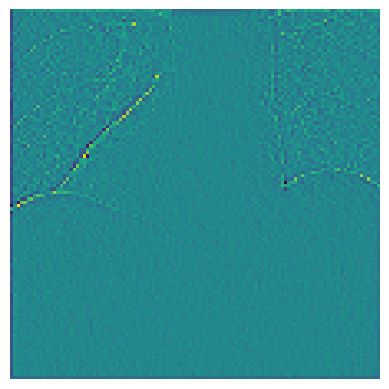

heres an image


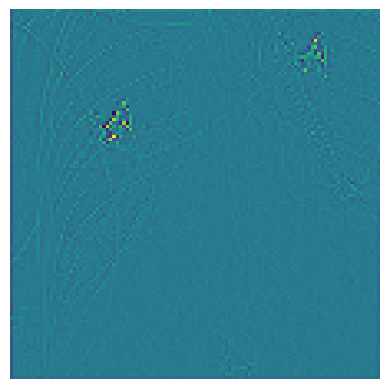

heres an image


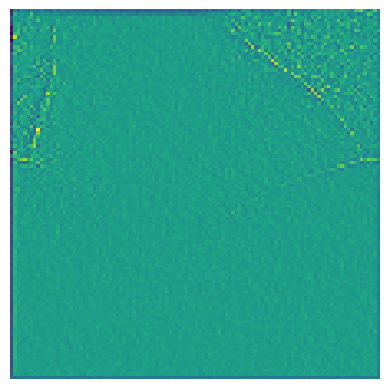

Epoch [1/5], Step [6/512], Loss: 0.4438, tp_sum: 4.0000, fp_sum: 46.0000, fn_sum: 0.0000, cumulative_f1_score: 0.1481
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


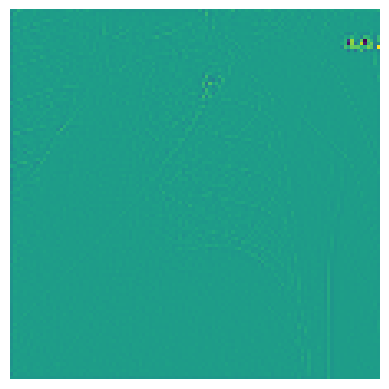

heres an image


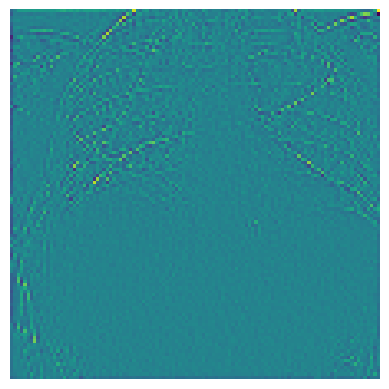

heres an image


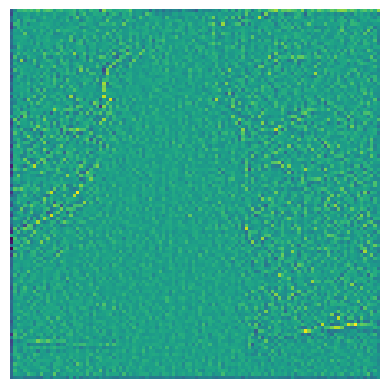

heres an image


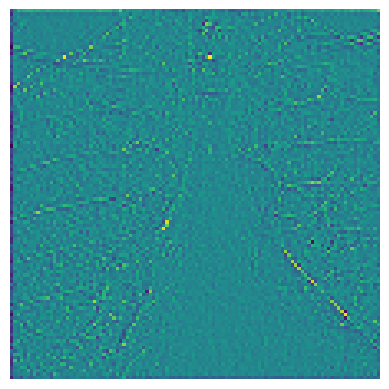

Epoch [1/5], Step [7/512], Loss: 0.4385, tp_sum: 5.0000, fp_sum: 41.0000, fn_sum: 0.0000, cumulative_f1_score: 0.1961
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


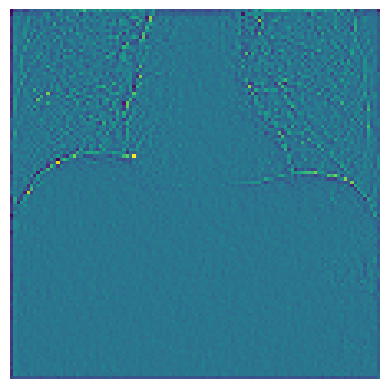

heres an image


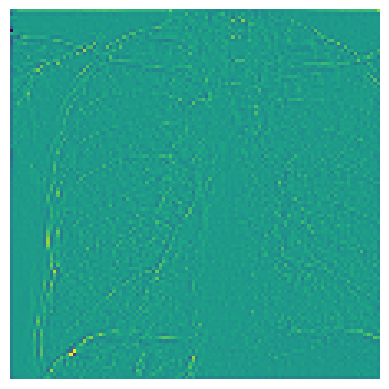

heres an image


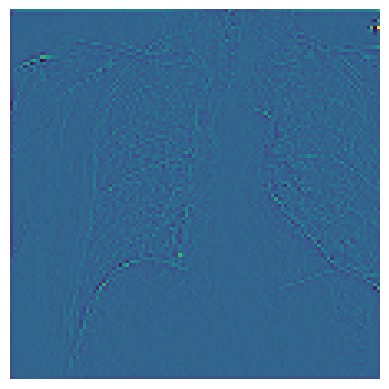

heres an image


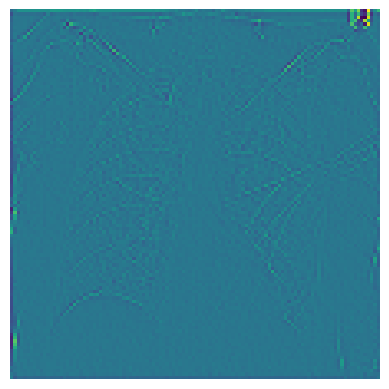

Epoch [1/5], Step [8/512], Loss: 0.3262, tp_sum: 1.0000, fp_sum: 26.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0690
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


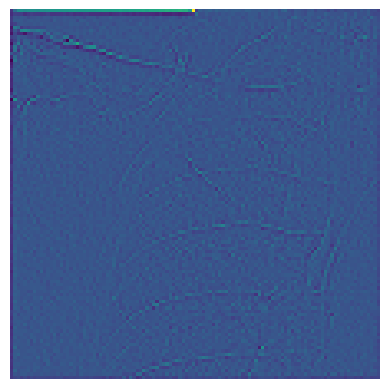

heres an image


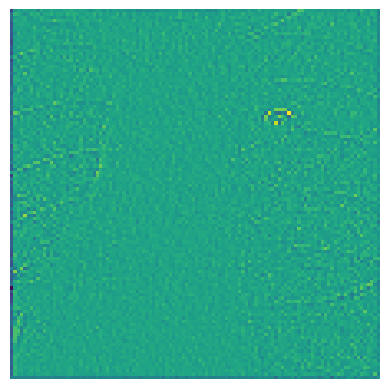

heres an image


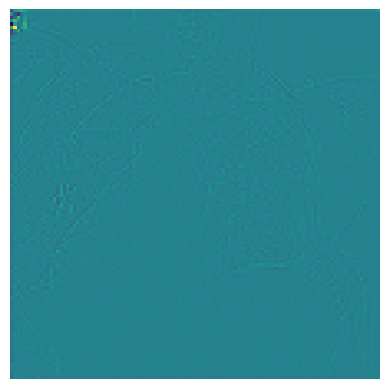

heres an image


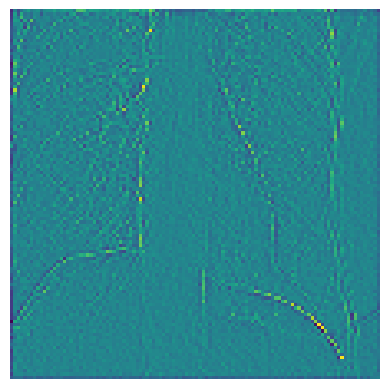

Epoch [1/5], Step [9/512], Loss: 0.3151, tp_sum: 1.0000, fp_sum: 14.0000, fn_sum: 2.0000, cumulative_f1_score: 0.1111
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


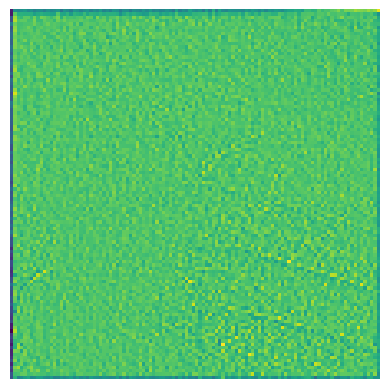

heres an image


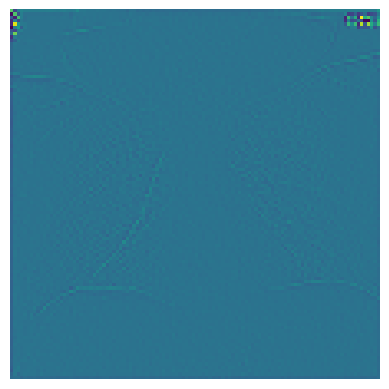

heres an image


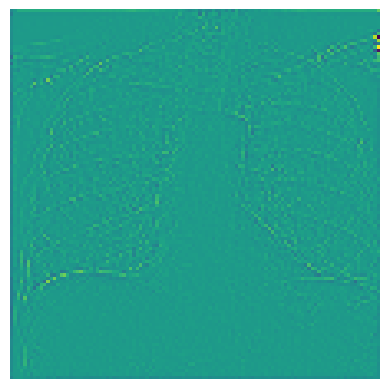

heres an image


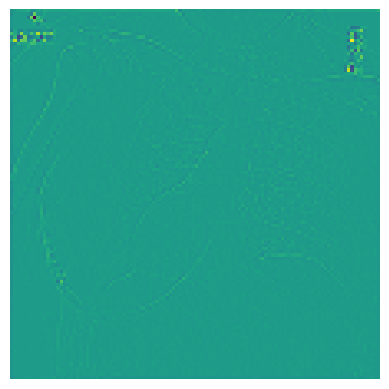

Epoch [1/5], Step [10/512], Loss: 0.2473, tp_sum: 1.0000, fp_sum: 16.0000, fn_sum: 0.0000, cumulative_f1_score: 0.1111
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


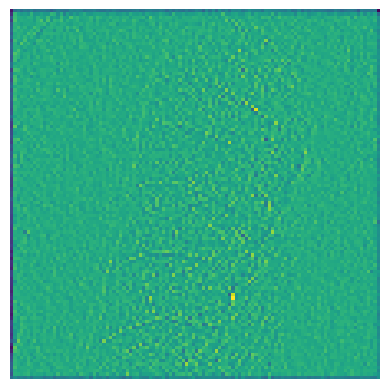

heres an image


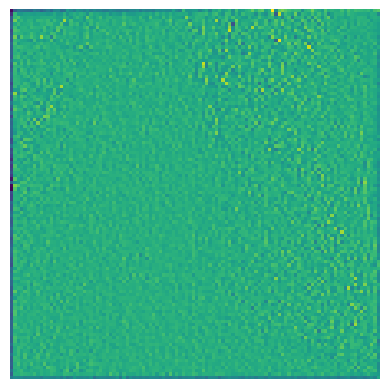

heres an image


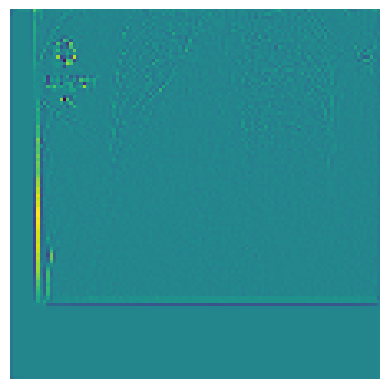

heres an image


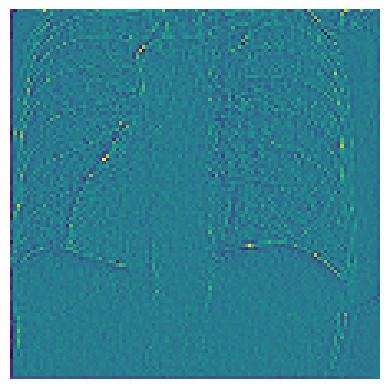

Epoch [1/5], Step [11/512], Loss: 0.3450, tp_sum: 3.0000, fp_sum: 6.0000, fn_sum: 3.0000, cumulative_f1_score: 0.4000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


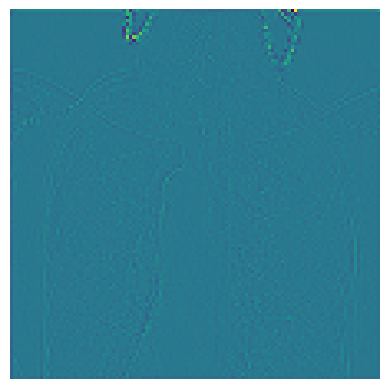

heres an image


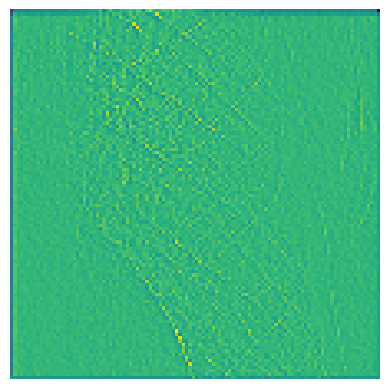

heres an image


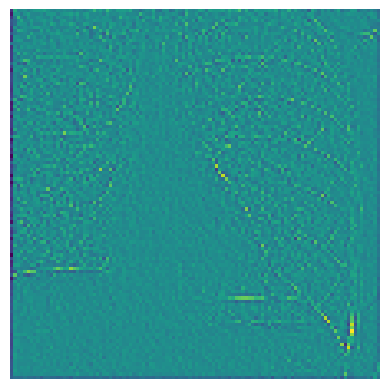

heres an image


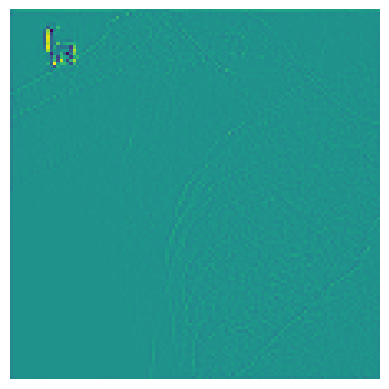

Epoch [1/5], Step [12/512], Loss: 0.2935, tp_sum: 1.0000, fp_sum: 12.0000, fn_sum: 2.0000, cumulative_f1_score: 0.1250
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


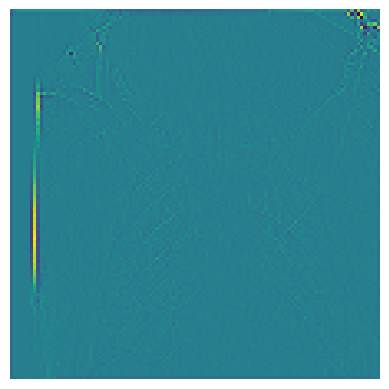

heres an image


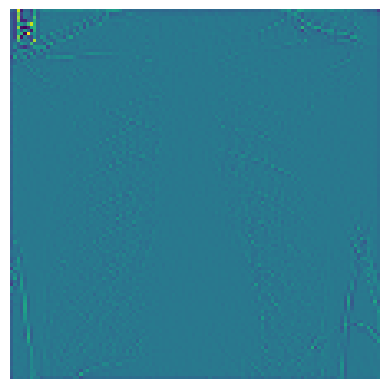

heres an image


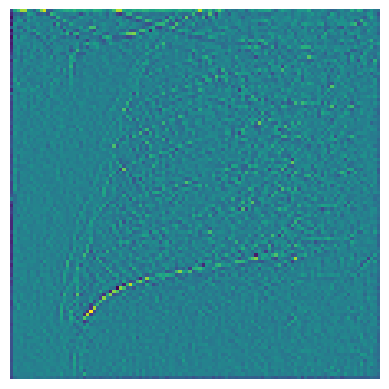

heres an image


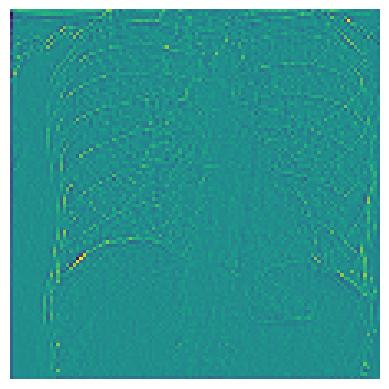

Epoch [1/5], Step [13/512], Loss: 0.1788, tp_sum: 0.0000, fp_sum: 1.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


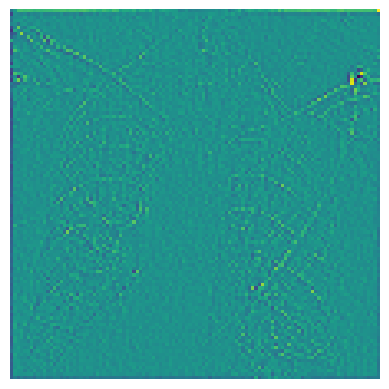

heres an image


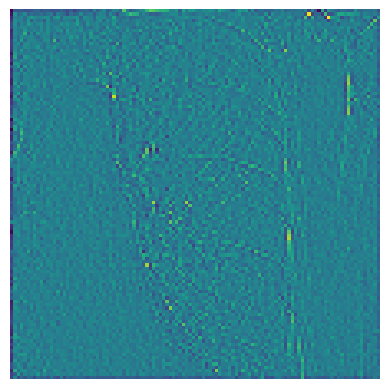

heres an image


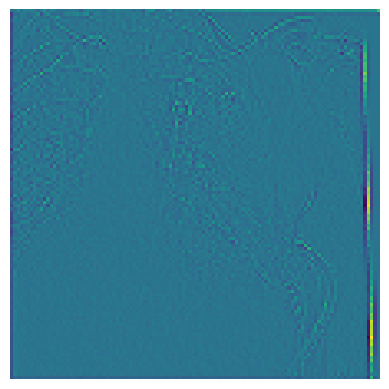

heres an image


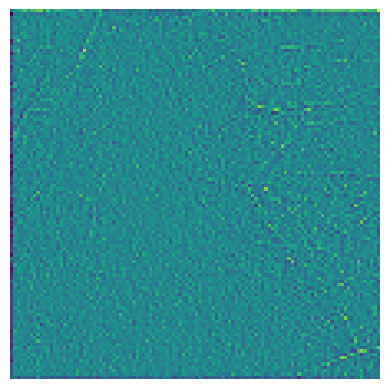

Epoch [1/5], Step [14/512], Loss: 0.4943, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 10.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


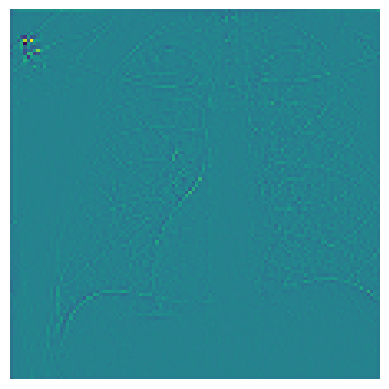

heres an image


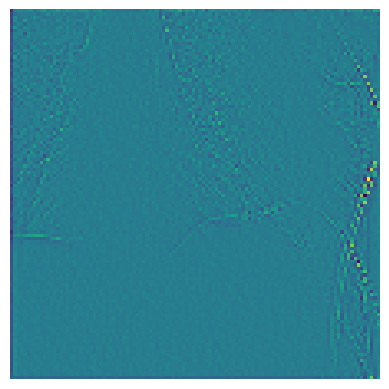

heres an image


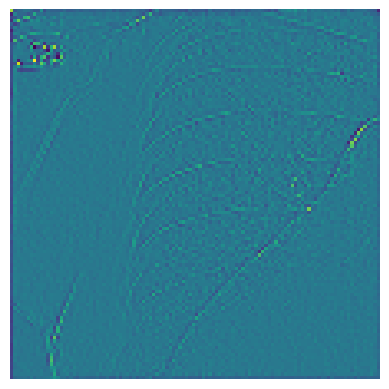

heres an image


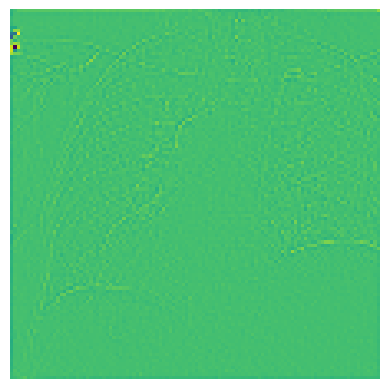

Epoch [1/5], Step [15/512], Loss: 0.0820, tp_sum: 0.0000, fp_sum: 1.0000, fn_sum: 0.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


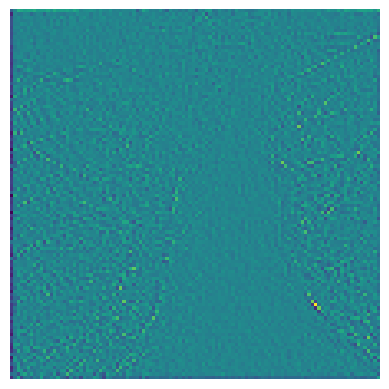

heres an image


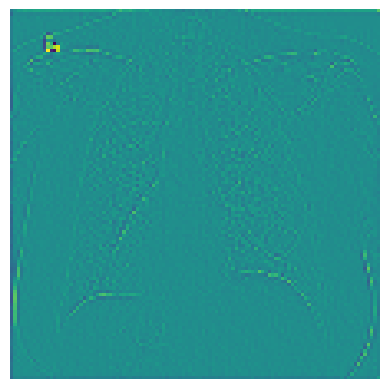

heres an image


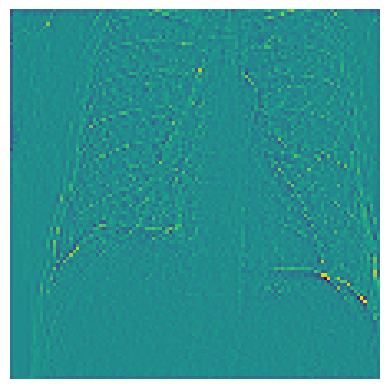

heres an image


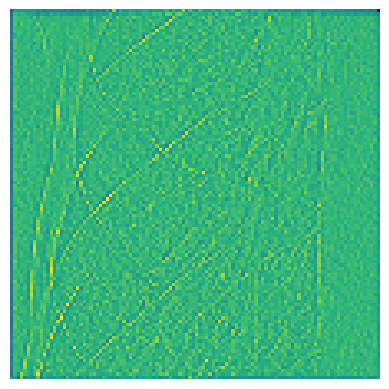

Epoch [1/5], Step [16/512], Loss: 0.0855, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 0.0000, cumulative_f1_score: nan
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


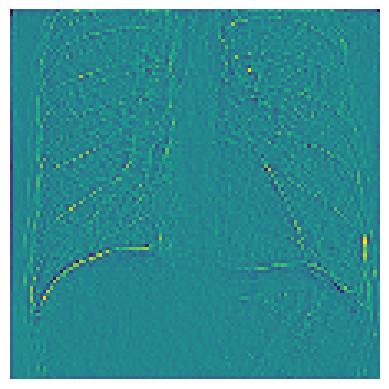

heres an image


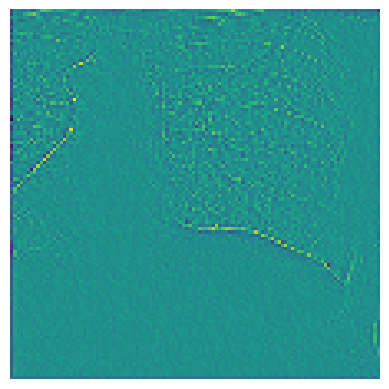

heres an image


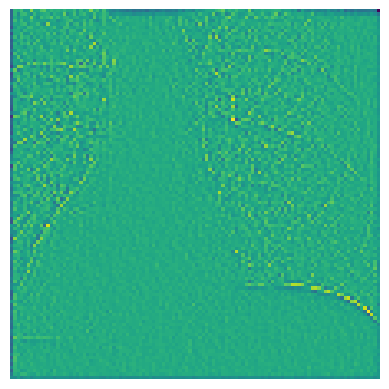

heres an image


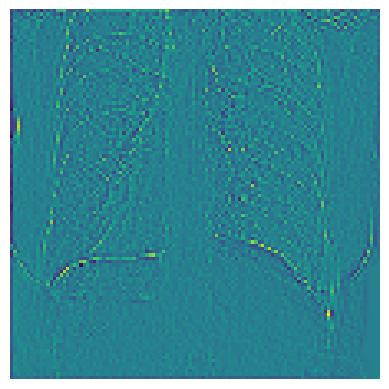

Epoch [1/5], Step [17/512], Loss: 0.1613, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


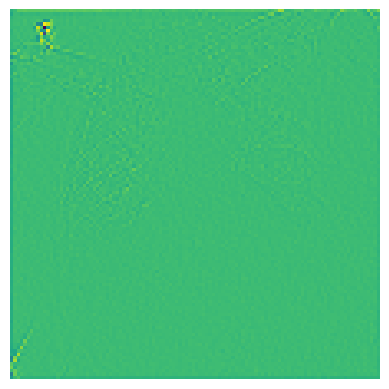

heres an image


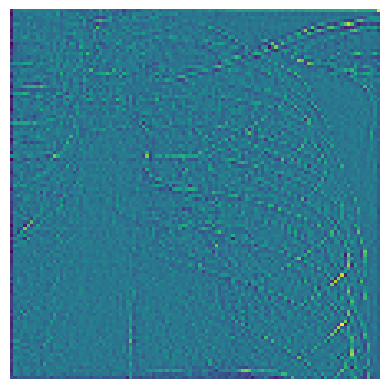

heres an image


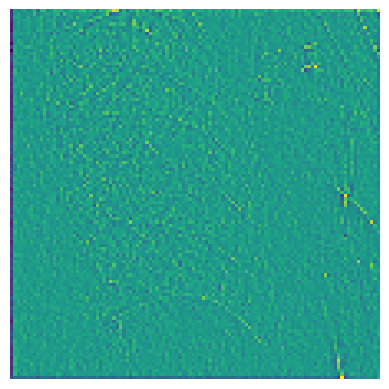

heres an image


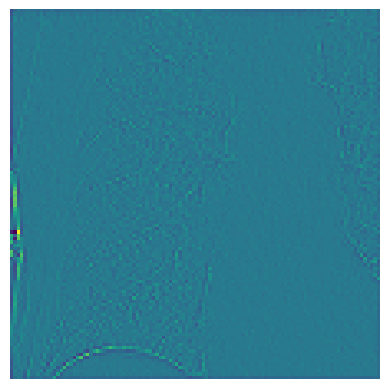

Epoch [1/5], Step [18/512], Loss: 0.2132, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 3.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


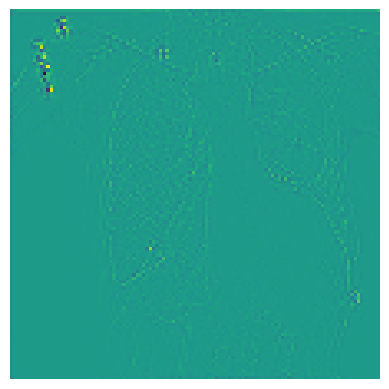

heres an image


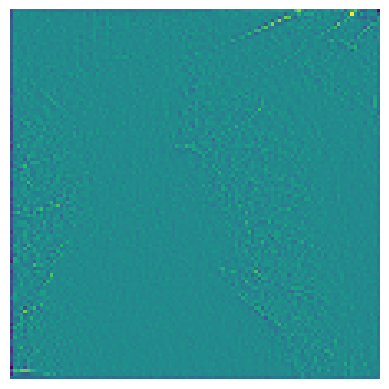

heres an image


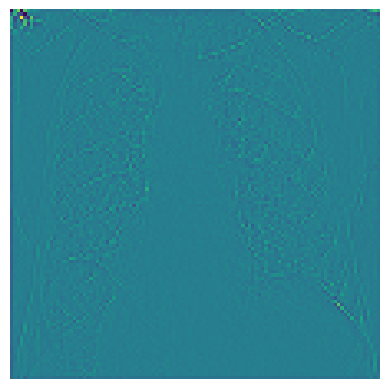

heres an image


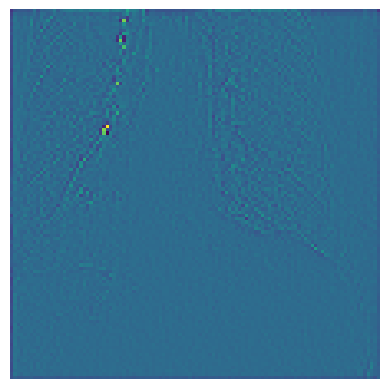

Epoch [1/5], Step [19/512], Loss: 0.1031, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


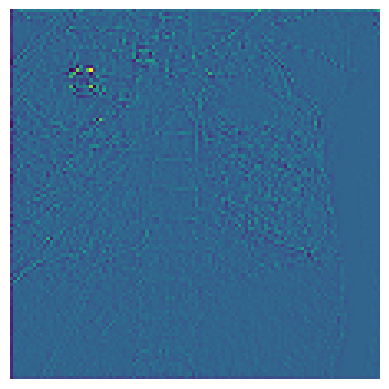

heres an image


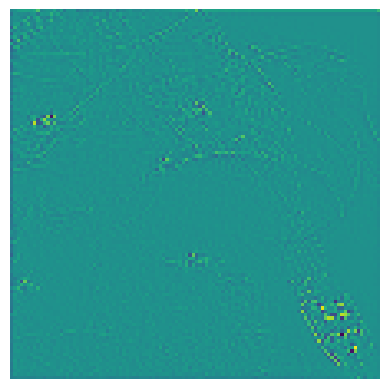

heres an image


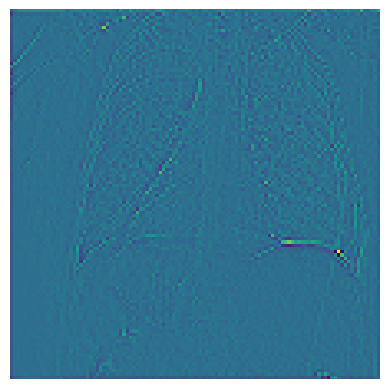

heres an image


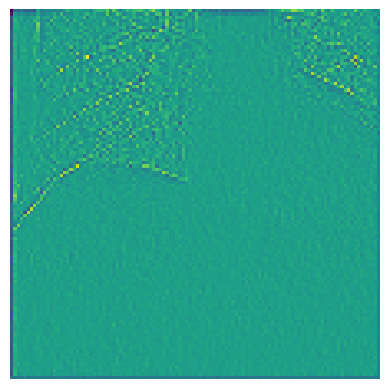

Epoch [1/5], Step [20/512], Loss: 0.1757, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 3.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


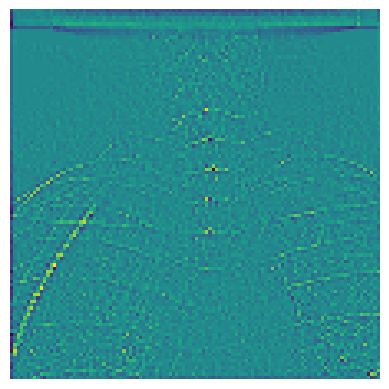

heres an image


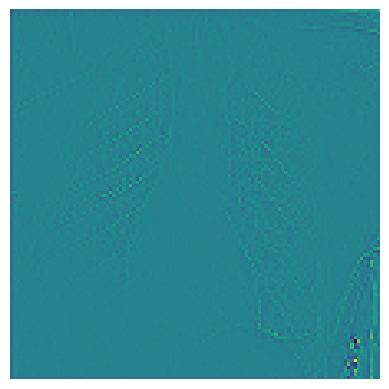

heres an image


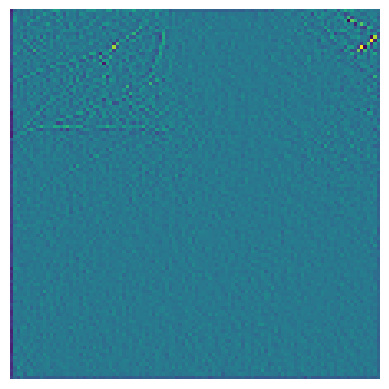

heres an image


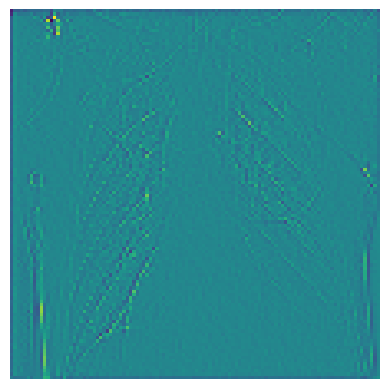

Epoch [1/5], Step [21/512], Loss: 0.1867, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


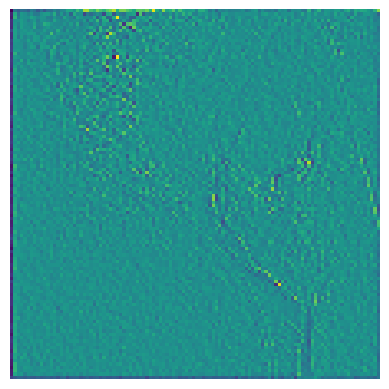

heres an image


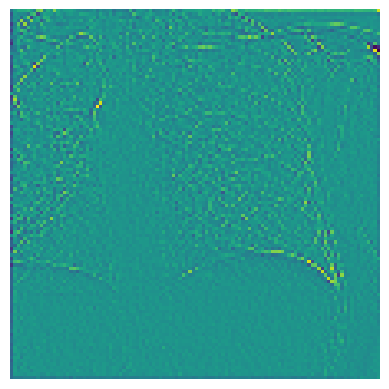

heres an image


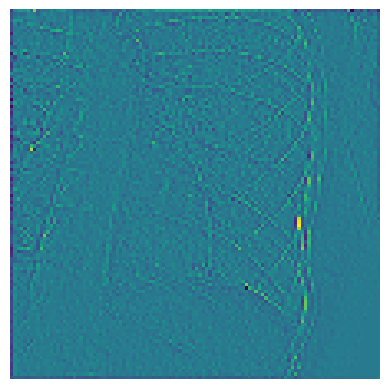

heres an image


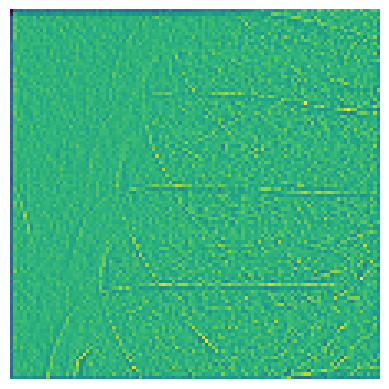

Epoch [1/5], Step [22/512], Loss: 0.0899, tp_sum: 0.0000, fp_sum: 1.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


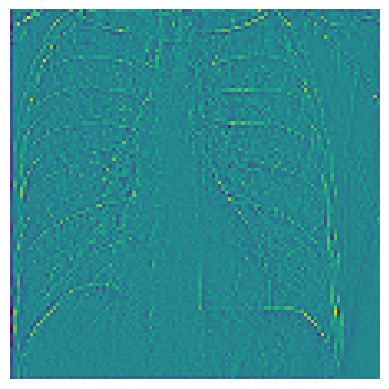

heres an image


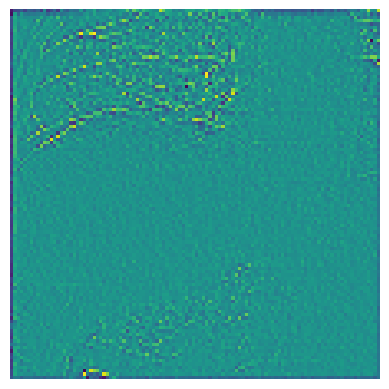

heres an image


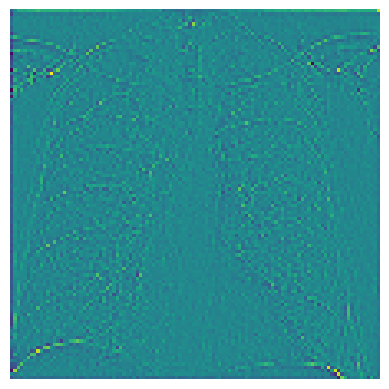

heres an image


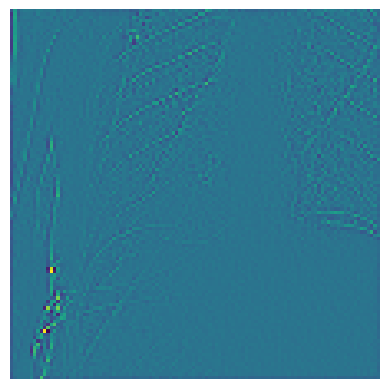

Epoch [1/5], Step [23/512], Loss: 0.1707, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 3.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


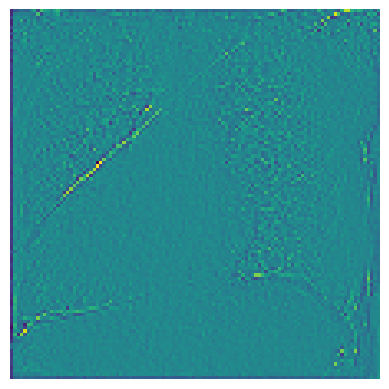

heres an image


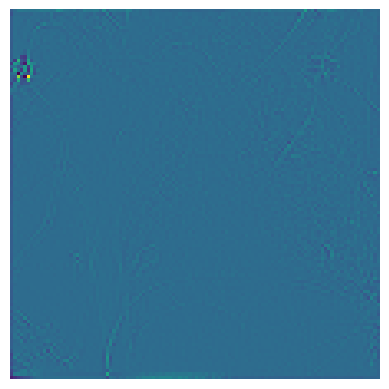

heres an image


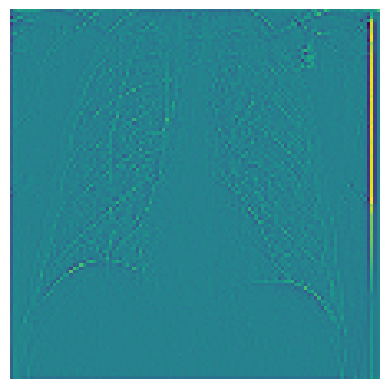

heres an image


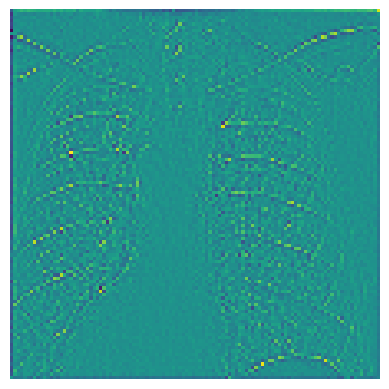

Epoch [1/5], Step [24/512], Loss: 0.2023, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 3.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


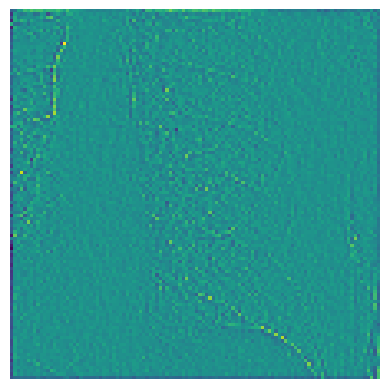

heres an image


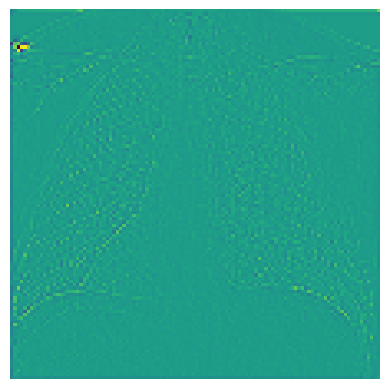

heres an image


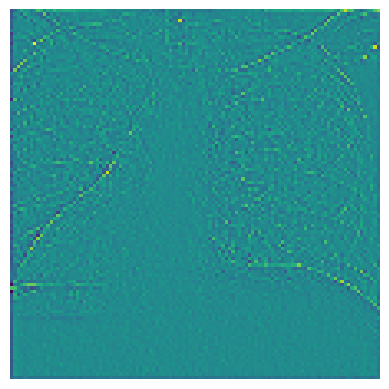

heres an image


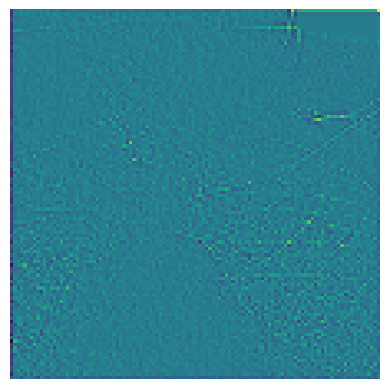

Epoch [1/5], Step [25/512], Loss: 0.0382, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 0.0000, cumulative_f1_score: nan
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


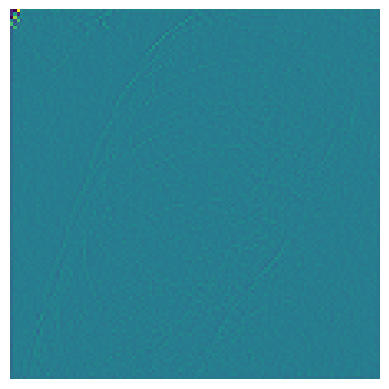

heres an image


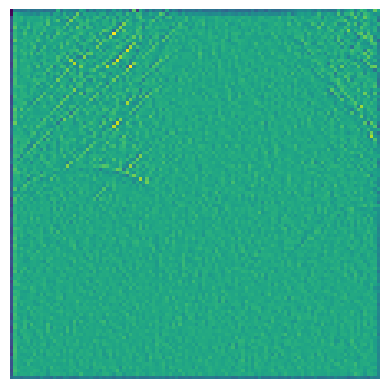

heres an image


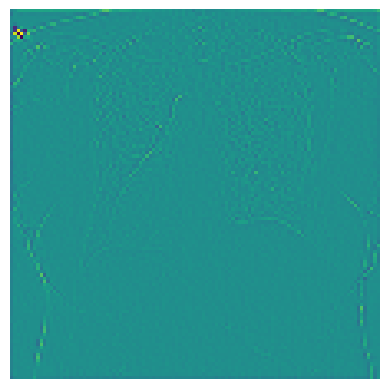

heres an image


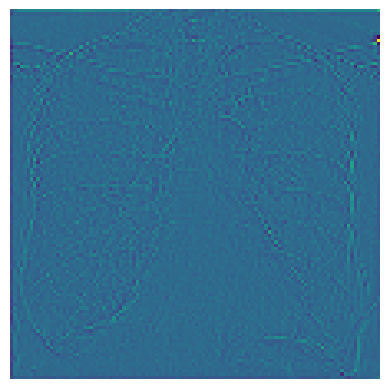

Epoch [1/5], Step [26/512], Loss: 0.3399, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 5.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


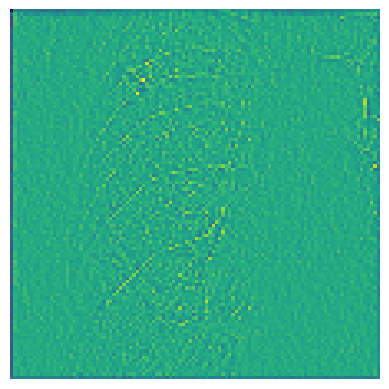

heres an image


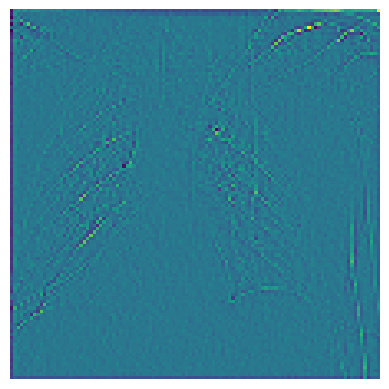

heres an image


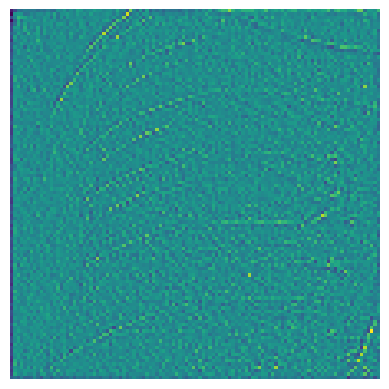

heres an image


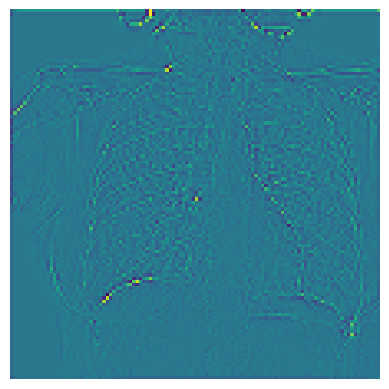

Epoch [1/5], Step [27/512], Loss: 0.0894, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


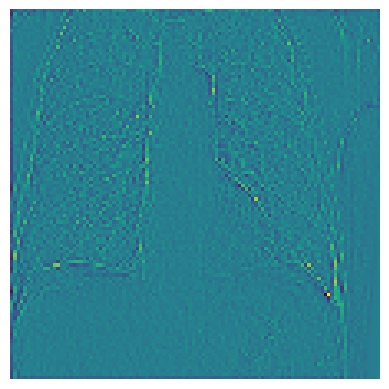

heres an image


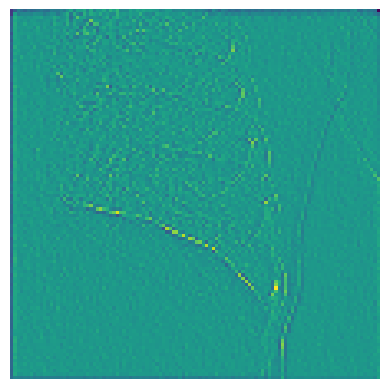

heres an image


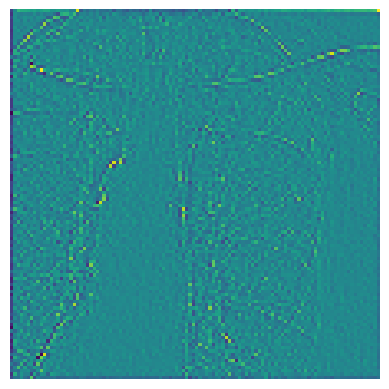

heres an image


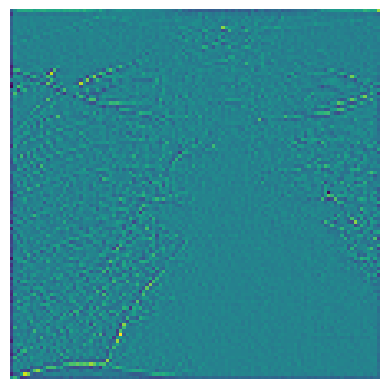

Epoch [1/5], Step [28/512], Loss: 0.1191, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


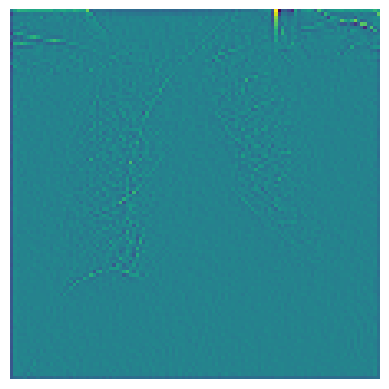

heres an image


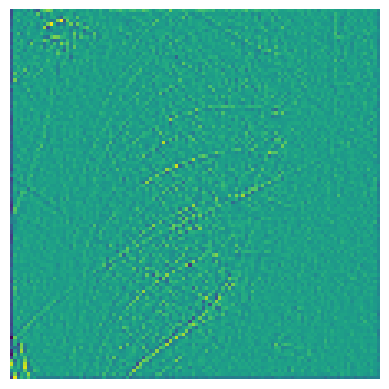

heres an image


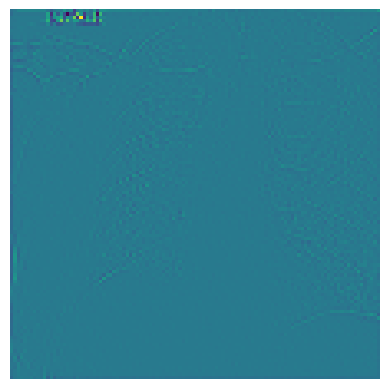

heres an image


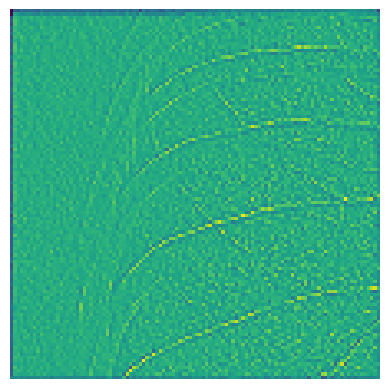

Epoch [1/5], Step [29/512], Loss: 0.2108, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 4.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


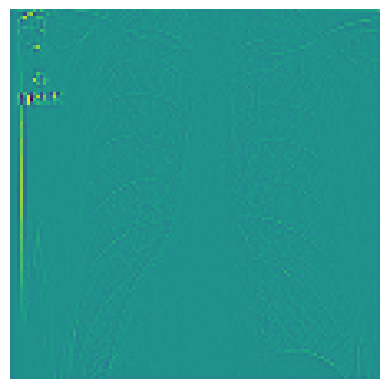

heres an image


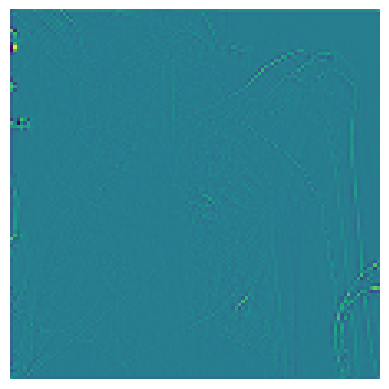

heres an image


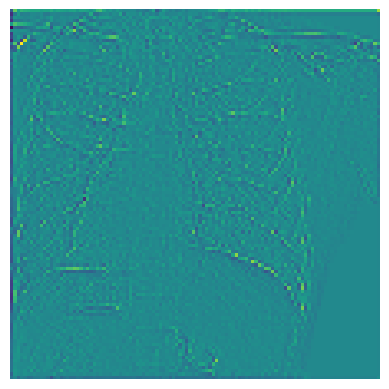

heres an image


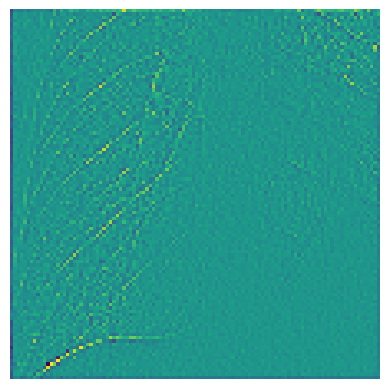

Epoch [1/5], Step [30/512], Loss: 0.1561, tp_sum: 0.0000, fp_sum: 1.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


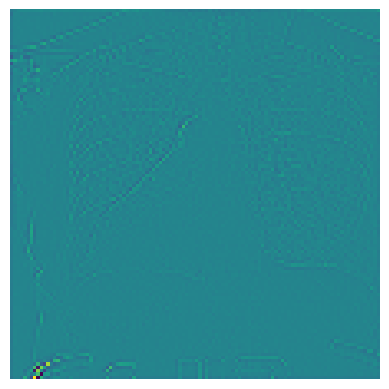

heres an image


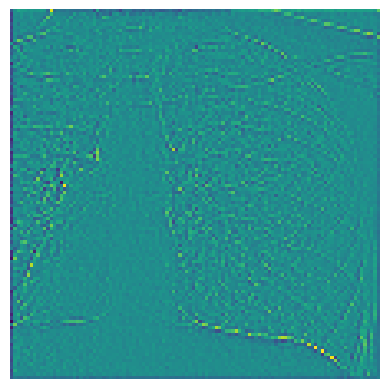

heres an image


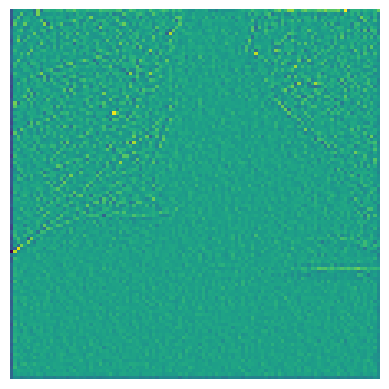

heres an image


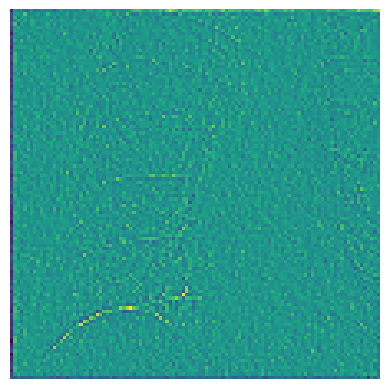

Epoch [1/5], Step [31/512], Loss: 0.1228, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


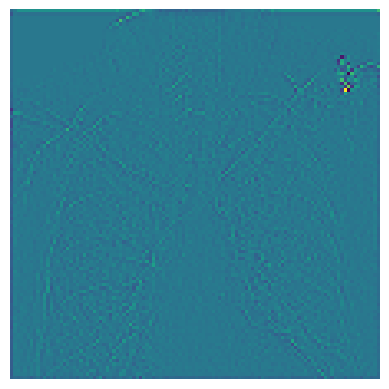

heres an image


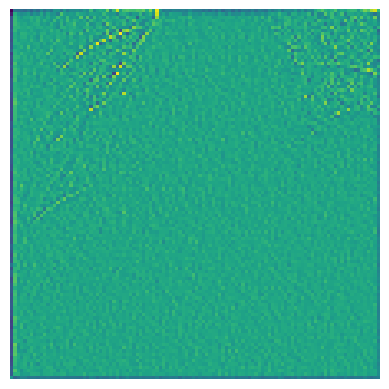

heres an image


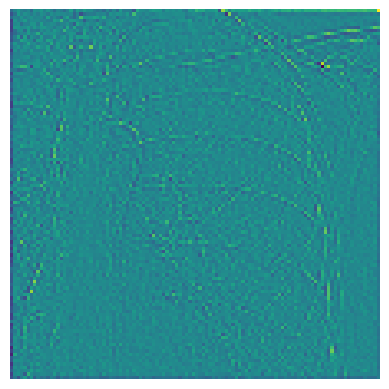

heres an image


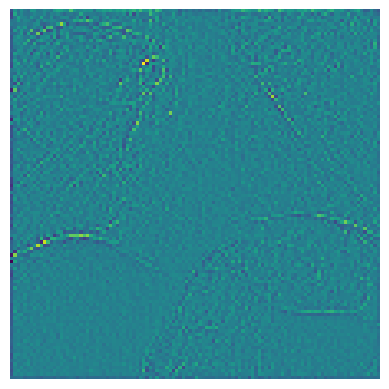

Epoch [1/5], Step [32/512], Loss: 0.1974, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 3.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


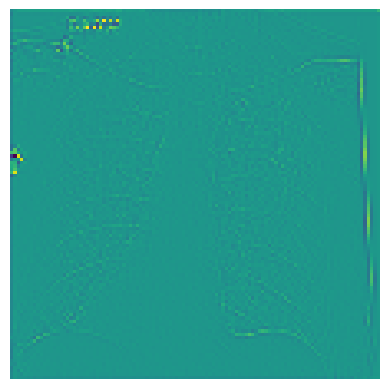

heres an image


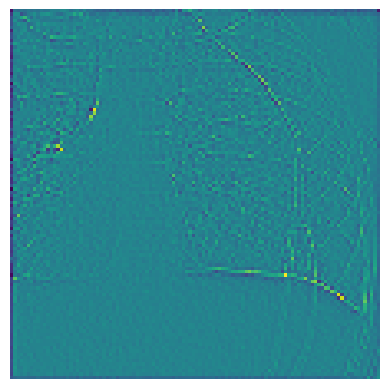

heres an image


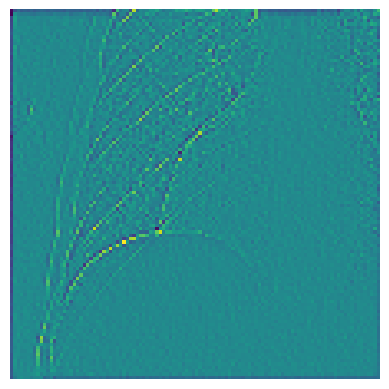

heres an image


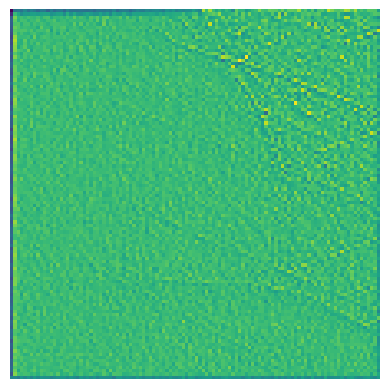

Epoch [1/5], Step [33/512], Loss: 0.1142, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


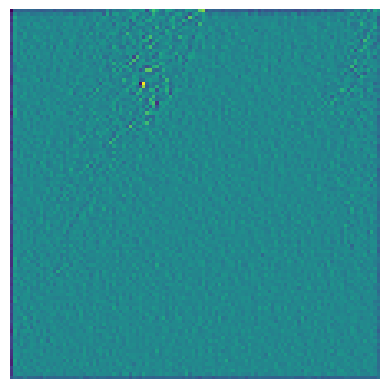

heres an image


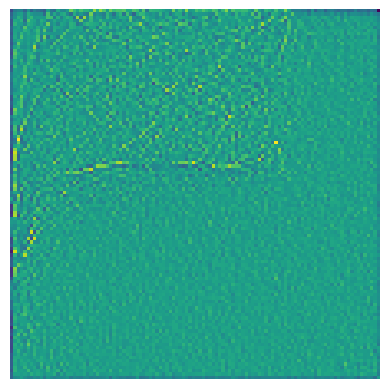

heres an image


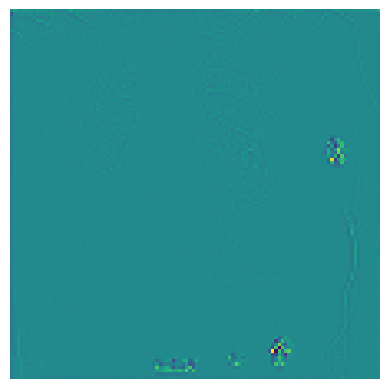

heres an image


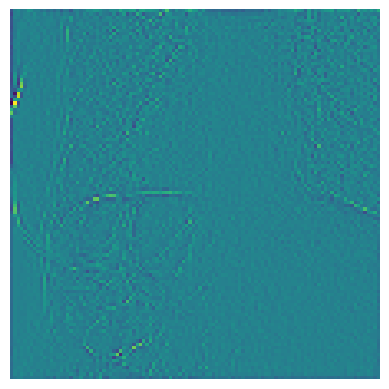

Epoch [1/5], Step [34/512], Loss: 0.1439, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


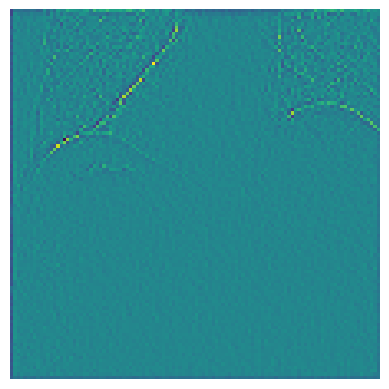

heres an image


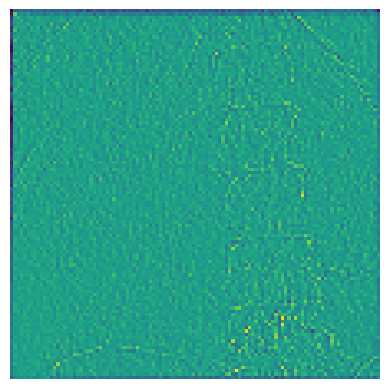

heres an image


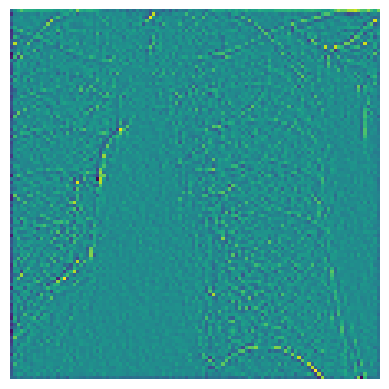

heres an image


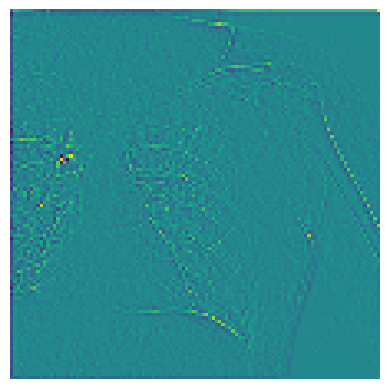

Epoch [1/5], Step [35/512], Loss: 0.1840, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


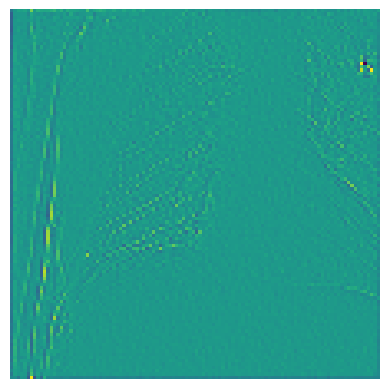

heres an image


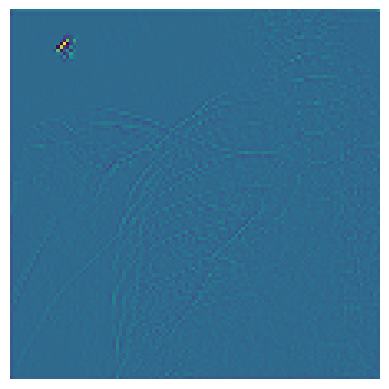

heres an image


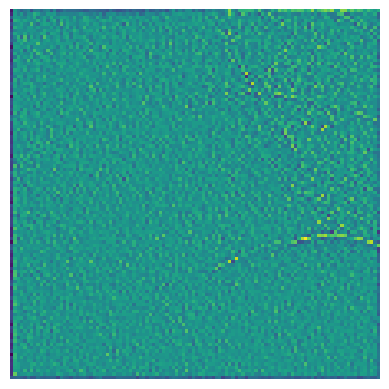

heres an image


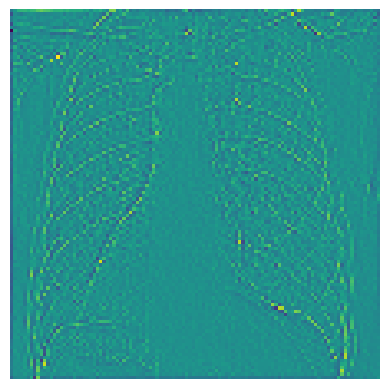

Epoch [1/5], Step [36/512], Loss: 0.3286, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 6.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


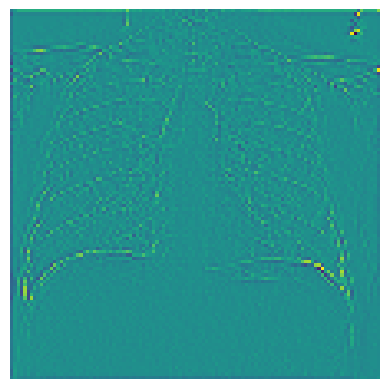

heres an image


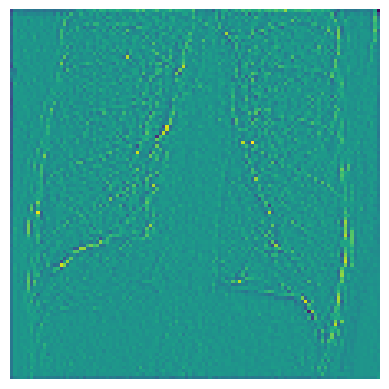

heres an image


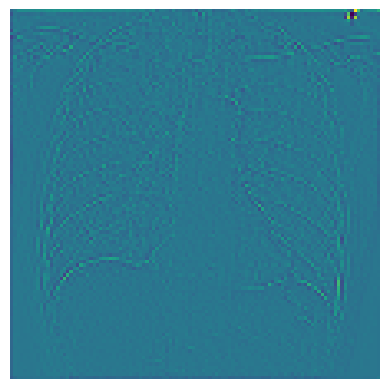

heres an image


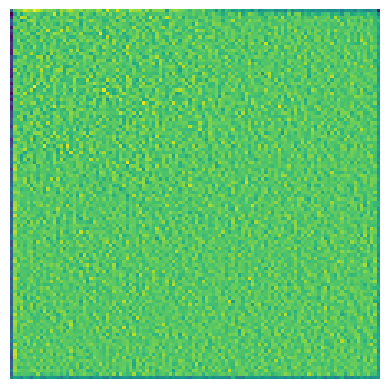

Epoch [1/5], Step [37/512], Loss: 0.0912, tp_sum: 0.0000, fp_sum: 1.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


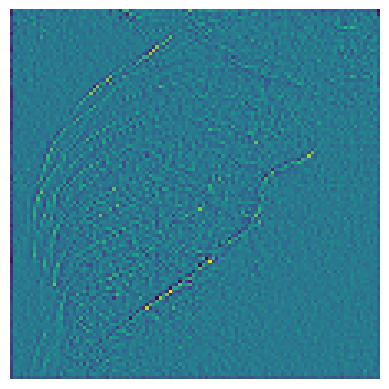

heres an image


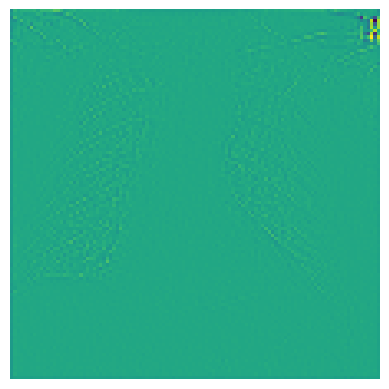

heres an image


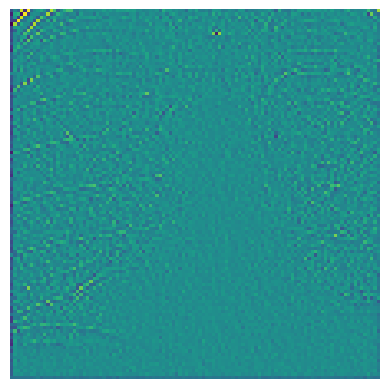

heres an image


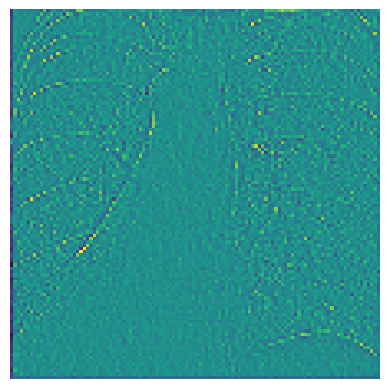

Epoch [1/5], Step [38/512], Loss: 0.3475, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 5.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


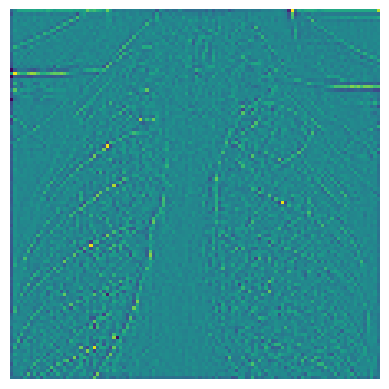

heres an image


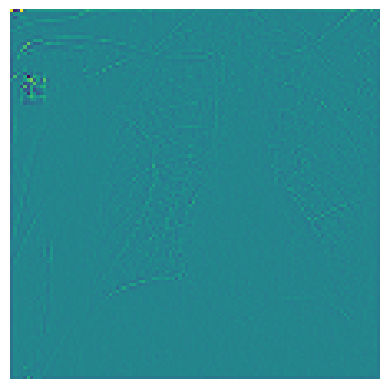

heres an image


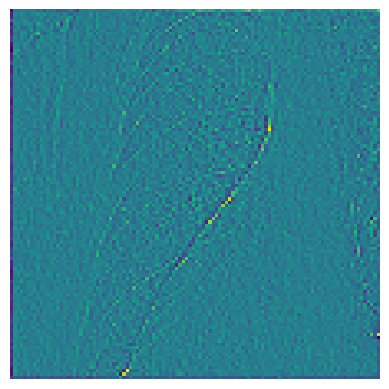

heres an image


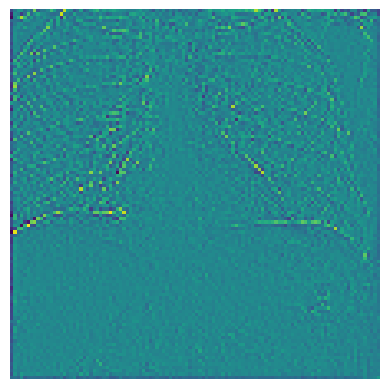

Epoch [1/5], Step [39/512], Loss: 0.0615, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


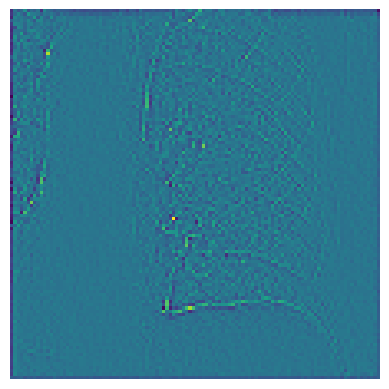

heres an image


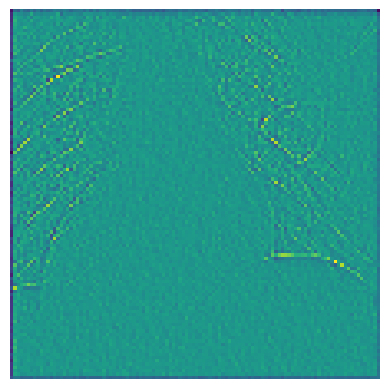

heres an image


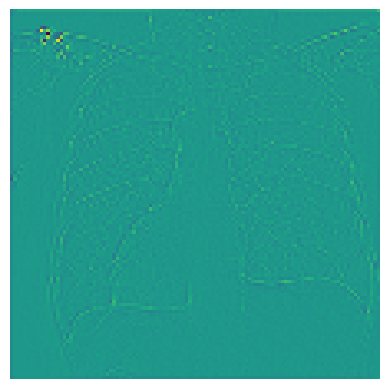

heres an image


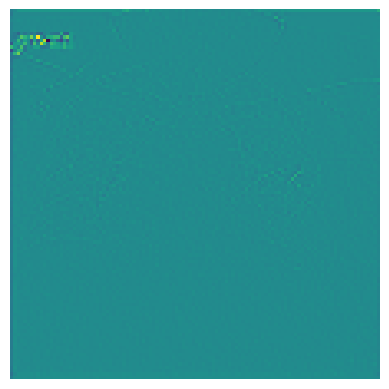

Epoch [1/5], Step [40/512], Loss: 0.1090, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


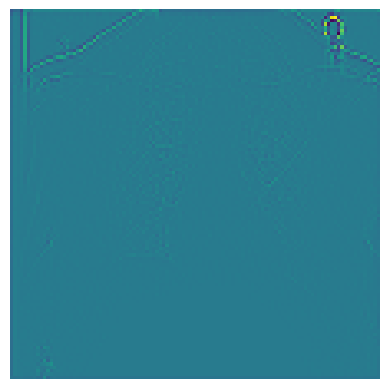

heres an image


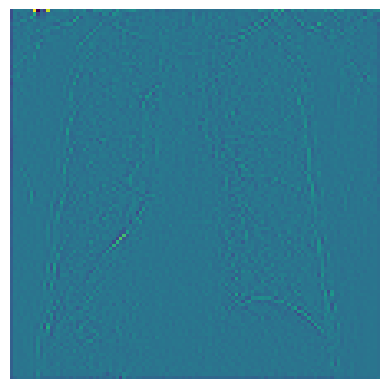

heres an image


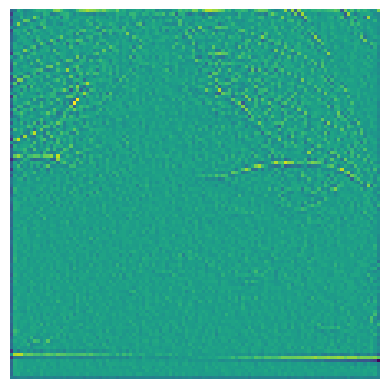

heres an image


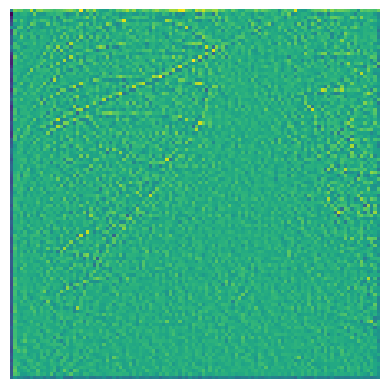

Epoch [1/5], Step [41/512], Loss: 0.0392, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 0.0000, cumulative_f1_score: nan
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


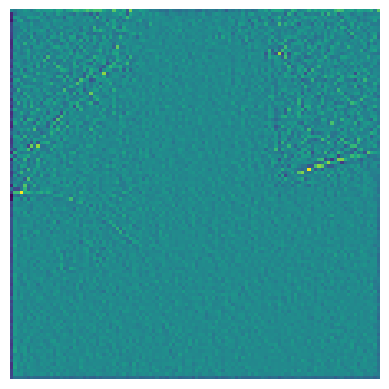

heres an image


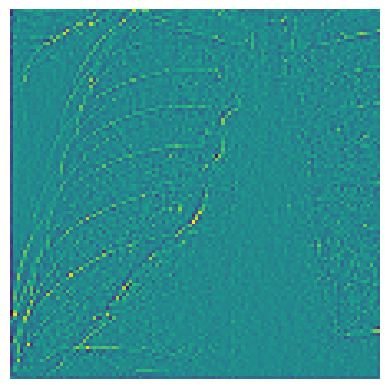

heres an image


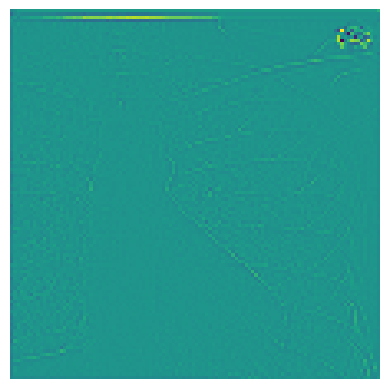

heres an image


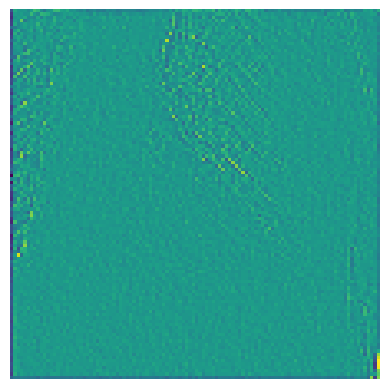

Epoch [1/5], Step [42/512], Loss: 0.1530, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


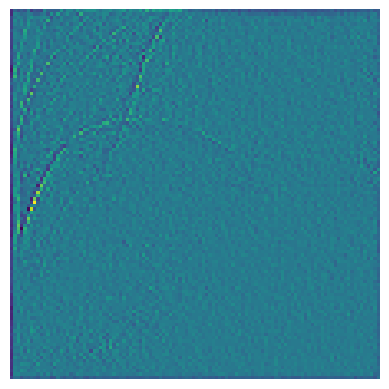

heres an image


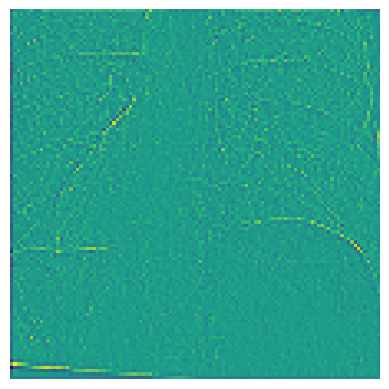

heres an image


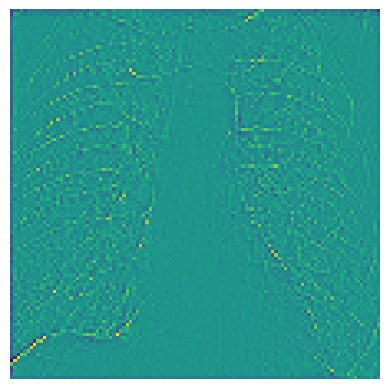

heres an image


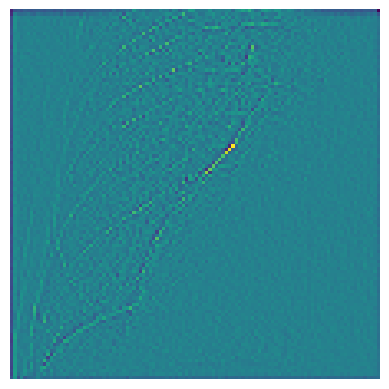

Epoch [1/5], Step [43/512], Loss: 0.1108, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


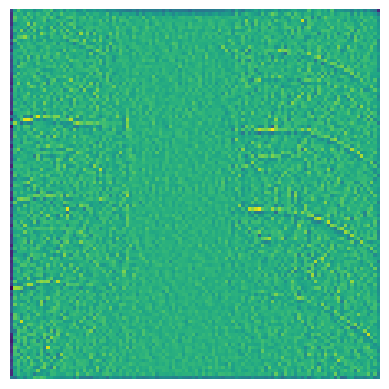

heres an image


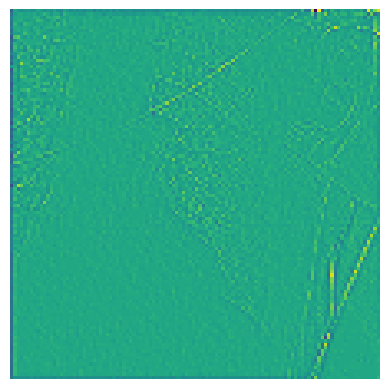

heres an image


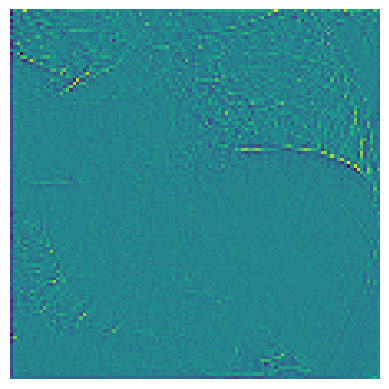

heres an image


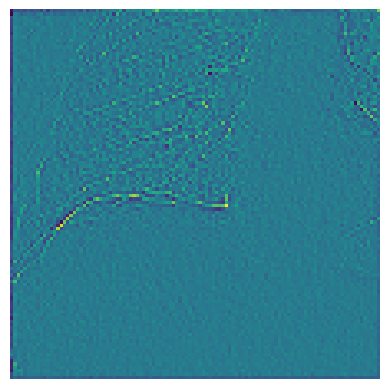

Epoch [1/5], Step [44/512], Loss: 0.1513, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


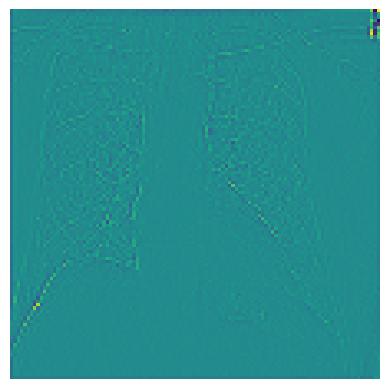

heres an image


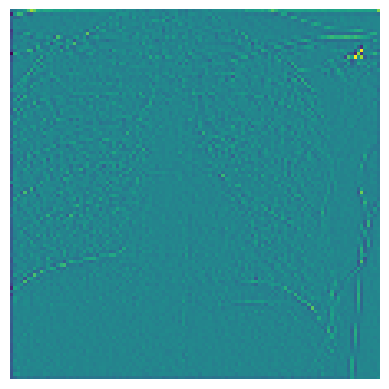

heres an image


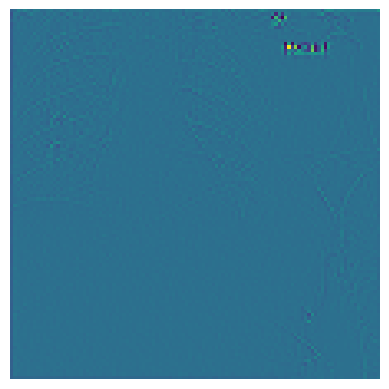

heres an image


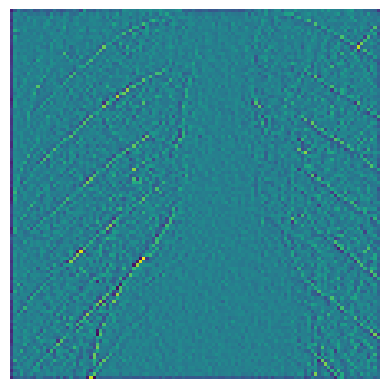

Epoch [1/5], Step [45/512], Loss: 0.0330, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 0.0000, cumulative_f1_score: nan
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


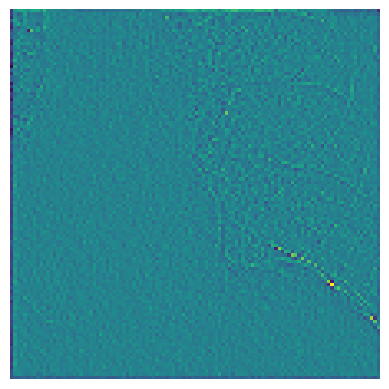

heres an image


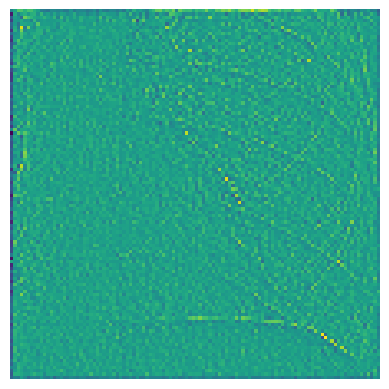

heres an image


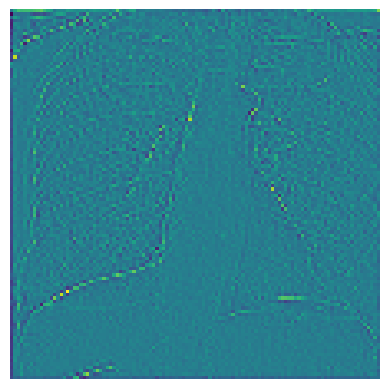

heres an image


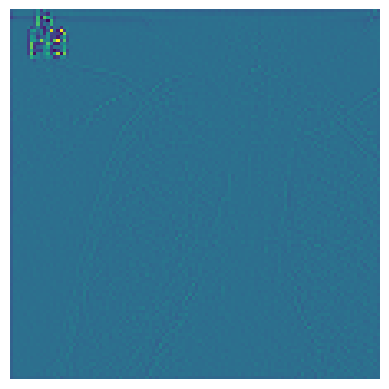

Epoch [1/5], Step [46/512], Loss: 0.1234, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


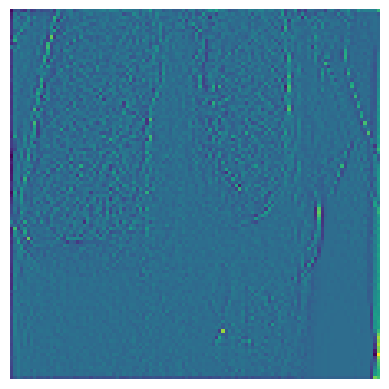

heres an image


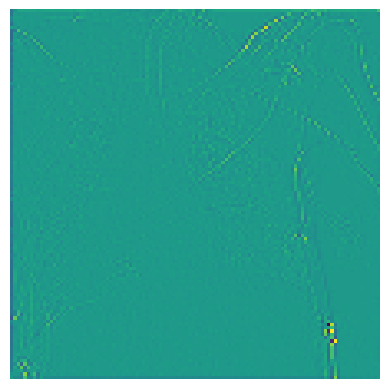

heres an image


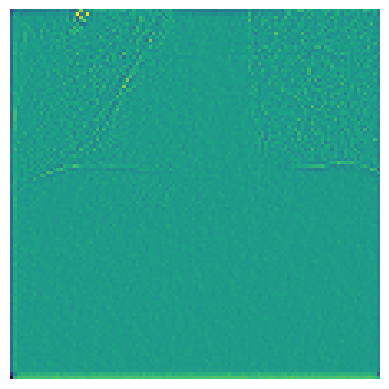

heres an image


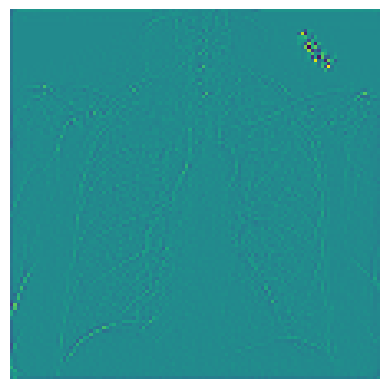

Epoch [1/5], Step [47/512], Loss: 0.2434, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 3.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


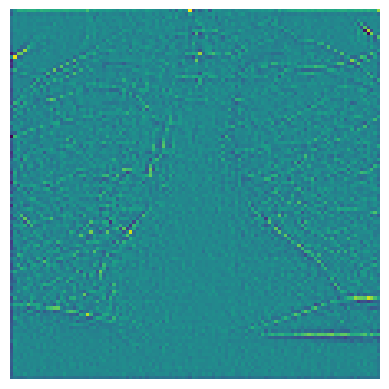

heres an image


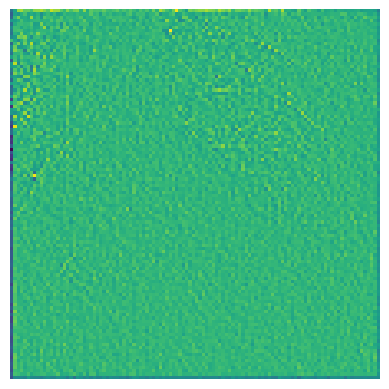

heres an image


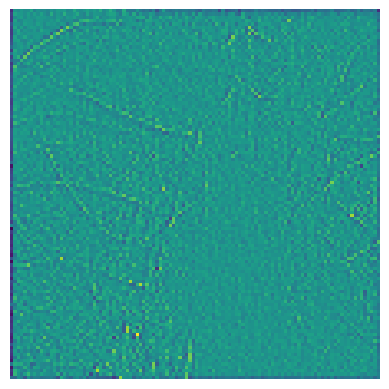

heres an image


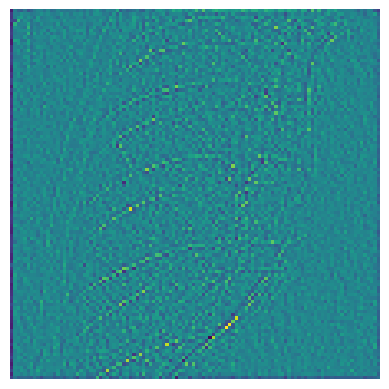

Epoch [1/5], Step [48/512], Loss: 0.1814, tp_sum: 0.0000, fp_sum: 1.0000, fn_sum: 3.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


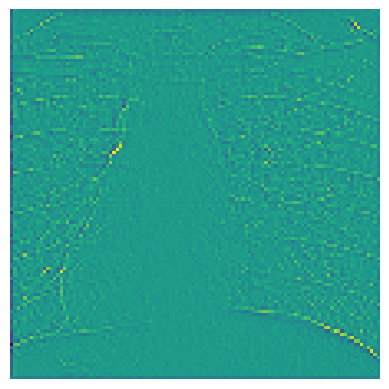

heres an image


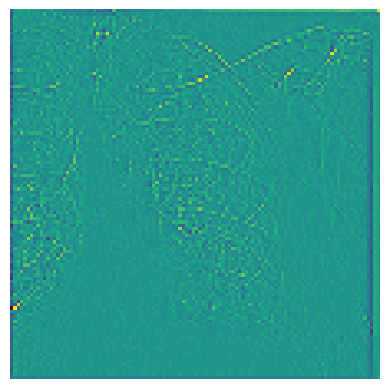

heres an image


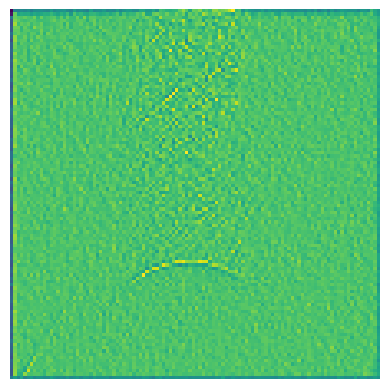

heres an image


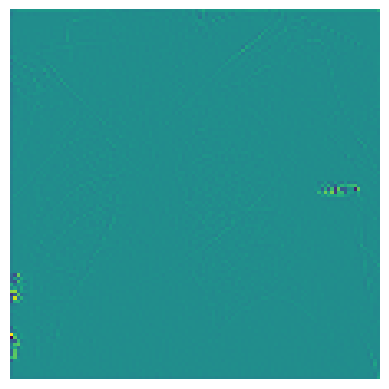

Epoch [1/5], Step [49/512], Loss: 0.4641, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 8.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


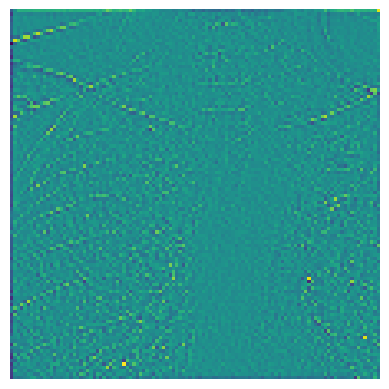

heres an image


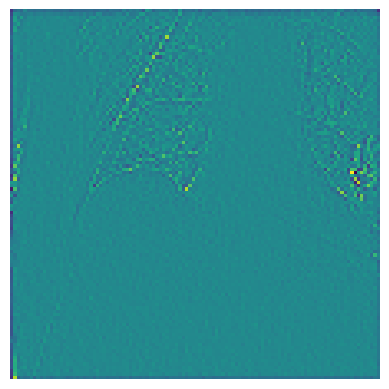

heres an image


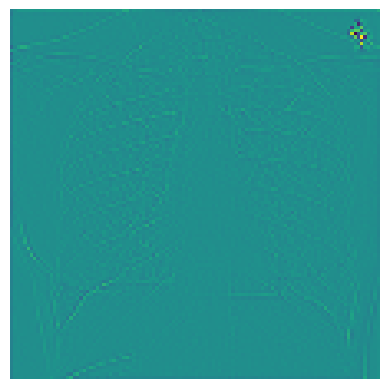

heres an image


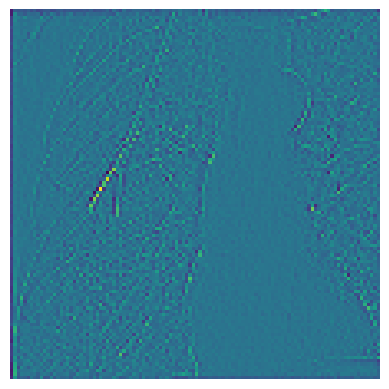

Epoch [1/5], Step [50/512], Loss: 0.0830, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


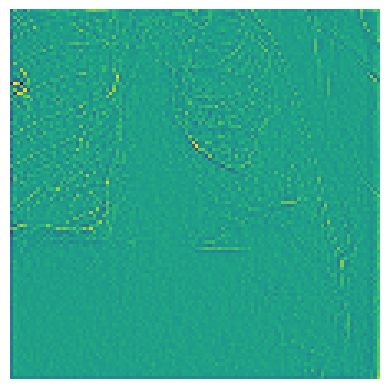

heres an image


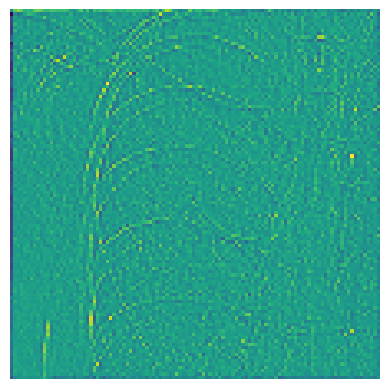

heres an image


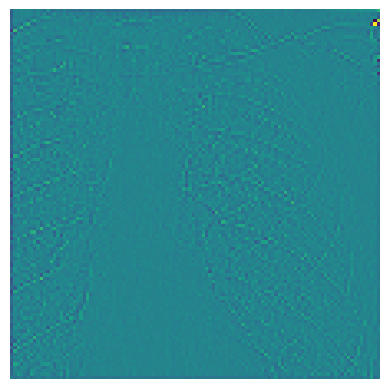

heres an image


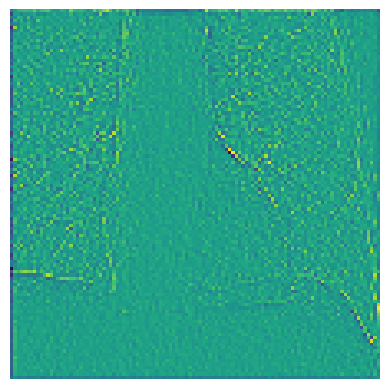

Epoch [1/5], Step [51/512], Loss: 0.1901, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


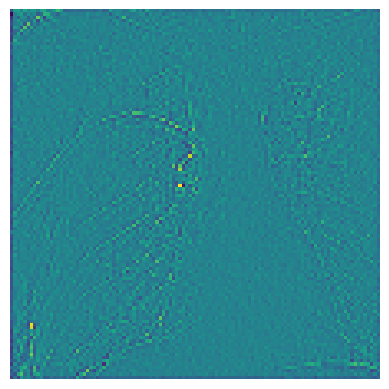

heres an image


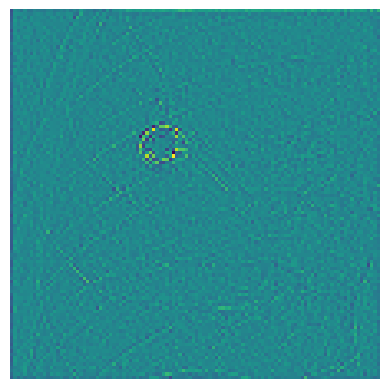

heres an image


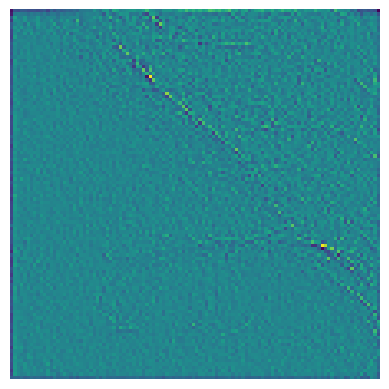

heres an image


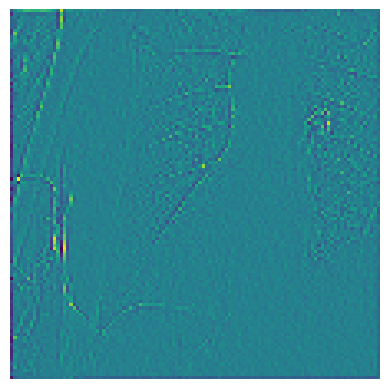

Epoch [1/5], Step [52/512], Loss: 0.1377, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


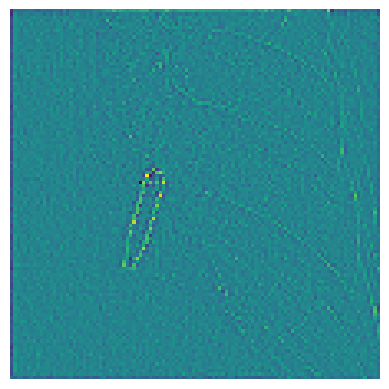

heres an image


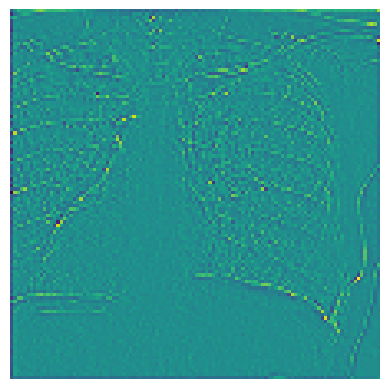

heres an image


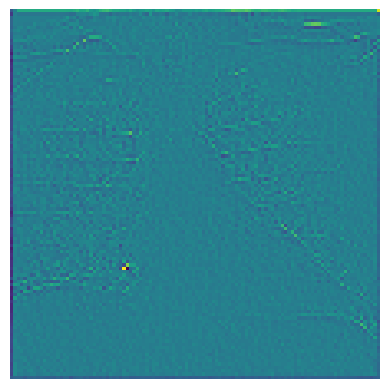

heres an image


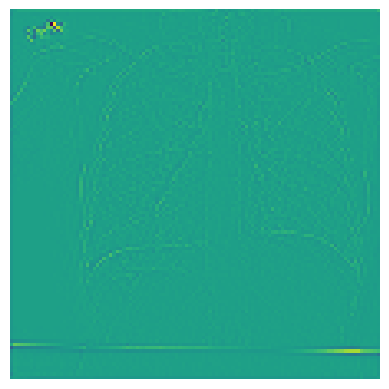

Epoch [1/5], Step [53/512], Loss: 0.1100, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


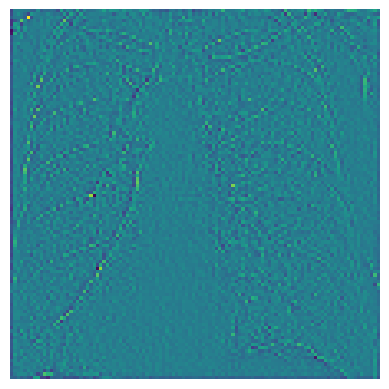

heres an image


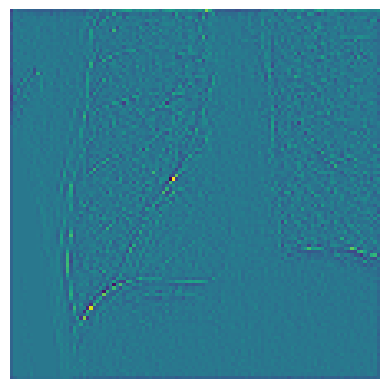

heres an image


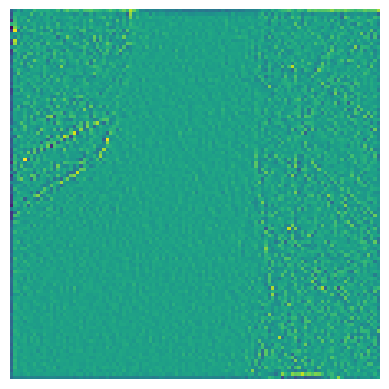

heres an image


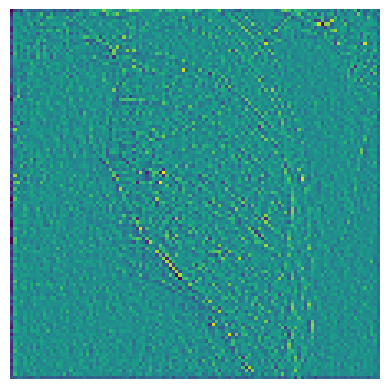

Epoch [1/5], Step [54/512], Loss: 0.1651, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


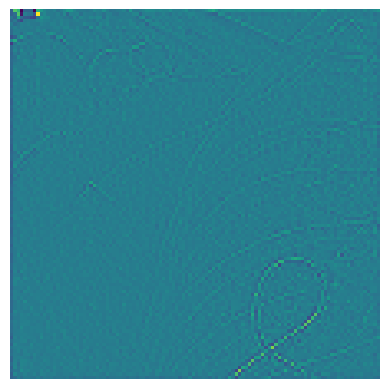

heres an image


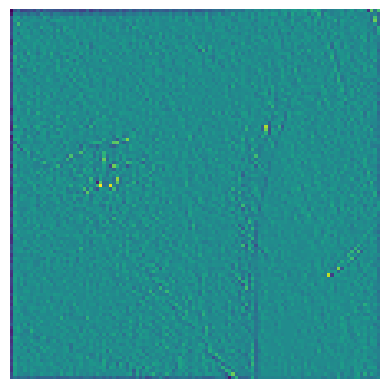

heres an image


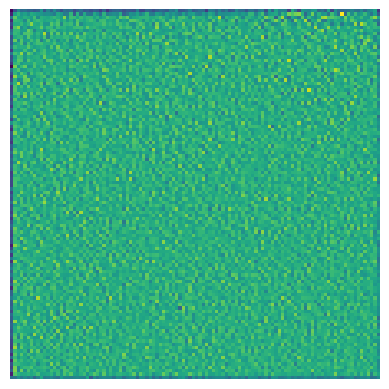

heres an image


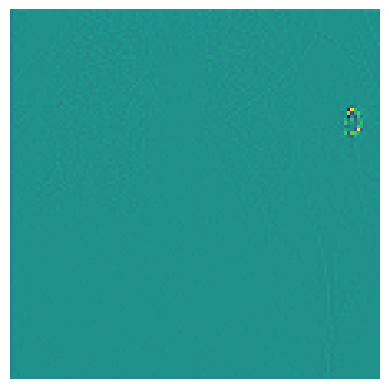

Epoch [1/5], Step [55/512], Loss: 0.5768, tp_sum: 0.0000, fp_sum: 1.0000, fn_sum: 11.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


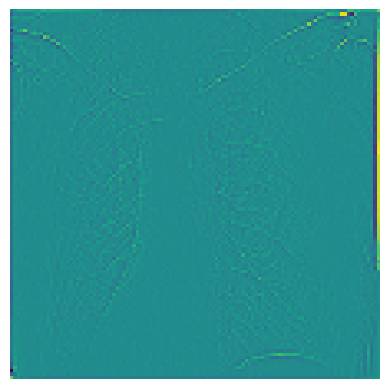

heres an image


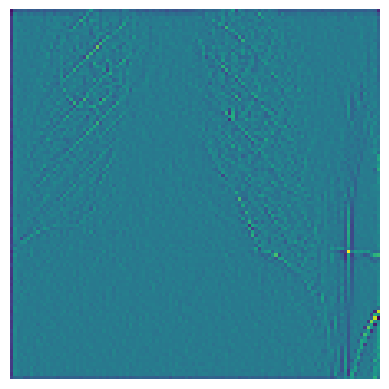

heres an image


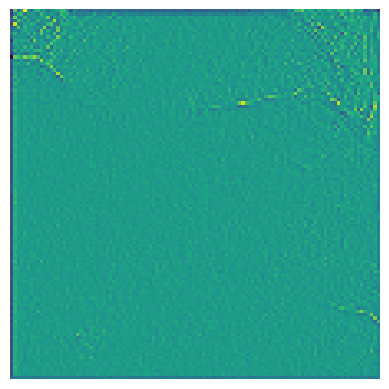

heres an image


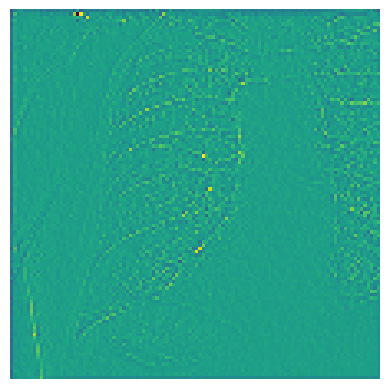

Epoch [1/5], Step [56/512], Loss: 0.2784, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 4.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


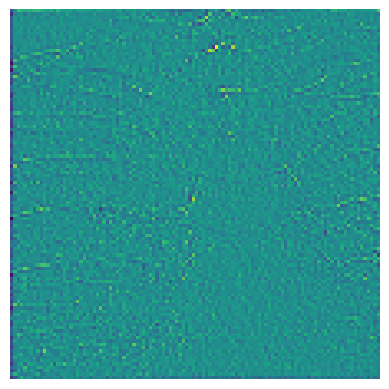

heres an image


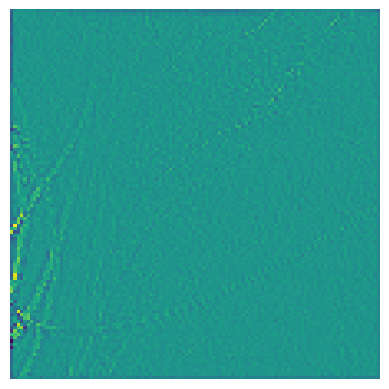

heres an image


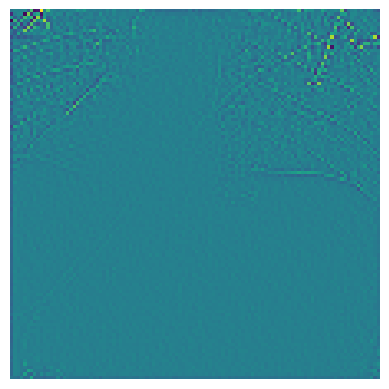

heres an image


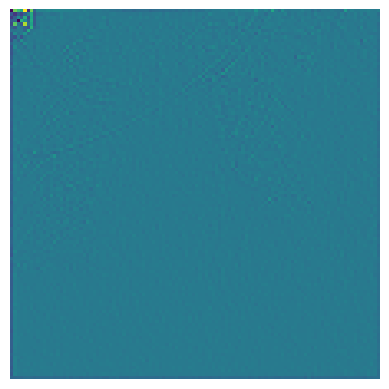

Epoch [1/5], Step [57/512], Loss: 0.1217, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


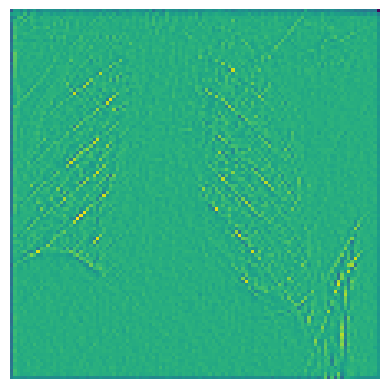

heres an image


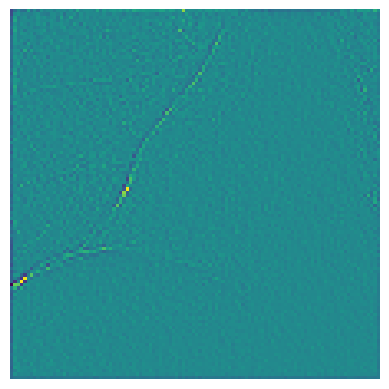

heres an image


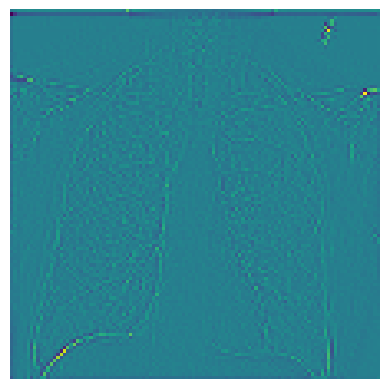

heres an image


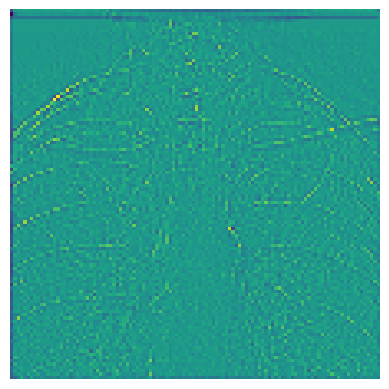

Epoch [1/5], Step [58/512], Loss: 0.0770, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


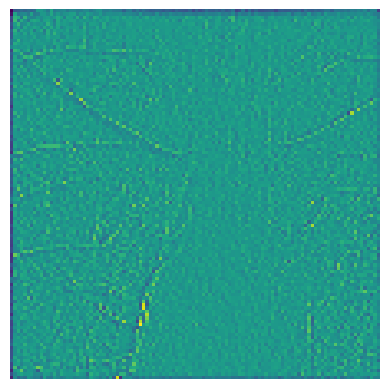

heres an image


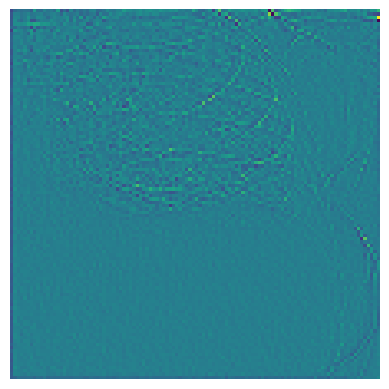

heres an image


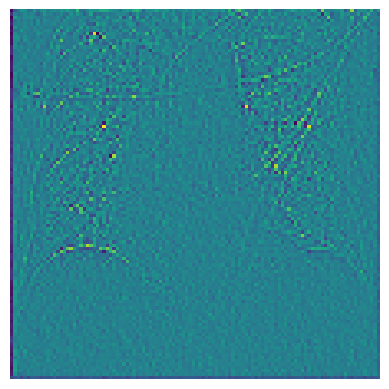

heres an image


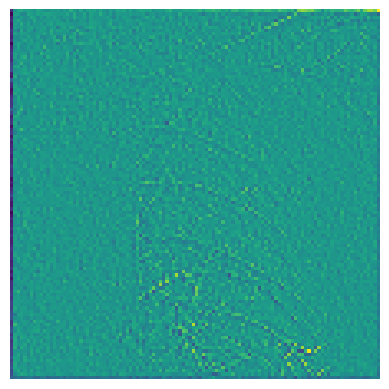

Epoch [1/5], Step [59/512], Loss: 0.2542, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 4.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


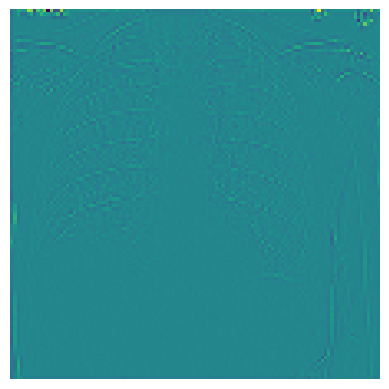

heres an image


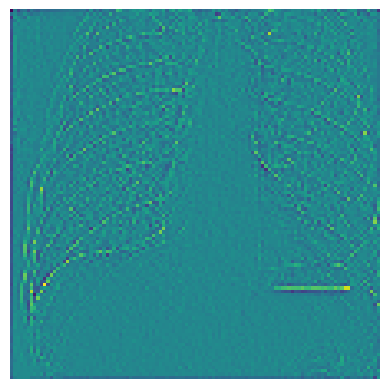

heres an image


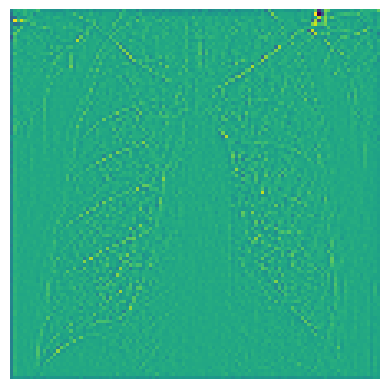

heres an image


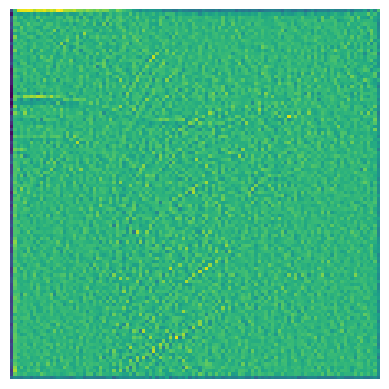

Epoch [1/5], Step [60/512], Loss: 0.1387, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 3.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


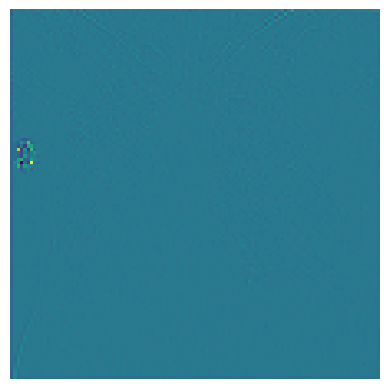

heres an image


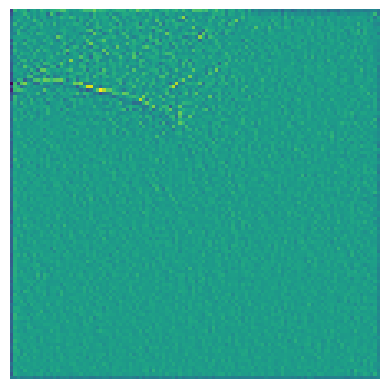

heres an image


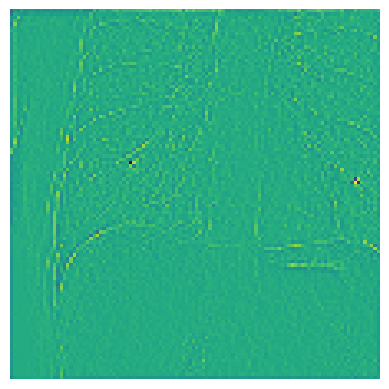

heres an image


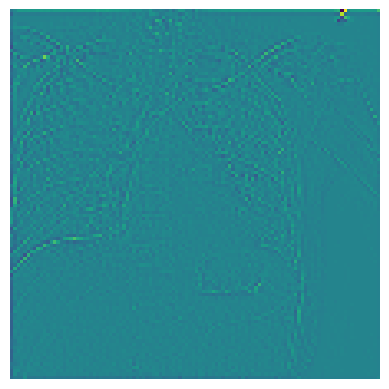

Epoch [1/5], Step [61/512], Loss: 0.5098, tp_sum: 1.0000, fp_sum: 3.0000, fn_sum: 7.0000, cumulative_f1_score: 0.1667
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


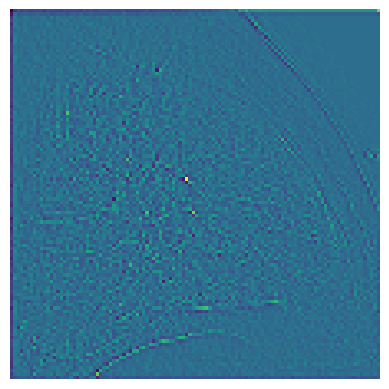

heres an image


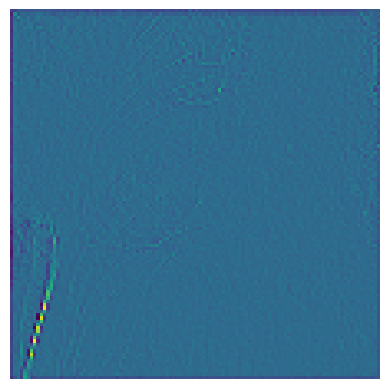

heres an image


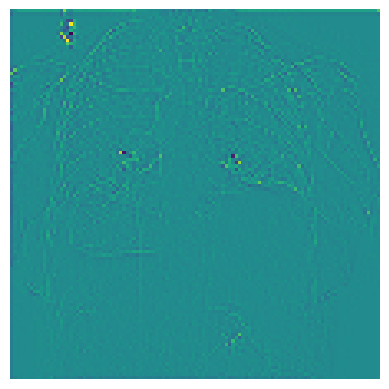

heres an image


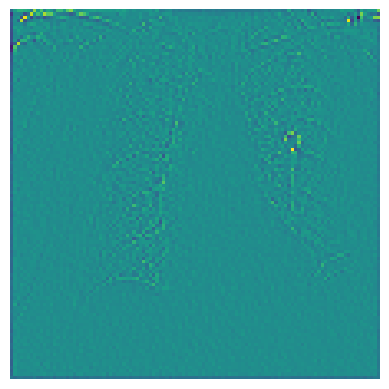

Epoch [1/5], Step [62/512], Loss: 0.4573, tp_sum: 1.0000, fp_sum: 0.0000, fn_sum: 7.0000, cumulative_f1_score: 0.2222
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


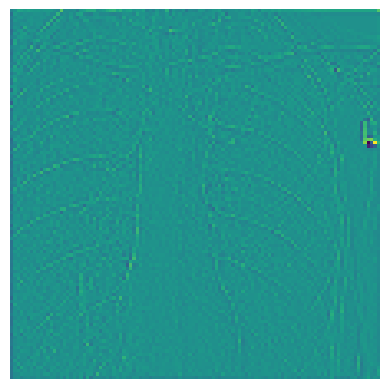

heres an image


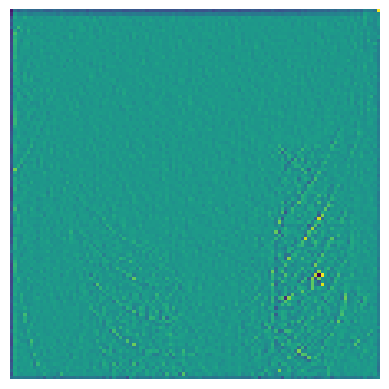

heres an image


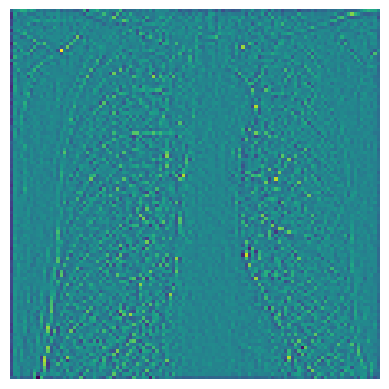

heres an image


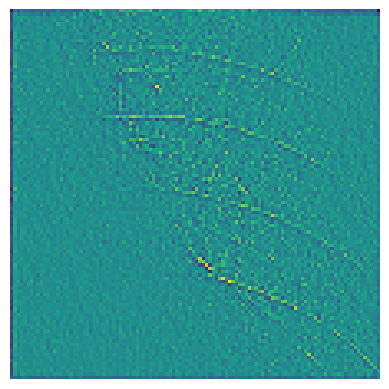

Epoch [1/5], Step [63/512], Loss: 0.1792, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 3.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


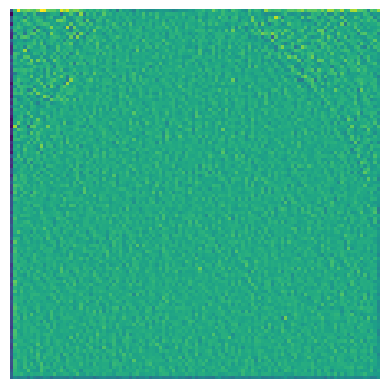

heres an image


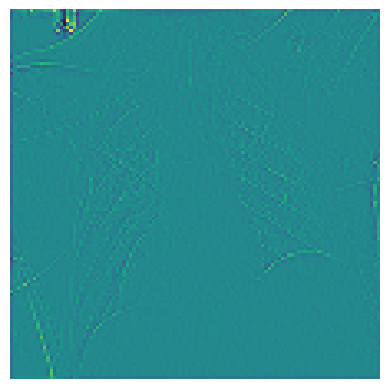

heres an image


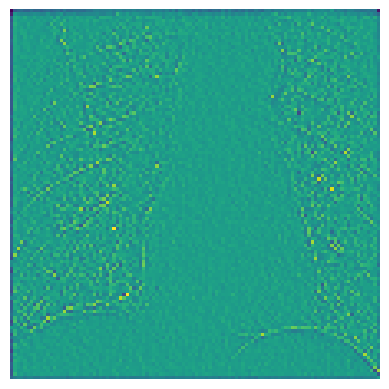

heres an image


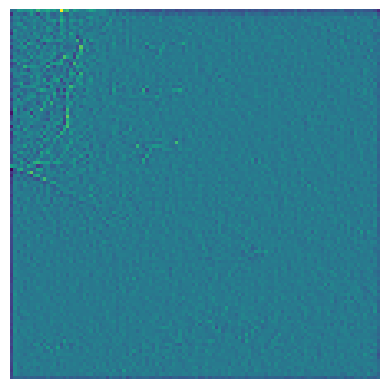

Epoch [1/5], Step [64/512], Loss: 0.3228, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 6.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


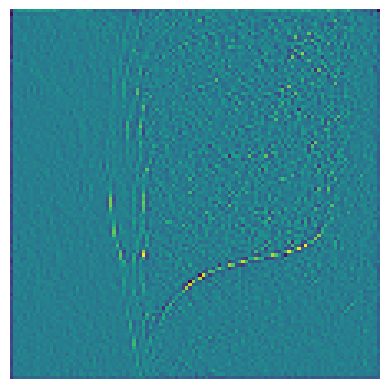

heres an image


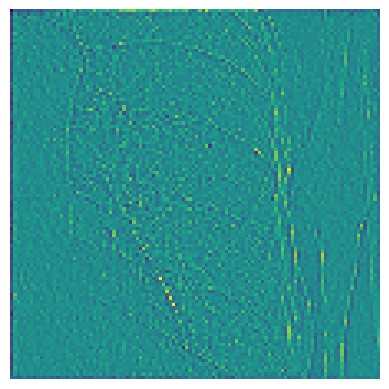

heres an image


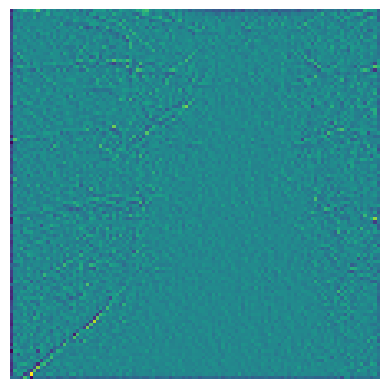

heres an image


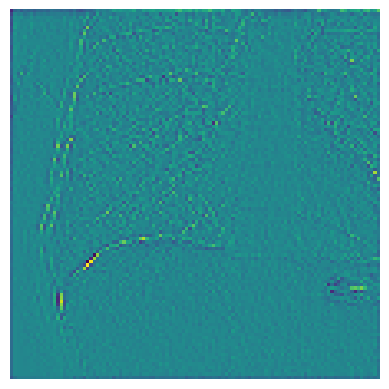

Epoch [1/5], Step [65/512], Loss: 0.0477, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 0.0000, cumulative_f1_score: nan
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


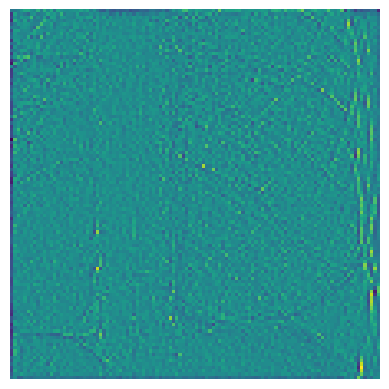

heres an image


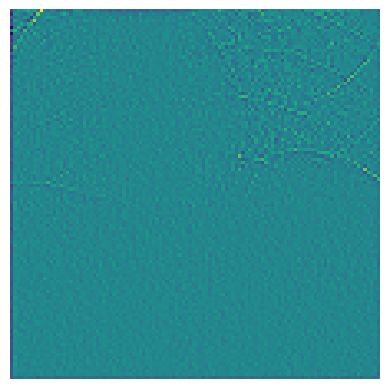

heres an image


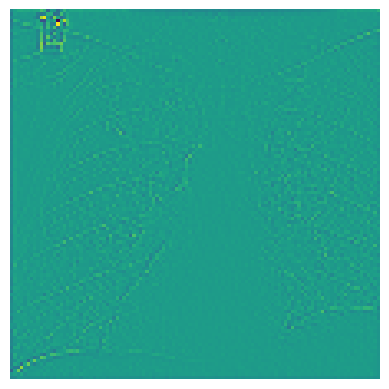

heres an image


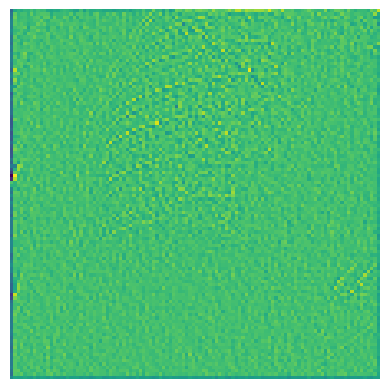

Epoch [1/5], Step [66/512], Loss: 0.1408, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


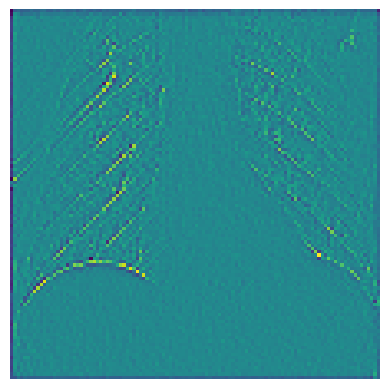

heres an image


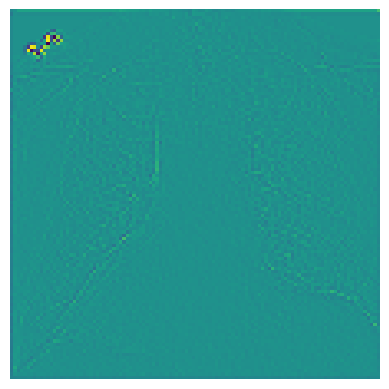

heres an image


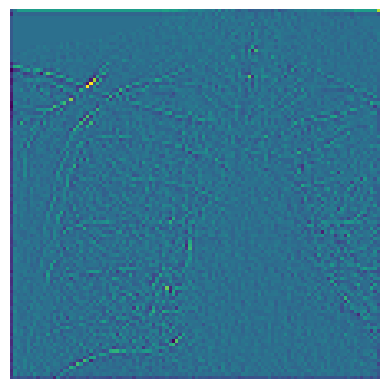

heres an image


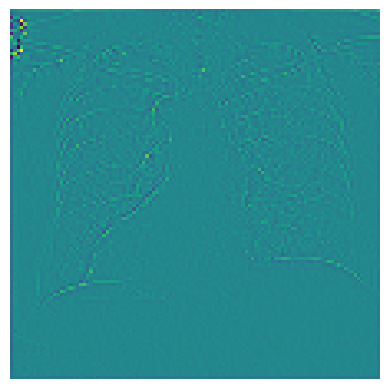

Epoch [1/5], Step [67/512], Loss: 0.0936, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


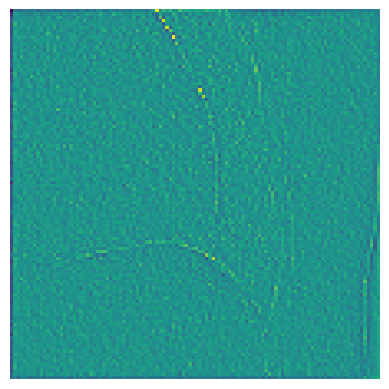

heres an image


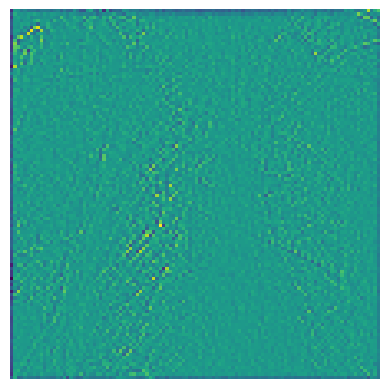

heres an image


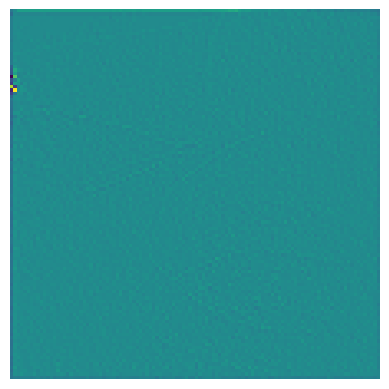

heres an image


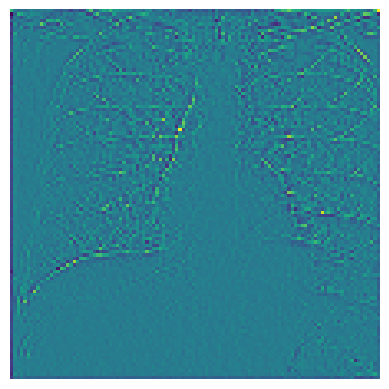

Epoch [1/5], Step [68/512], Loss: 0.2203, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 3.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


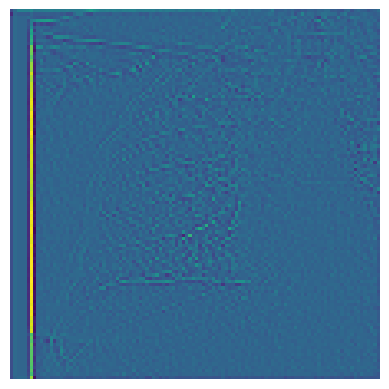

heres an image


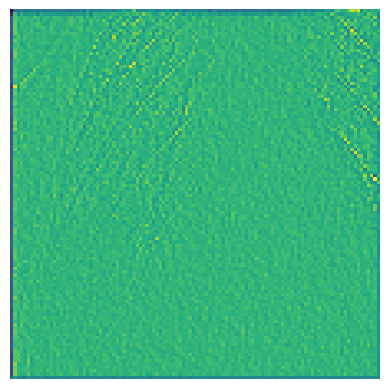

heres an image


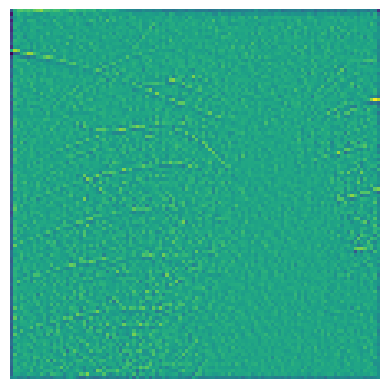

heres an image


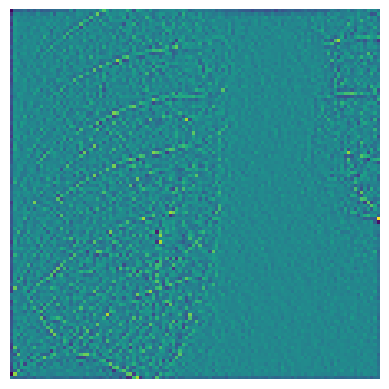

Epoch [1/5], Step [69/512], Loss: 0.0663, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


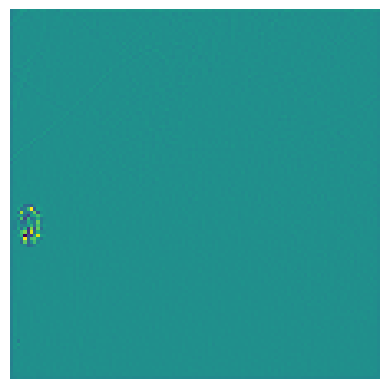

heres an image


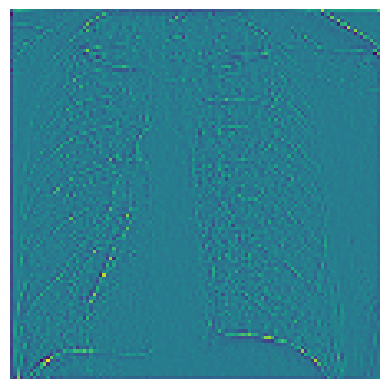

heres an image


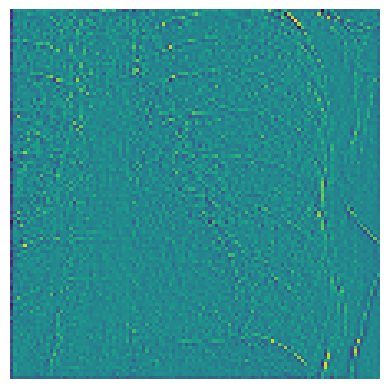

heres an image


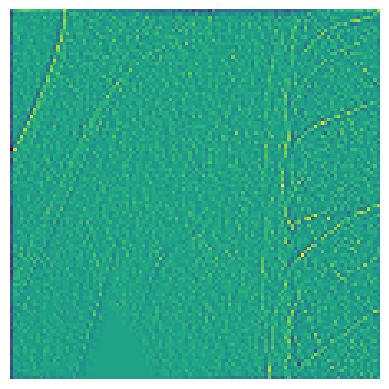

Epoch [1/5], Step [70/512], Loss: 0.2156, tp_sum: 0.0000, fp_sum: 4.0000, fn_sum: 3.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


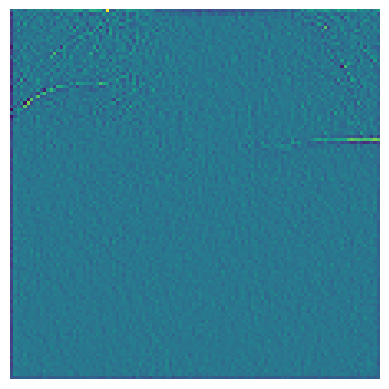

heres an image


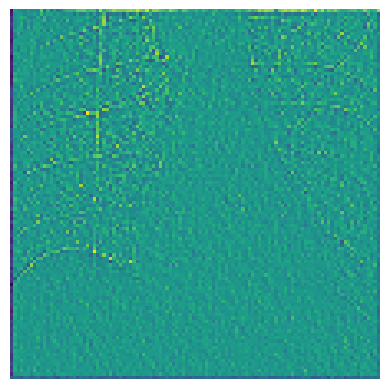

heres an image


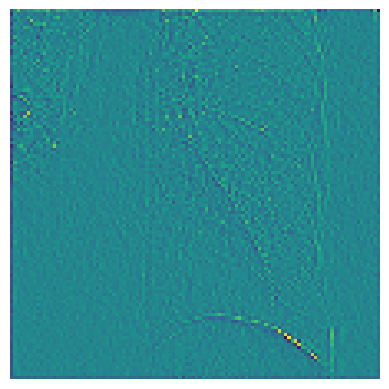

heres an image


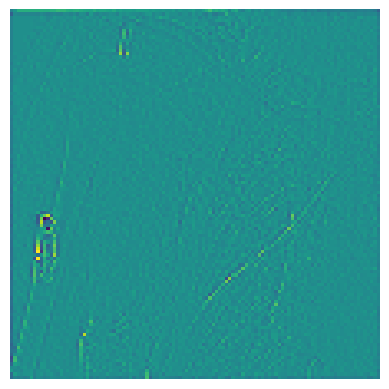

Epoch [1/5], Step [71/512], Loss: 0.4593, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 7.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


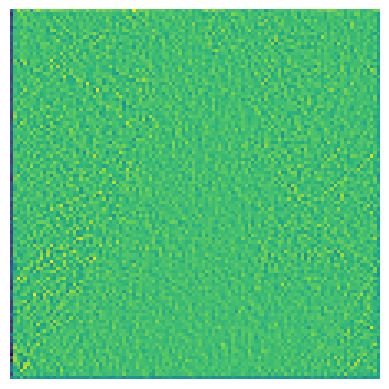

heres an image


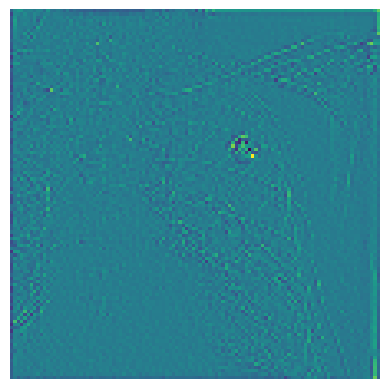

heres an image


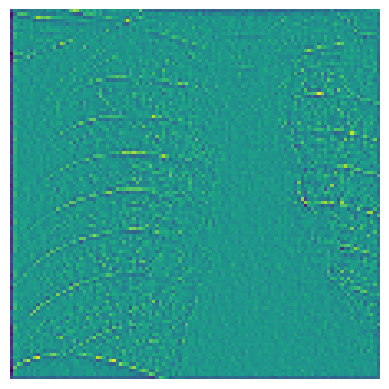

heres an image


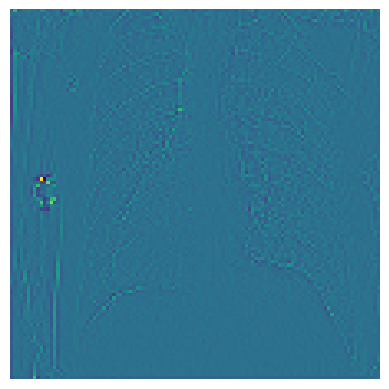

Epoch [1/5], Step [72/512], Loss: 0.1585, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 3.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


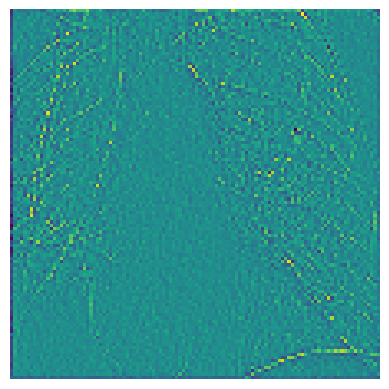

heres an image


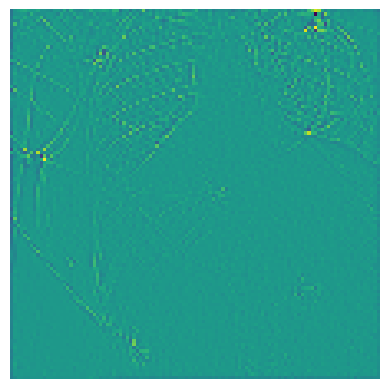

heres an image


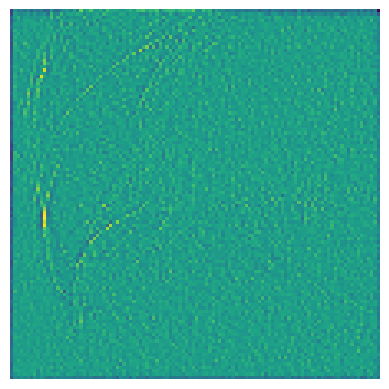

heres an image


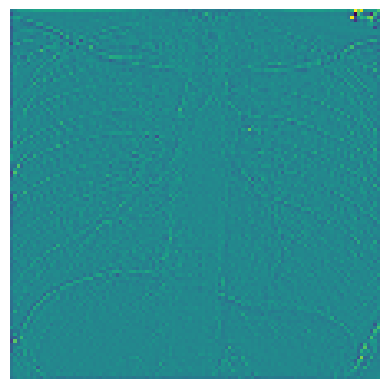

Epoch [1/5], Step [73/512], Loss: 0.1564, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


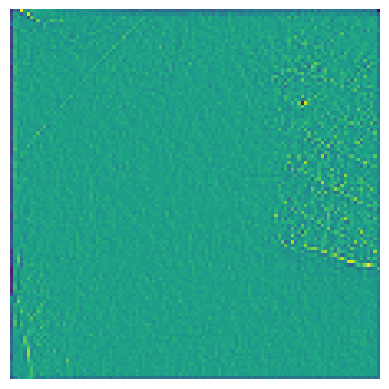

heres an image


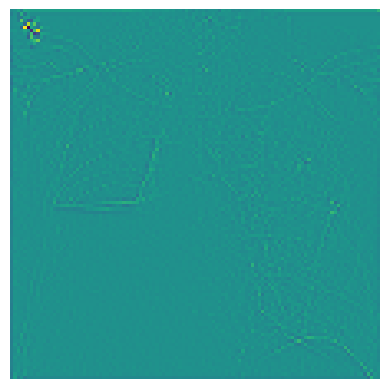

heres an image


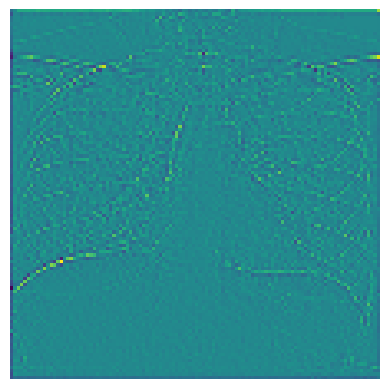

heres an image


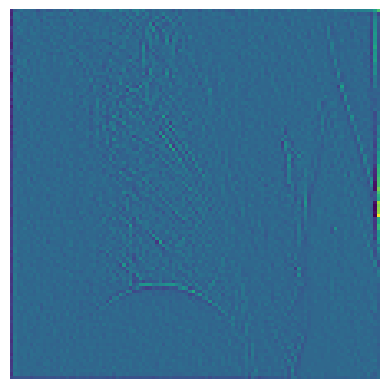

Epoch [1/5], Step [74/512], Loss: 0.1085, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


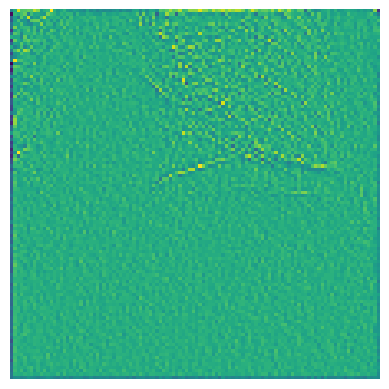

heres an image


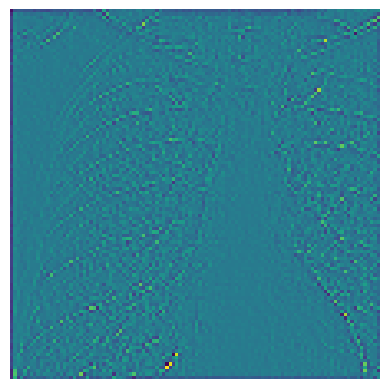

heres an image


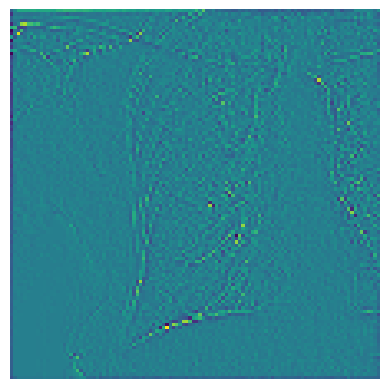

heres an image


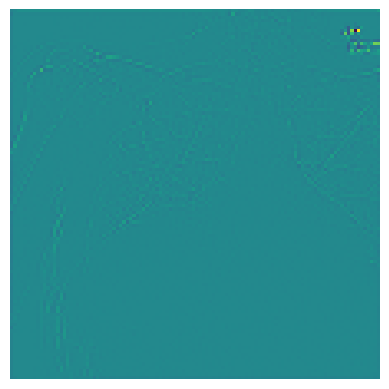

Epoch [1/5], Step [75/512], Loss: 0.2821, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 4.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


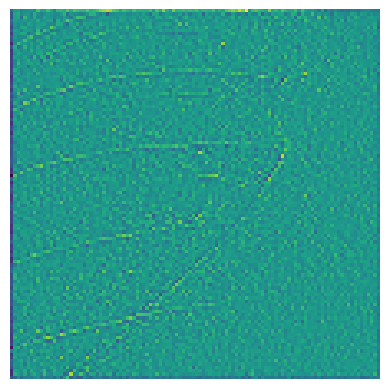

heres an image


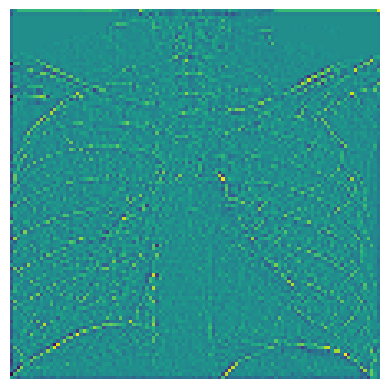

heres an image


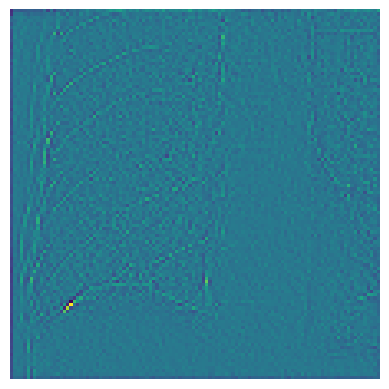

heres an image


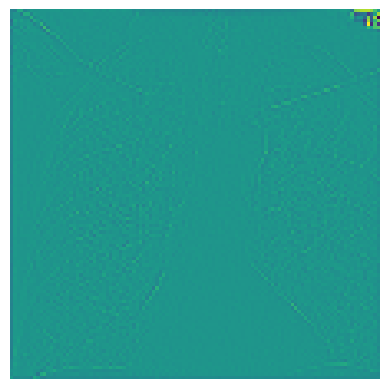

Epoch [1/5], Step [76/512], Loss: 0.1321, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


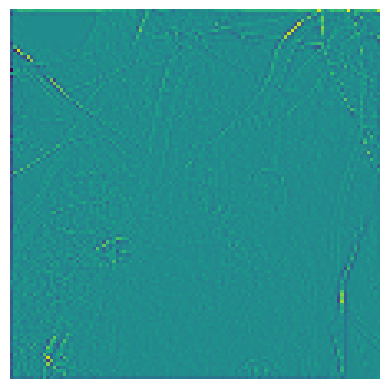

heres an image


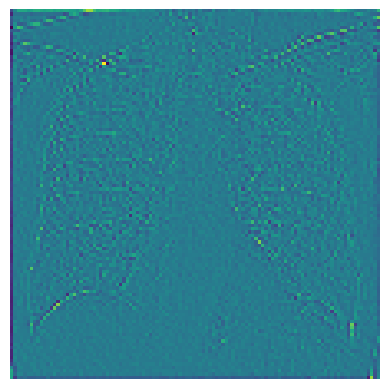

heres an image


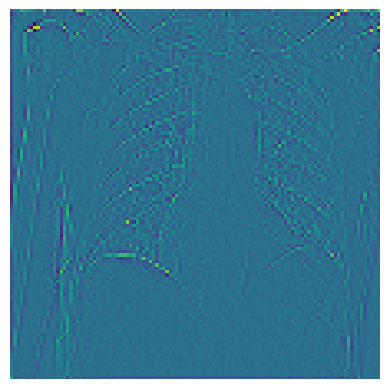

heres an image


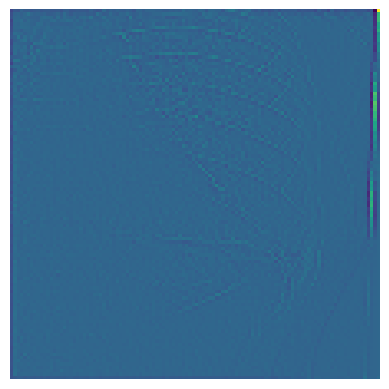

Epoch [1/5], Step [77/512], Loss: 0.0630, tp_sum: 1.0000, fp_sum: 0.0000, fn_sum: 0.0000, cumulative_f1_score: 1.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


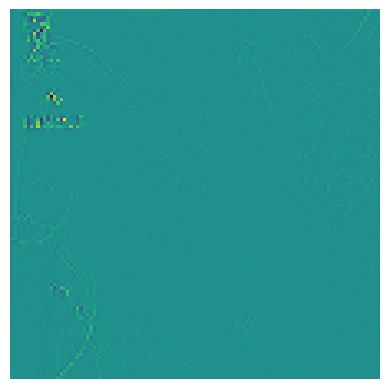

heres an image


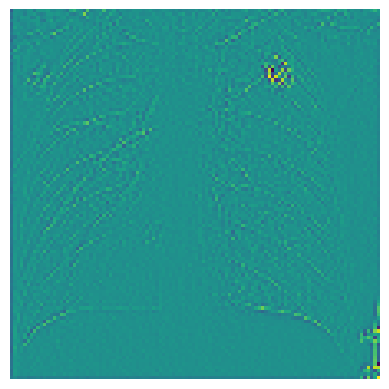

heres an image


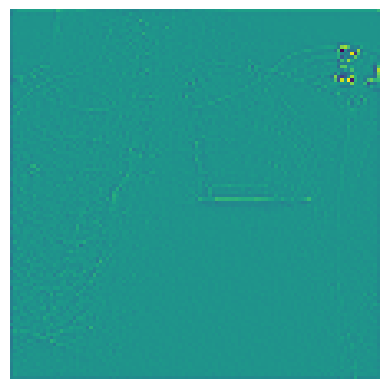

heres an image


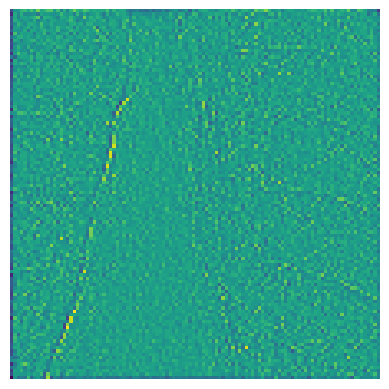

Epoch [1/5], Step [78/512], Loss: 0.1352, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


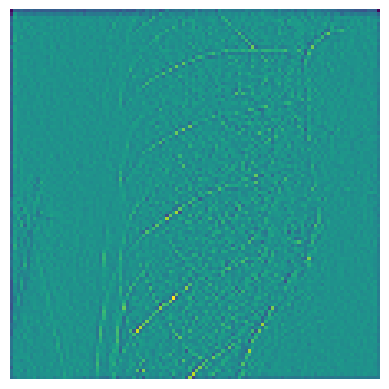

heres an image


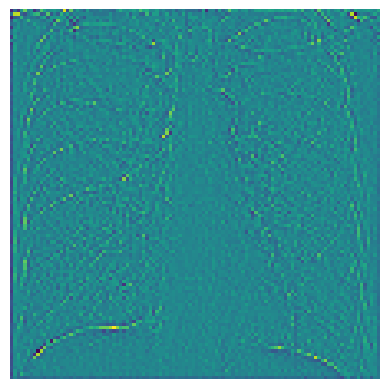

heres an image


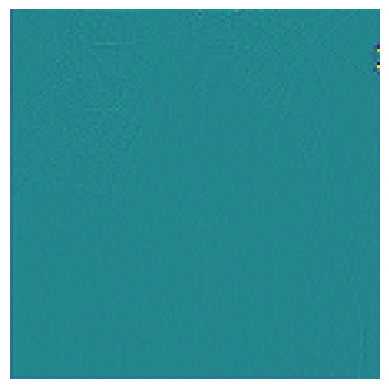

heres an image


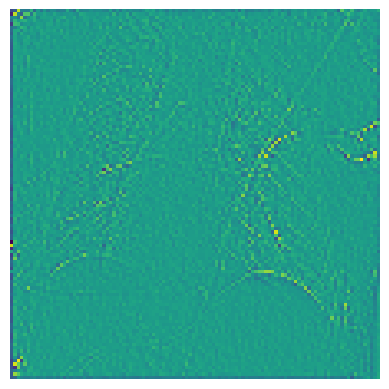

Epoch [1/5], Step [79/512], Loss: 0.2532, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 4.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


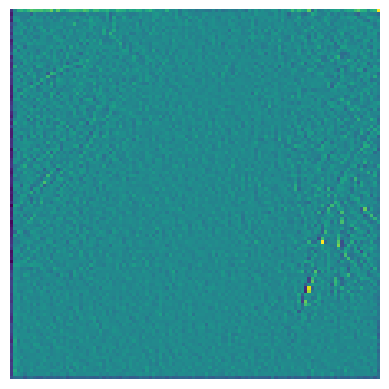

heres an image


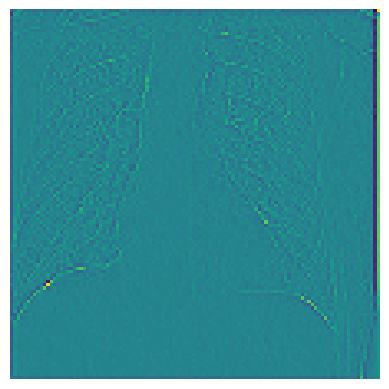

heres an image


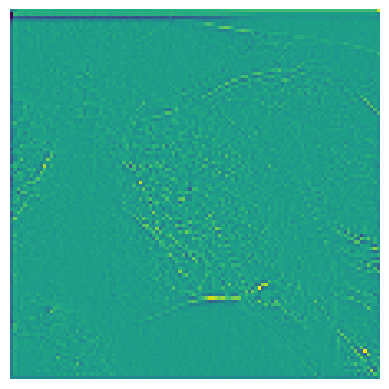

heres an image


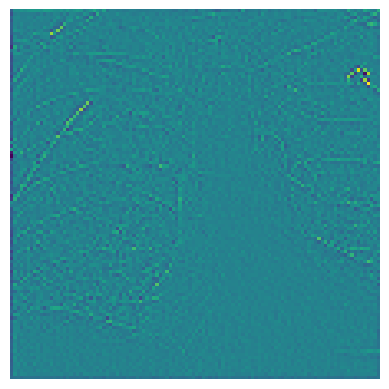

Epoch [1/5], Step [80/512], Loss: 0.3040, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 4.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


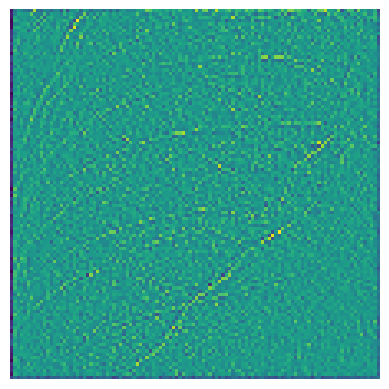

heres an image


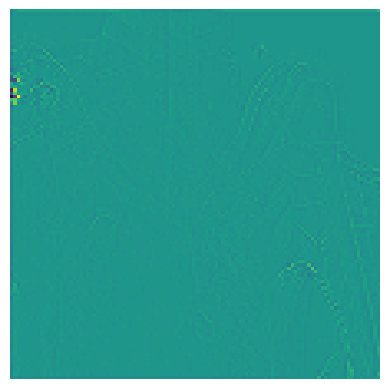

heres an image


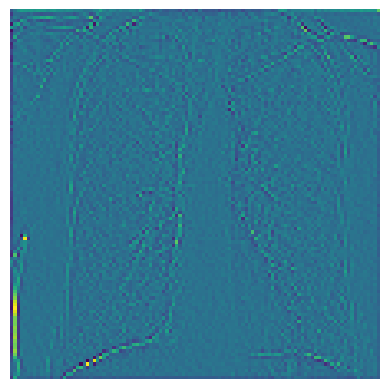

heres an image


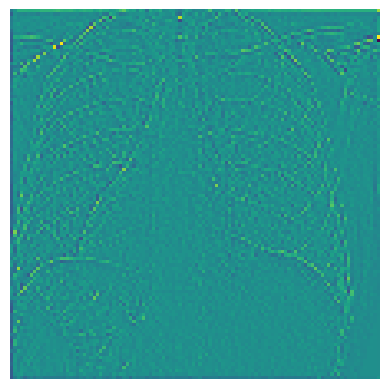

Epoch [1/5], Step [81/512], Loss: 0.1132, tp_sum: 0.0000, fp_sum: 1.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


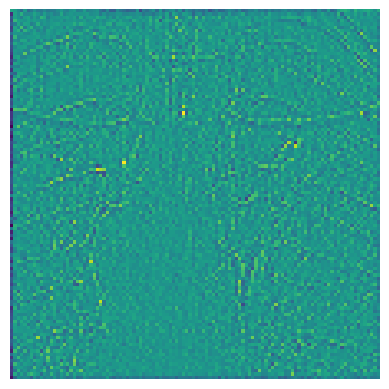

heres an image


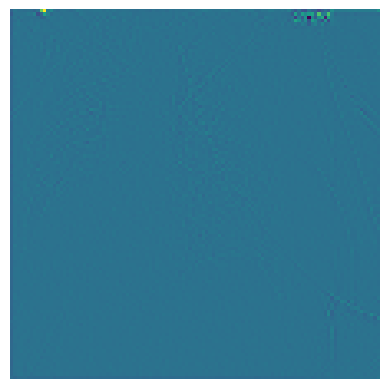

heres an image


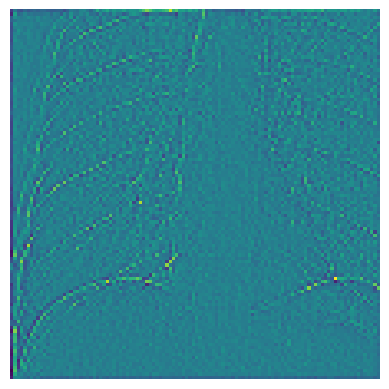

heres an image


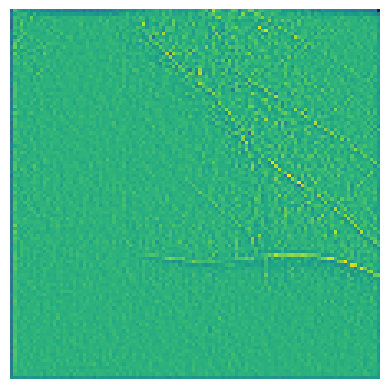

Epoch [1/5], Step [82/512], Loss: 0.0830, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


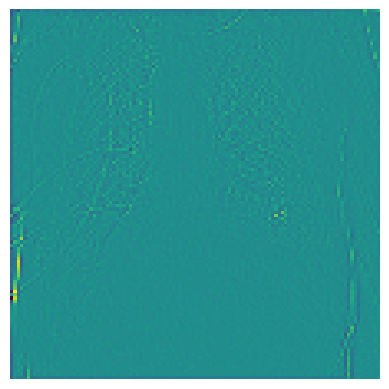

heres an image


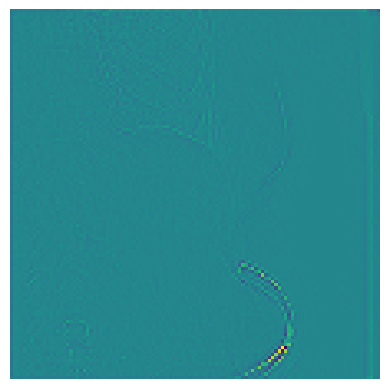

heres an image


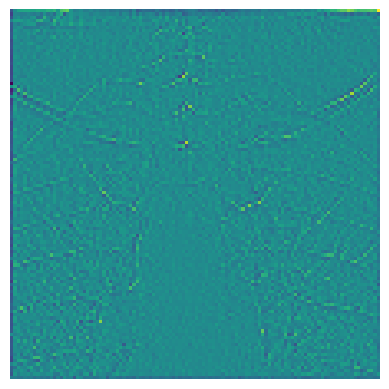

heres an image


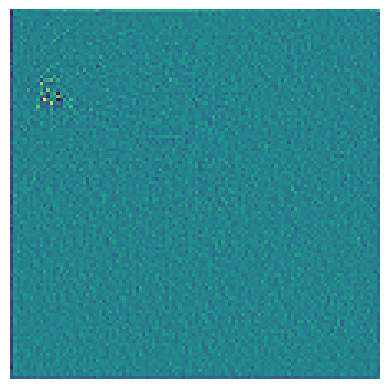

Epoch [1/5], Step [83/512], Loss: 0.2284, tp_sum: 1.0000, fp_sum: 0.0000, fn_sum: 3.0000, cumulative_f1_score: 0.4000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


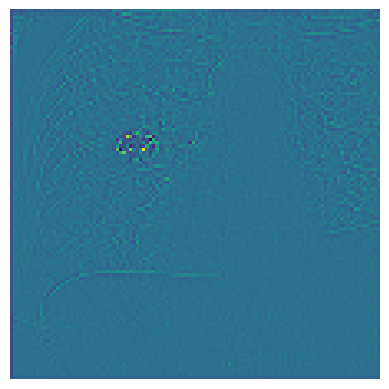

heres an image


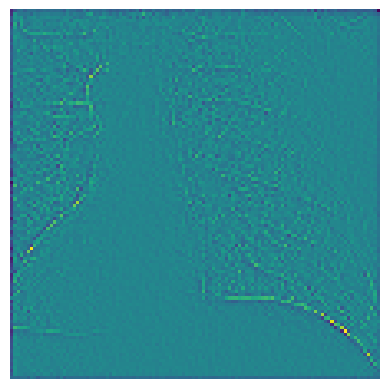

heres an image


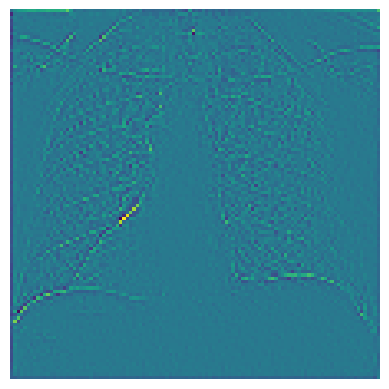

heres an image


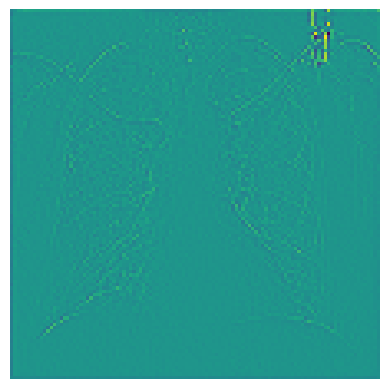

Epoch [1/5], Step [84/512], Loss: 0.1407, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


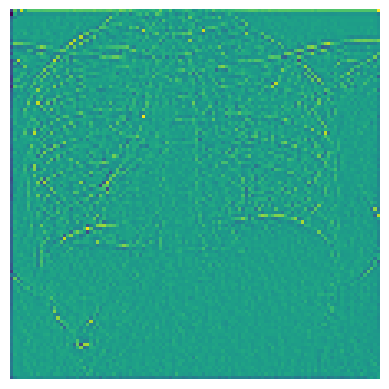

heres an image


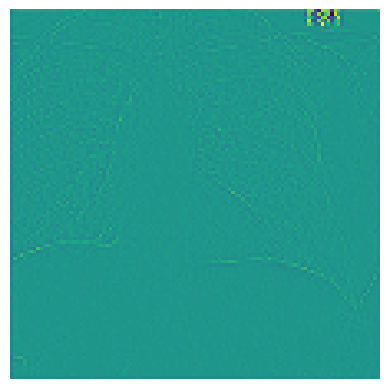

heres an image


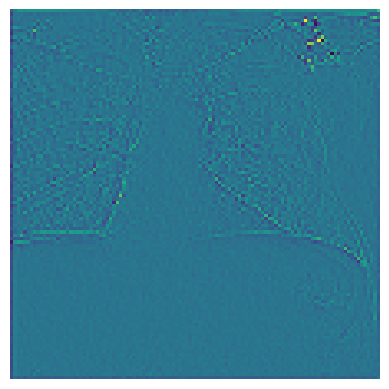

heres an image


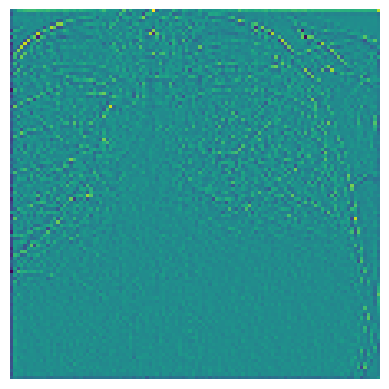

Epoch [1/5], Step [85/512], Loss: 0.1011, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


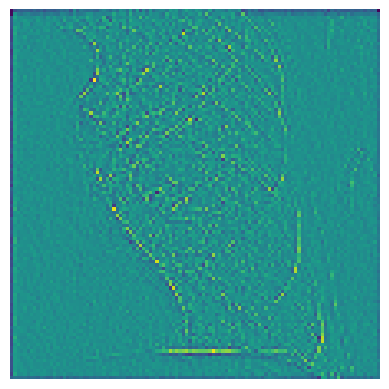

heres an image


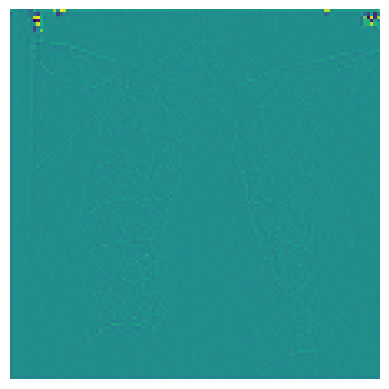

heres an image


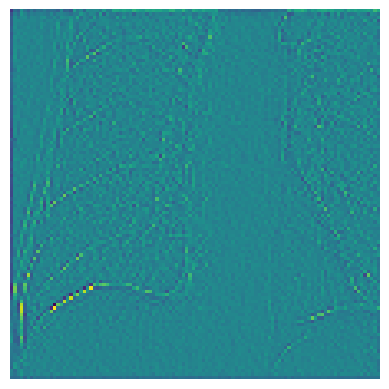

heres an image


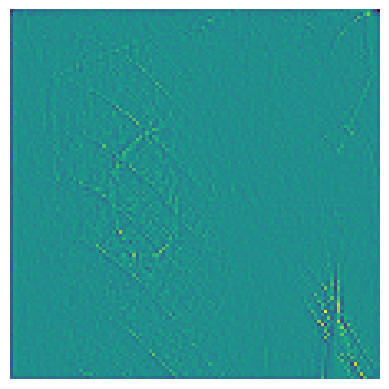

Epoch [1/5], Step [86/512], Loss: 0.1564, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


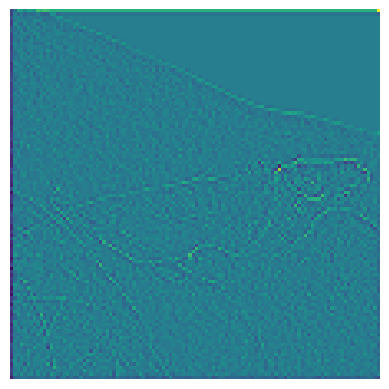

heres an image


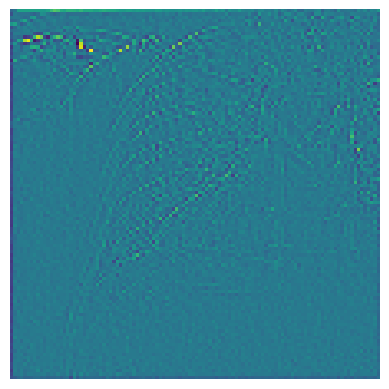

heres an image


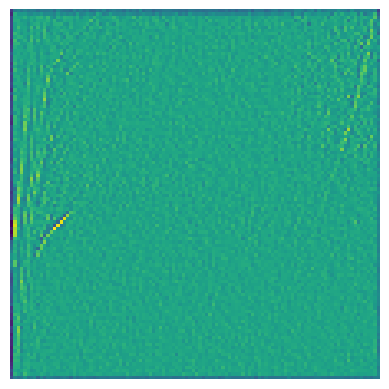

heres an image


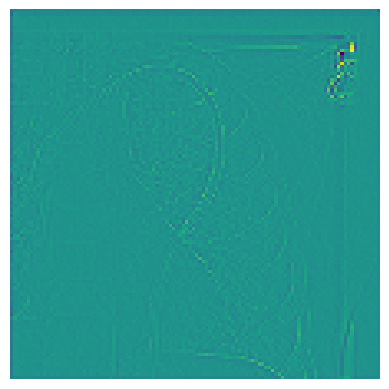

Epoch [1/5], Step [87/512], Loss: 0.0672, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 0.0000, cumulative_f1_score: nan
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


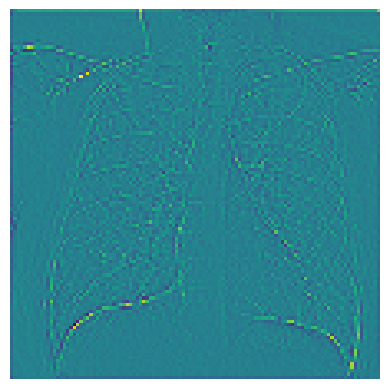

heres an image


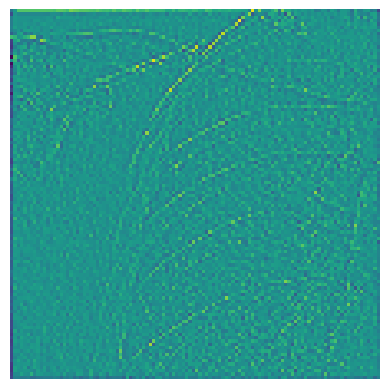

heres an image


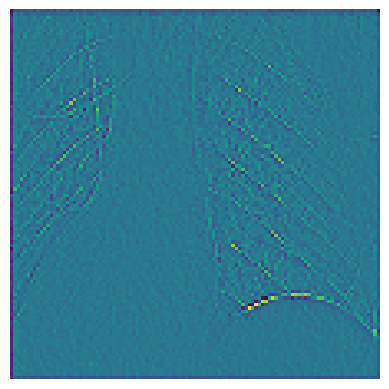

heres an image


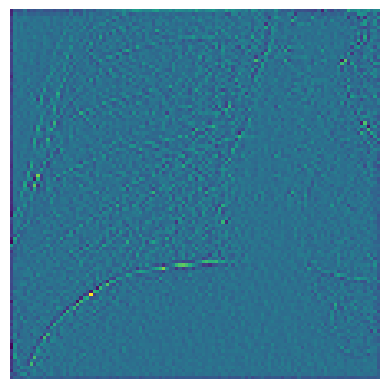

Epoch [1/5], Step [88/512], Loss: 0.1261, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


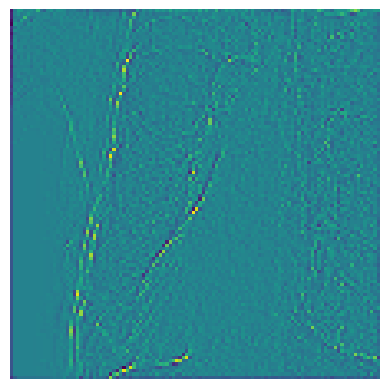

heres an image


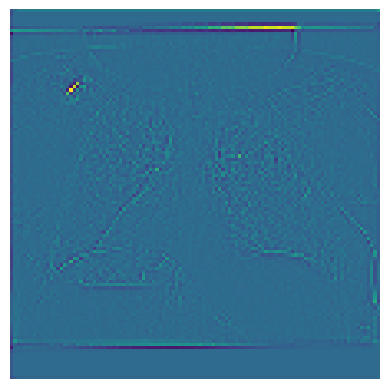

heres an image


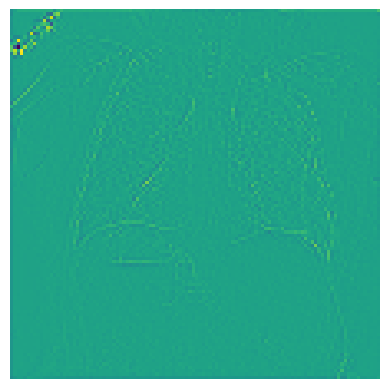

heres an image


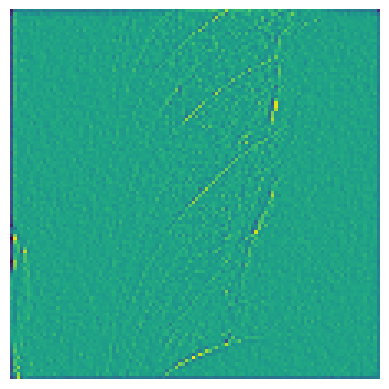

Epoch [1/5], Step [89/512], Loss: 0.1680, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


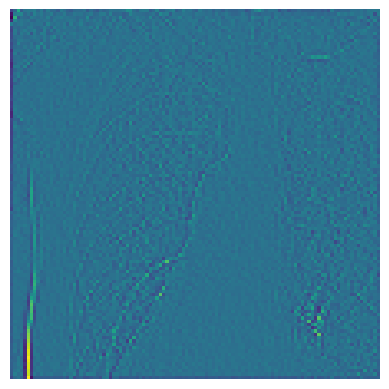

heres an image


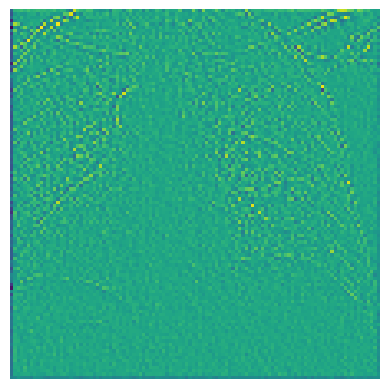

heres an image


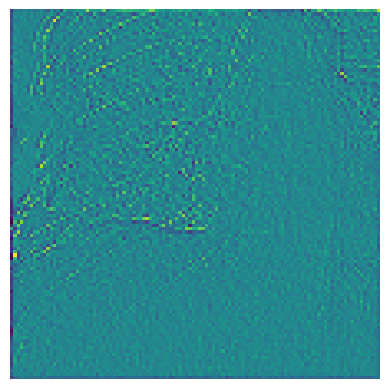

heres an image


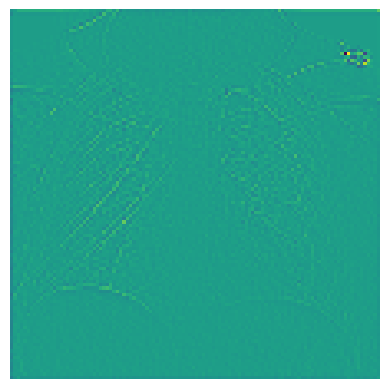

Epoch [1/5], Step [90/512], Loss: 0.3310, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 5.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


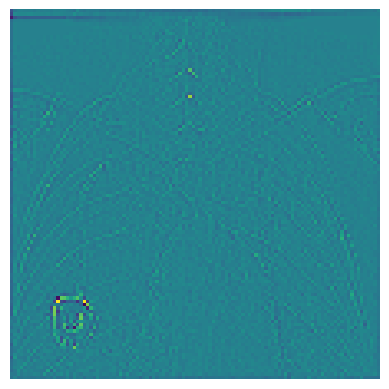

heres an image


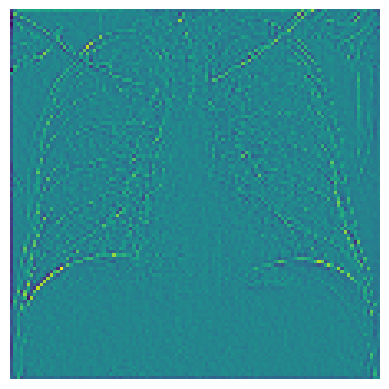

heres an image


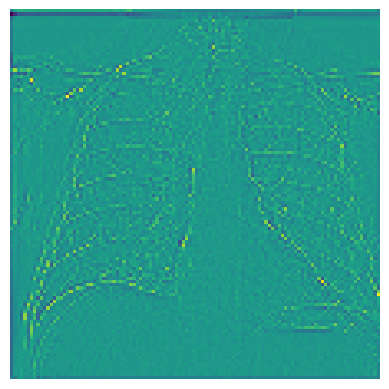

heres an image


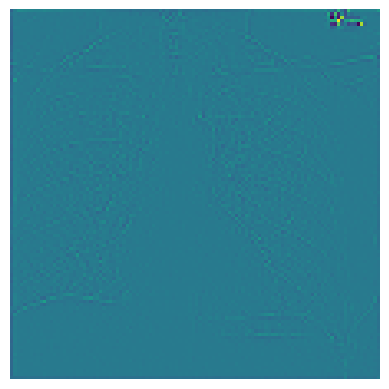

Epoch [1/5], Step [91/512], Loss: 0.1771, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 3.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


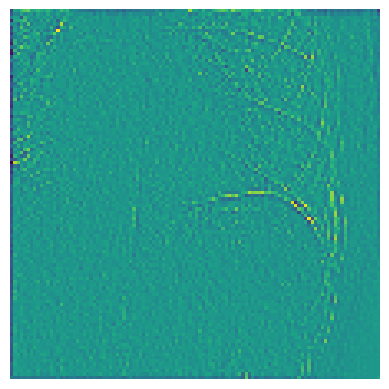

heres an image


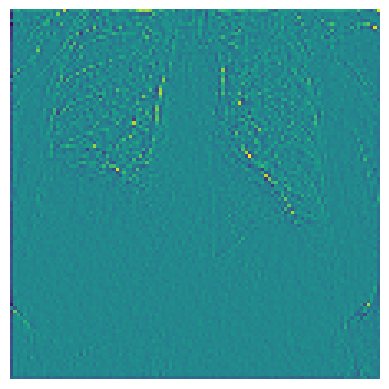

heres an image


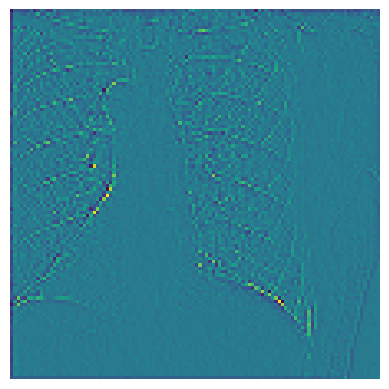

heres an image


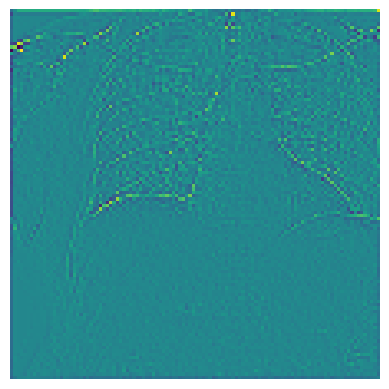

Epoch [1/5], Step [92/512], Loss: 0.1233, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


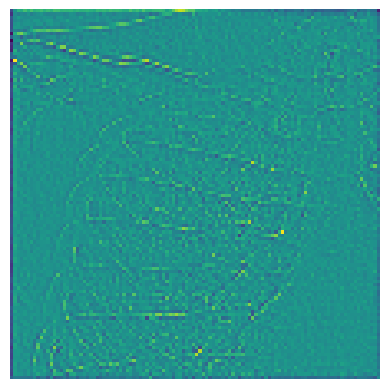

heres an image


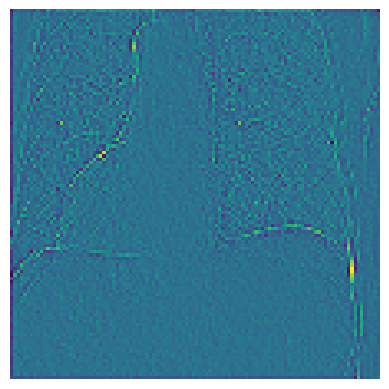

heres an image


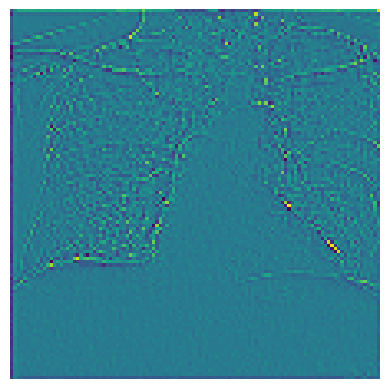

heres an image


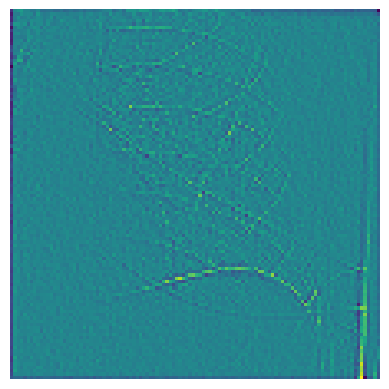

Epoch [1/5], Step [93/512], Loss: 0.0359, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 0.0000, cumulative_f1_score: nan
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


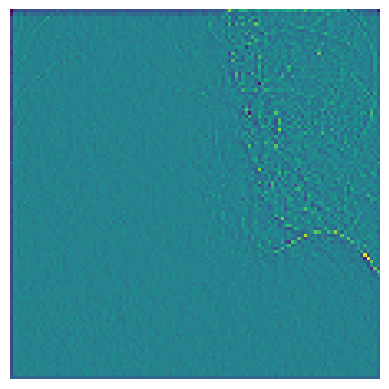

heres an image


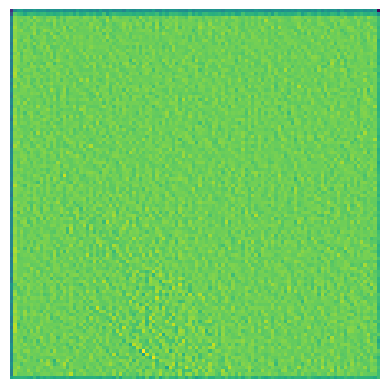

heres an image


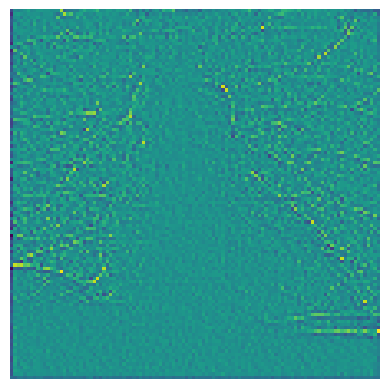

heres an image


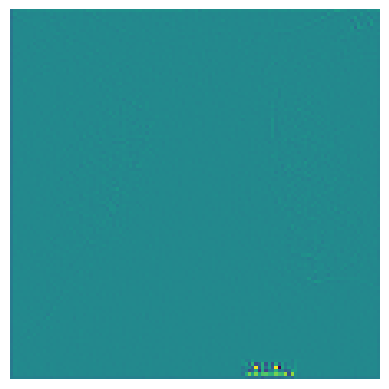

Epoch [1/5], Step [94/512], Loss: 0.1140, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


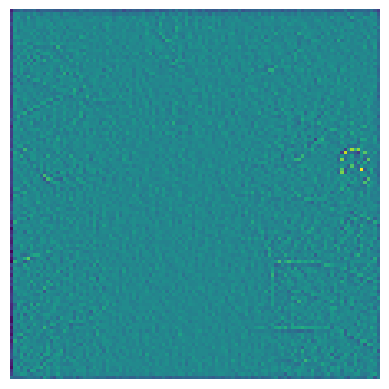

heres an image


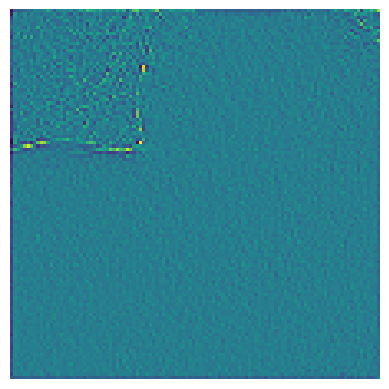

heres an image


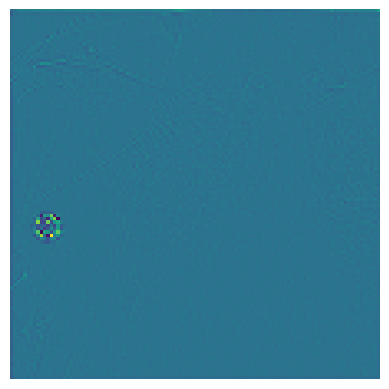

heres an image


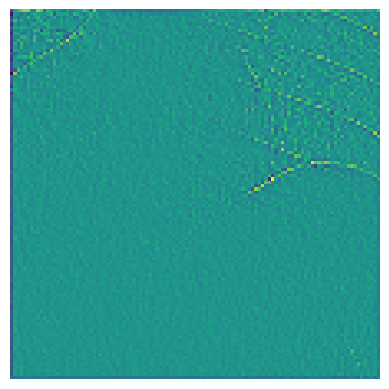

Epoch [1/5], Step [95/512], Loss: 0.3068, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 5.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


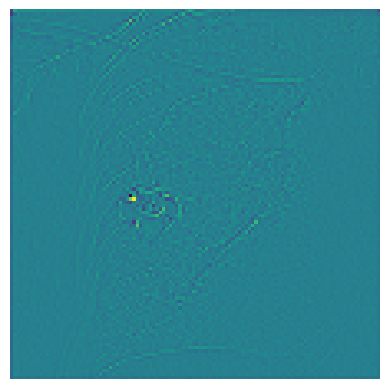

heres an image


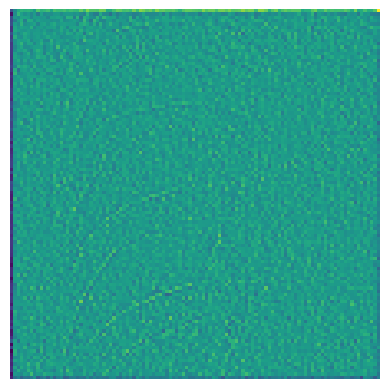

heres an image


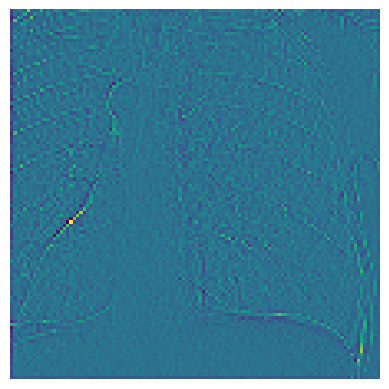

heres an image


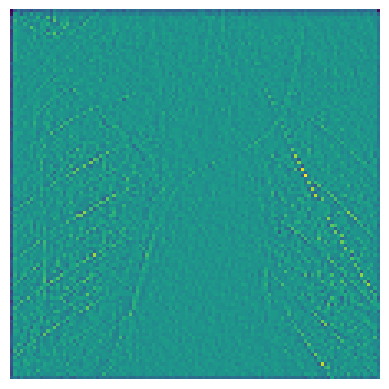

Epoch [1/5], Step [96/512], Loss: 0.0525, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 0.0000, cumulative_f1_score: nan
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


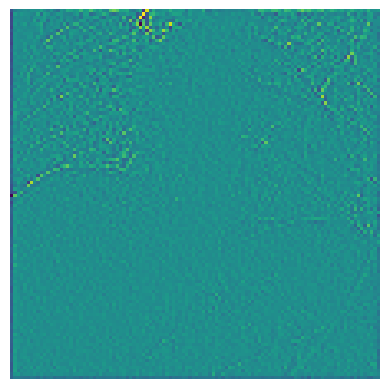

heres an image


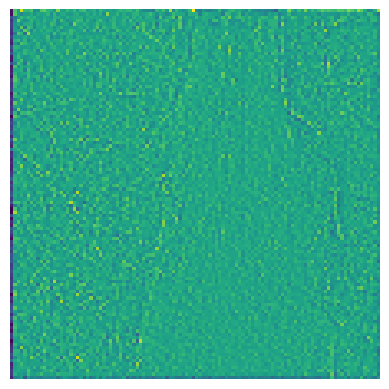

heres an image


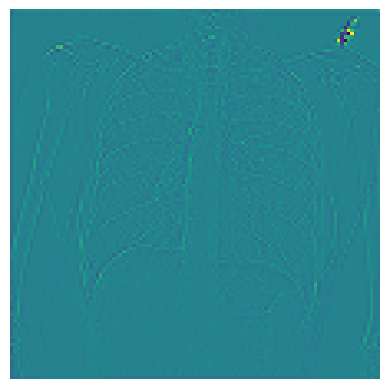

heres an image


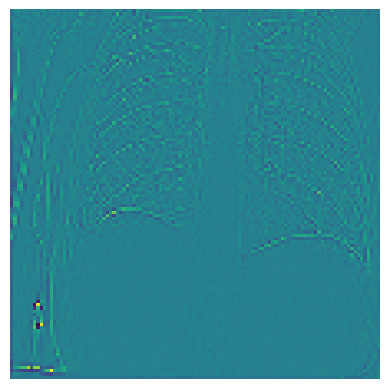

Epoch [1/5], Step [97/512], Loss: 0.2211, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 3.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


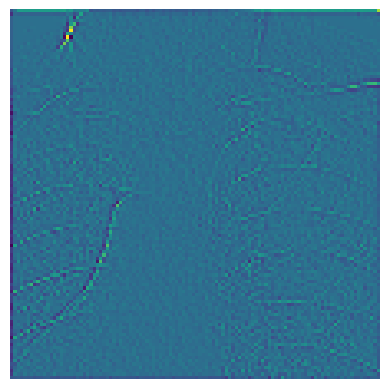

heres an image


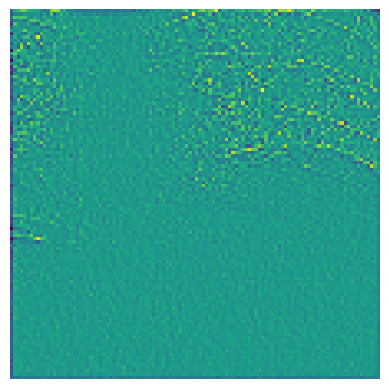

heres an image


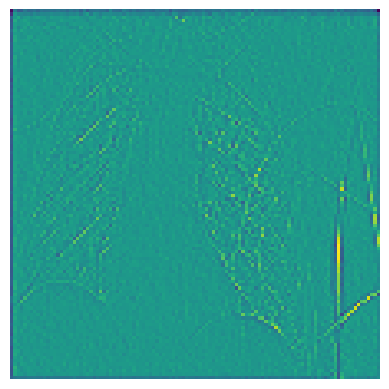

heres an image


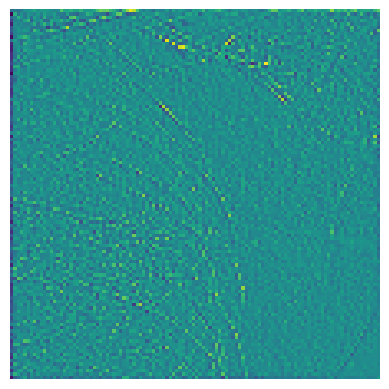

Epoch [1/5], Step [98/512], Loss: 0.1919, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 3.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


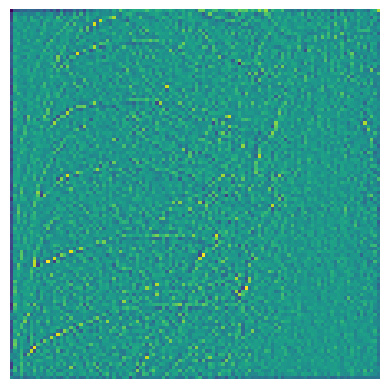

heres an image


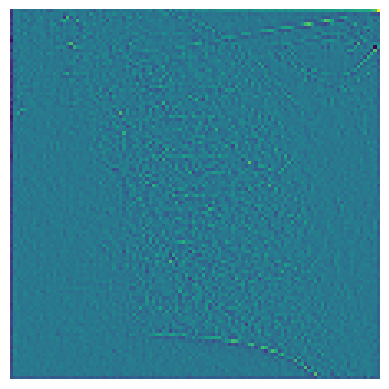

heres an image


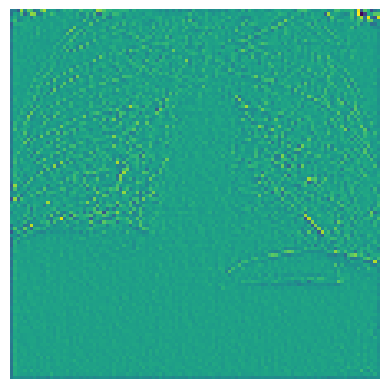

heres an image


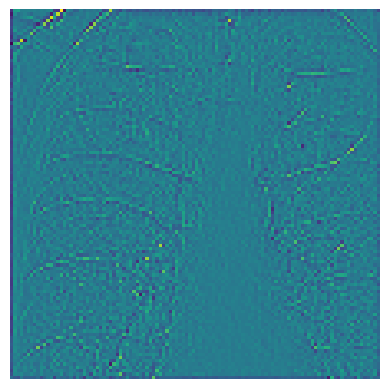

Epoch [1/5], Step [99/512], Loss: 0.0837, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


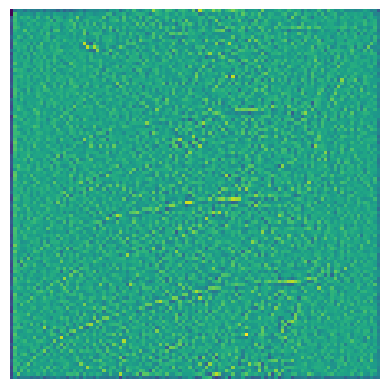

heres an image


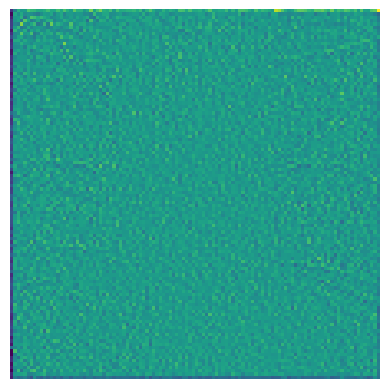

heres an image


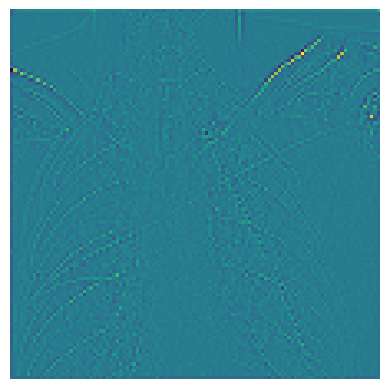

heres an image


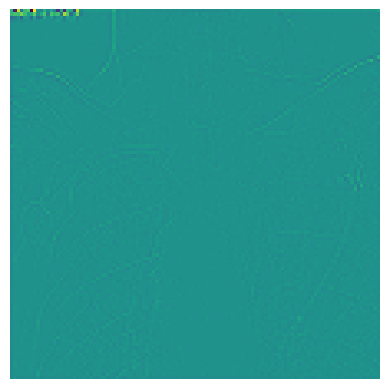

Epoch [1/5], Step [100/512], Loss: 0.1767, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 3.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


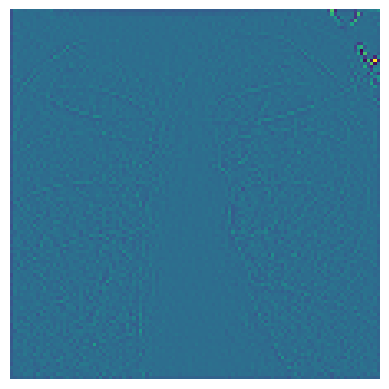

heres an image


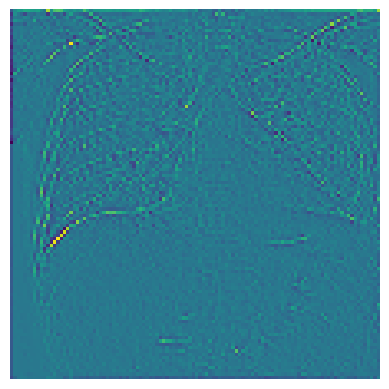

heres an image


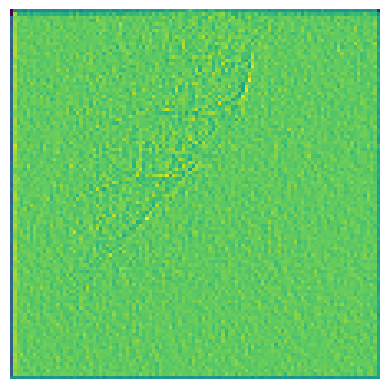

heres an image


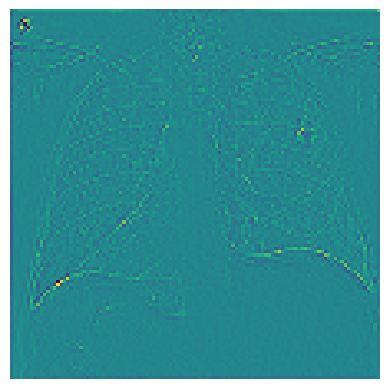

Epoch [1/5], Step [101/512], Loss: 0.1775, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 3.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


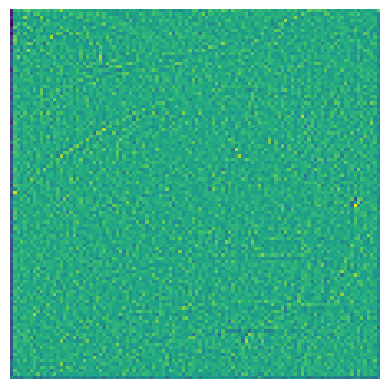

heres an image


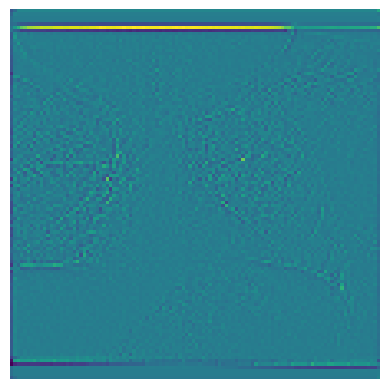

heres an image


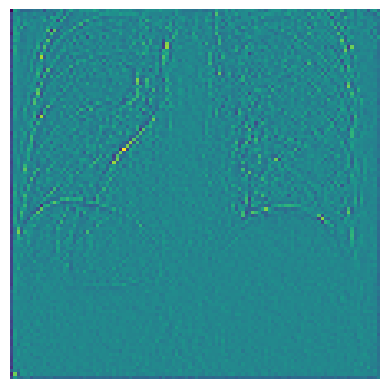

heres an image


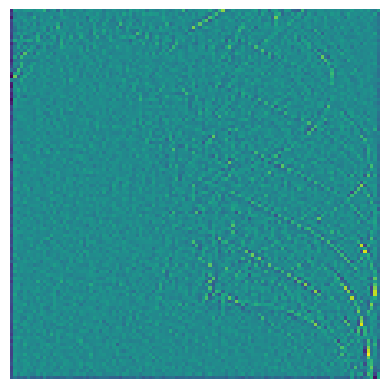

Epoch [1/5], Step [102/512], Loss: 0.1956, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 3.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


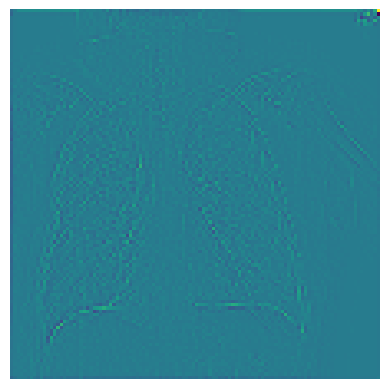

heres an image


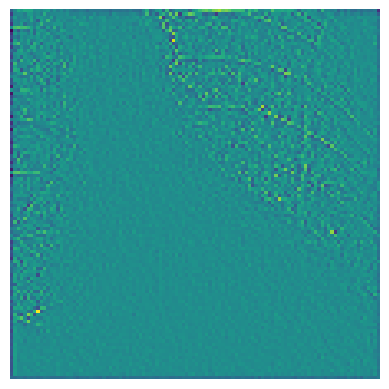

heres an image


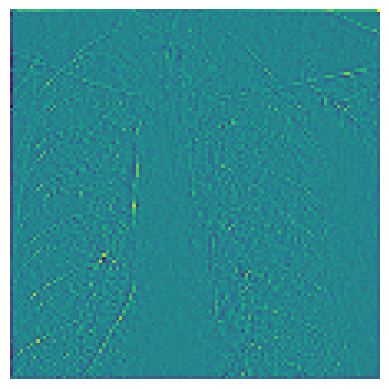

heres an image


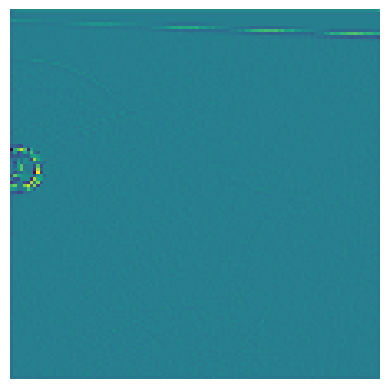

Epoch [1/5], Step [103/512], Loss: 0.1324, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


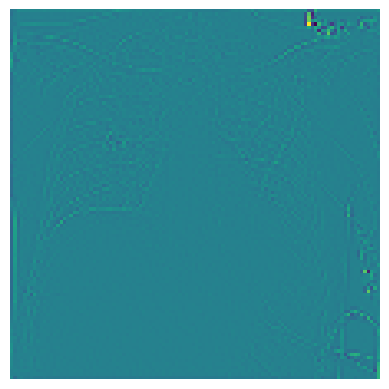

heres an image


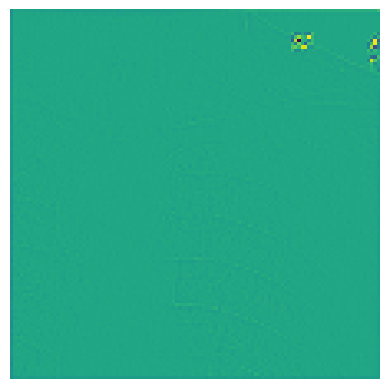

heres an image


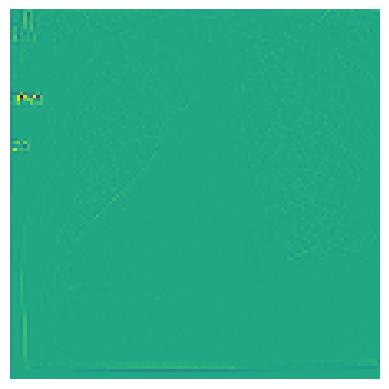

heres an image


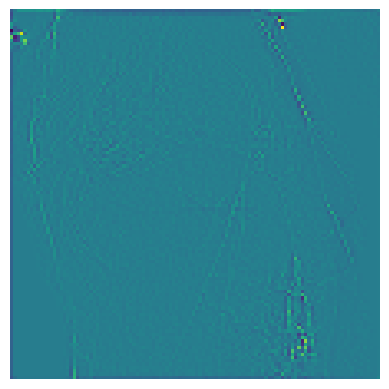

Epoch [1/5], Step [104/512], Loss: 0.5491, tp_sum: 0.0000, fp_sum: 1.0000, fn_sum: 10.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


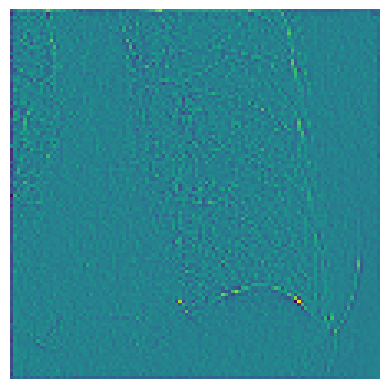

heres an image


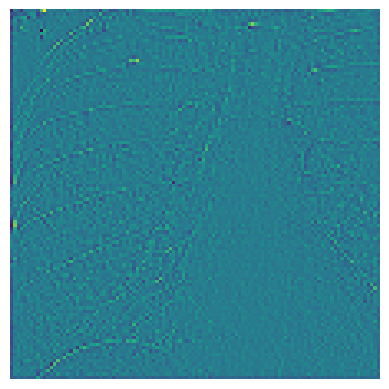

heres an image


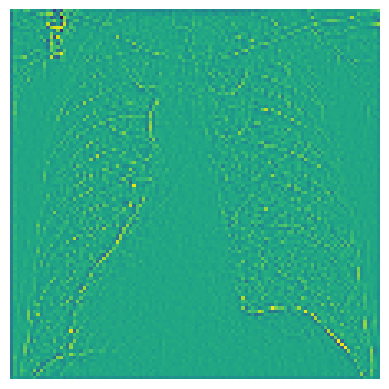

heres an image


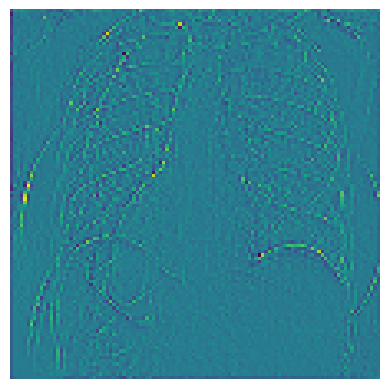

Epoch [1/5], Step [105/512], Loss: 0.1052, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


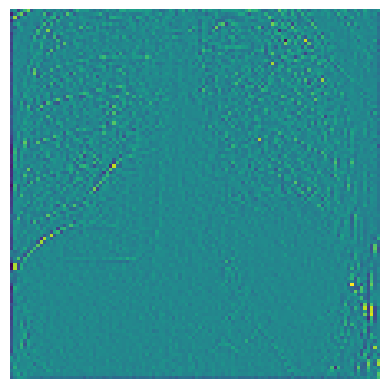

heres an image


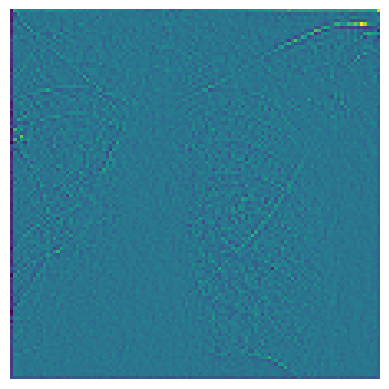

heres an image


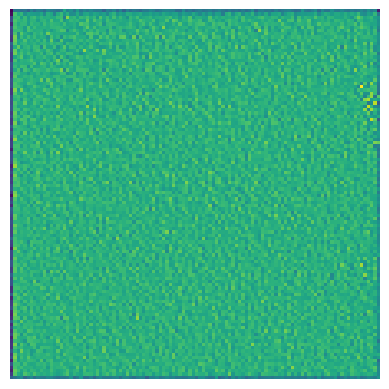

heres an image


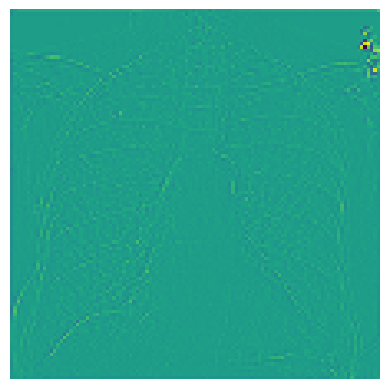

Epoch [1/5], Step [106/512], Loss: 0.2500, tp_sum: 0.0000, fp_sum: 1.0000, fn_sum: 3.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


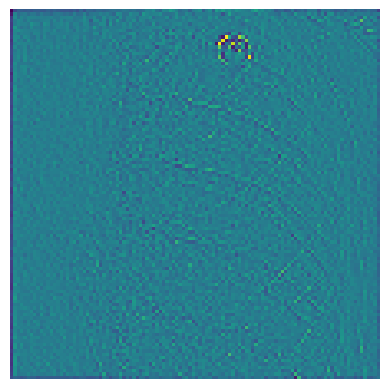

heres an image


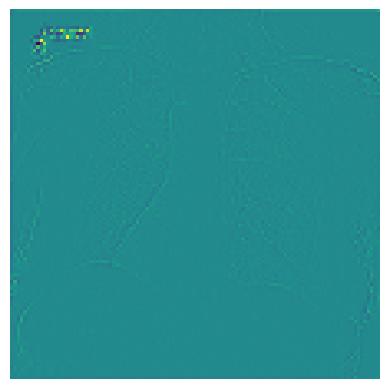

heres an image


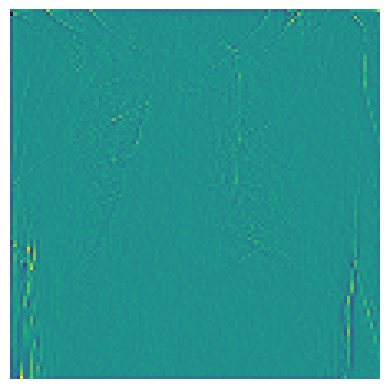

heres an image


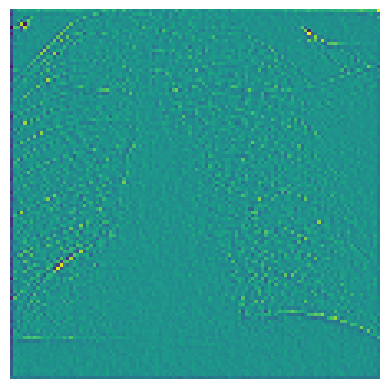

Epoch [1/5], Step [107/512], Loss: 0.0309, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 0.0000, cumulative_f1_score: nan
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


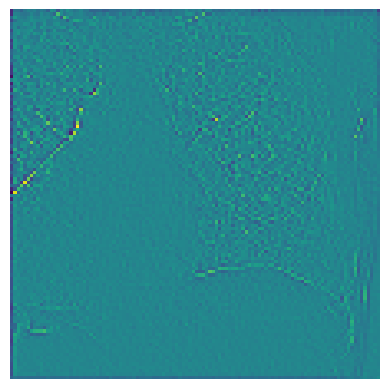

heres an image


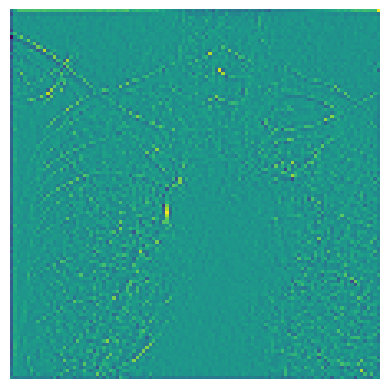

heres an image


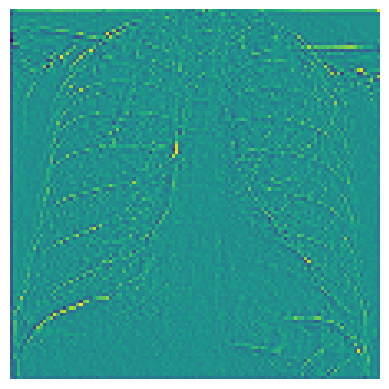

heres an image


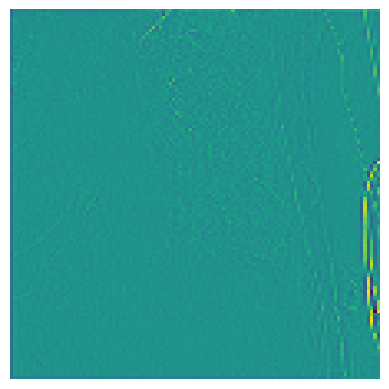

Epoch [1/5], Step [108/512], Loss: 0.1721, tp_sum: 1.0000, fp_sum: 1.0000, fn_sum: 2.0000, cumulative_f1_score: 0.4000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


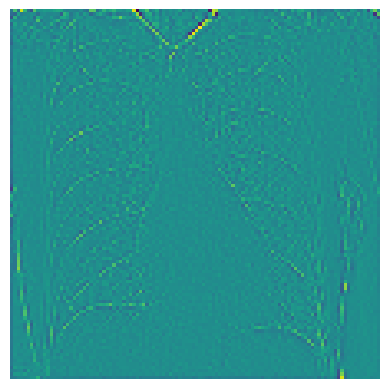

heres an image


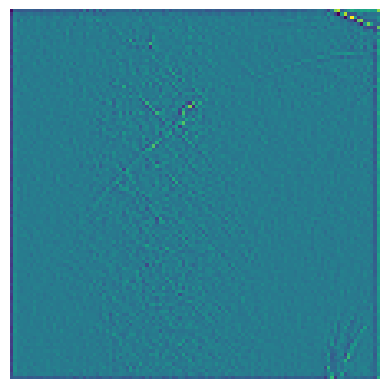

heres an image


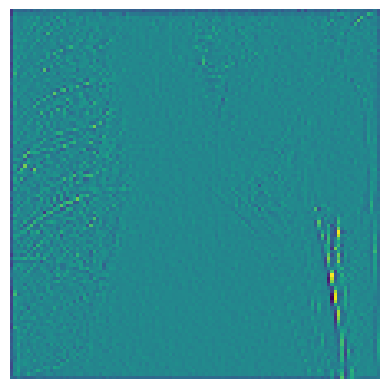

heres an image


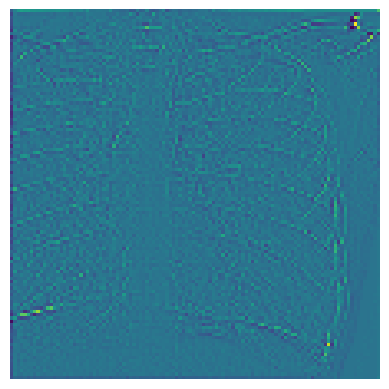

Epoch [1/5], Step [109/512], Loss: 0.1569, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


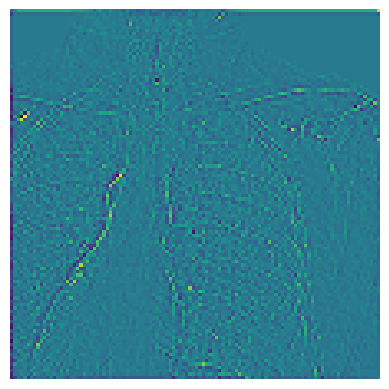

heres an image


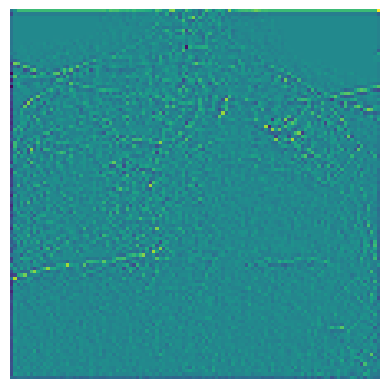

heres an image


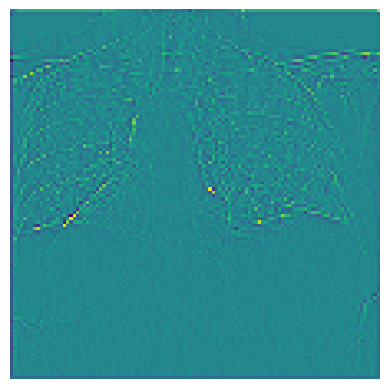

heres an image


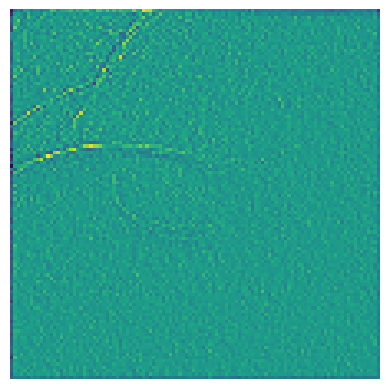

Epoch [1/5], Step [110/512], Loss: 0.1610, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


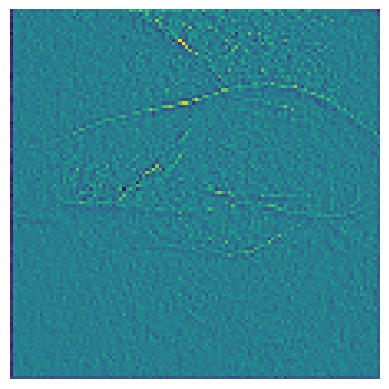

heres an image


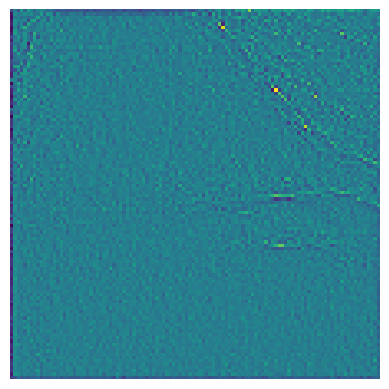

heres an image


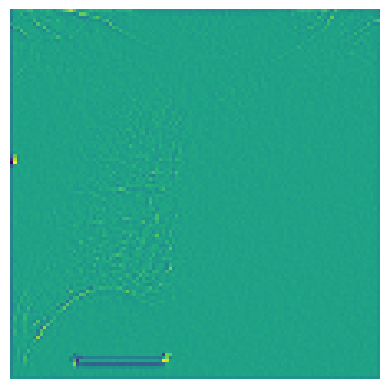

heres an image


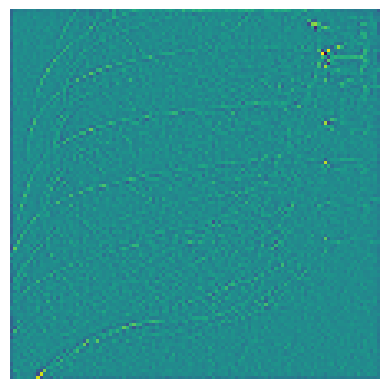

Epoch [1/5], Step [111/512], Loss: 0.1781, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


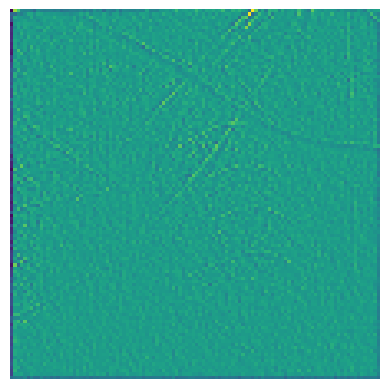

heres an image


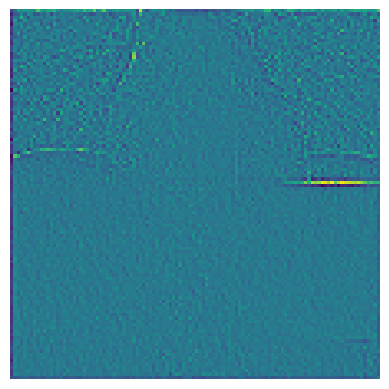

heres an image


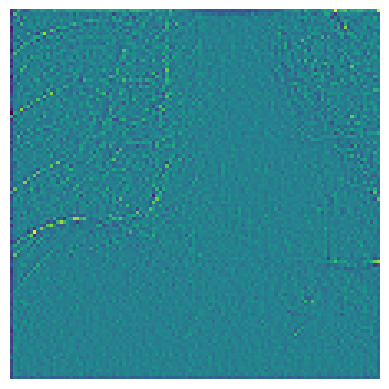

heres an image


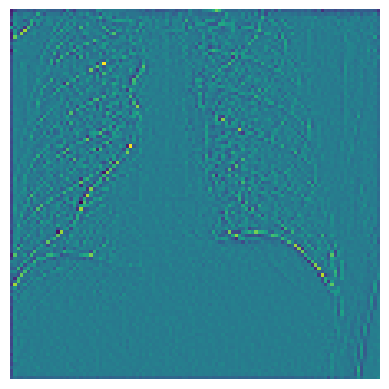

Epoch [1/5], Step [112/512], Loss: 0.1353, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


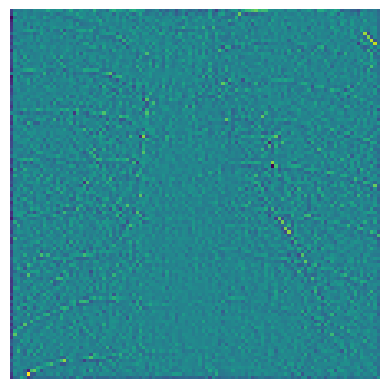

heres an image


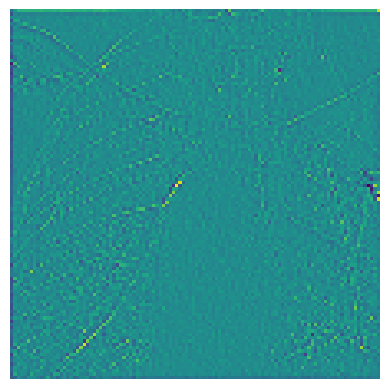

heres an image


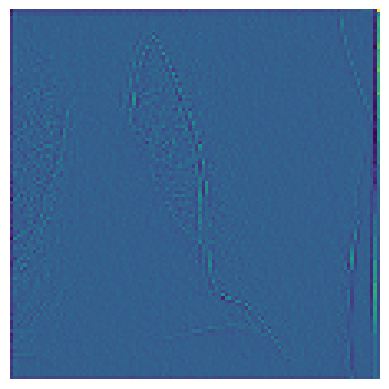

heres an image


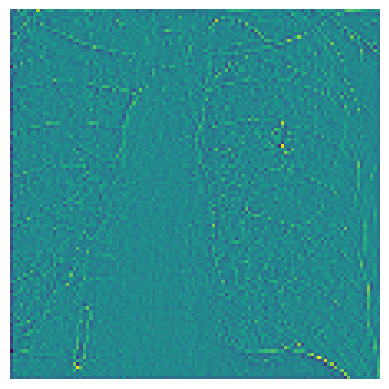

Epoch [1/5], Step [113/512], Loss: 0.2778, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 4.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


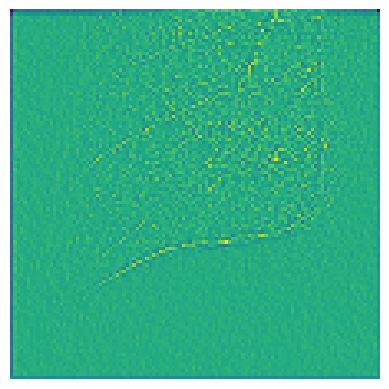

heres an image


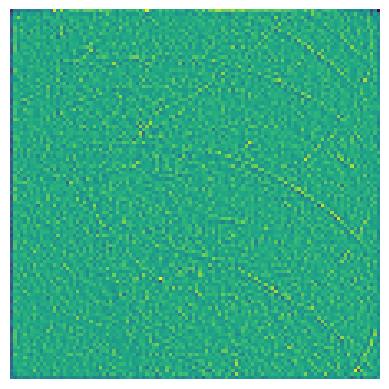

heres an image


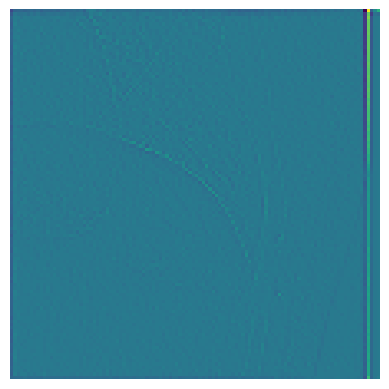

heres an image


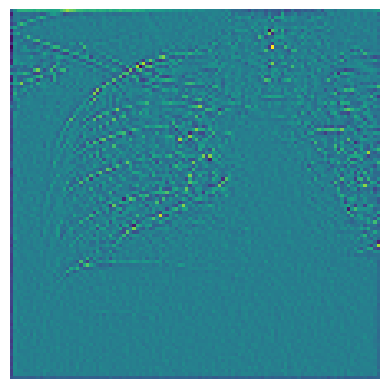

Epoch [1/5], Step [114/512], Loss: 0.0961, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


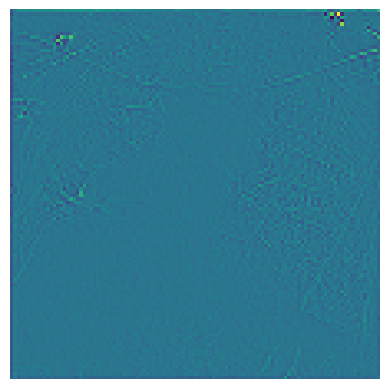

heres an image


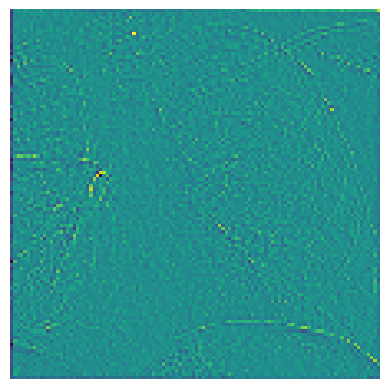

heres an image


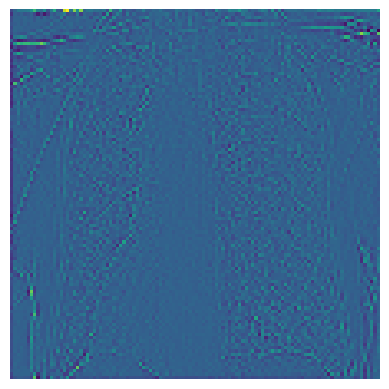

heres an image


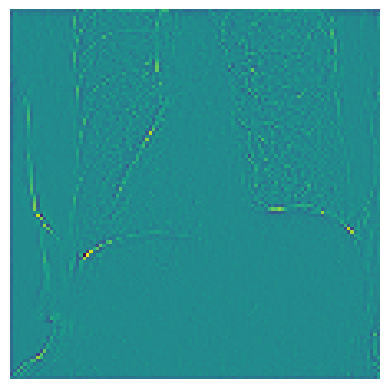

Epoch [1/5], Step [115/512], Loss: 0.2508, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 3.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


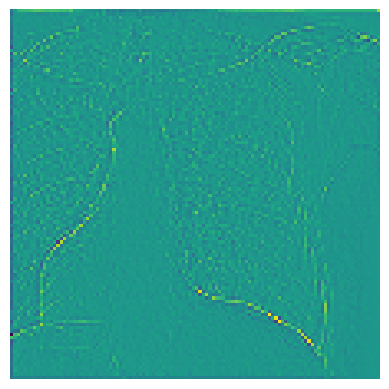

heres an image


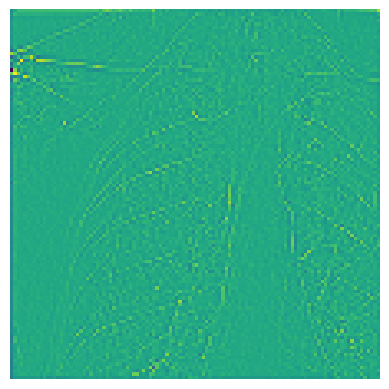

heres an image


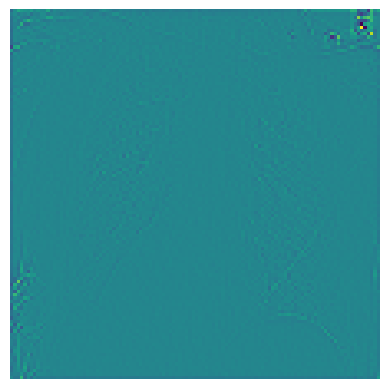

heres an image


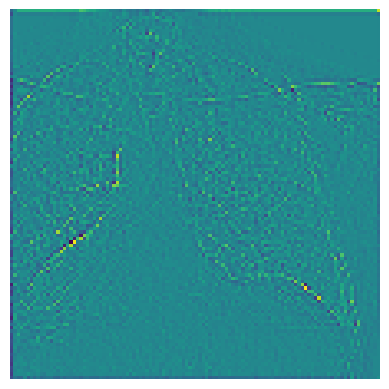

Epoch [1/5], Step [116/512], Loss: 0.1522, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


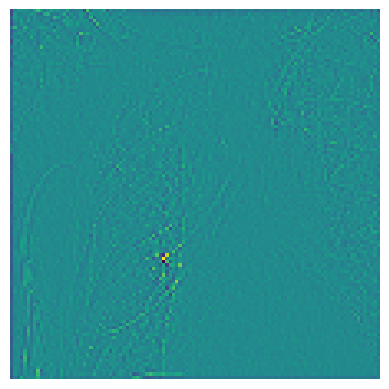

heres an image


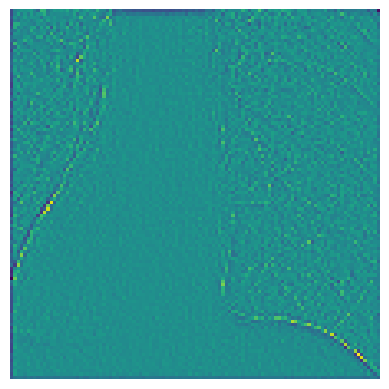

heres an image


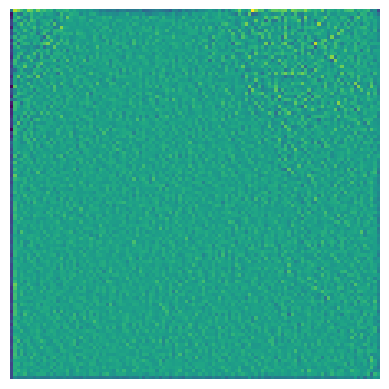

heres an image


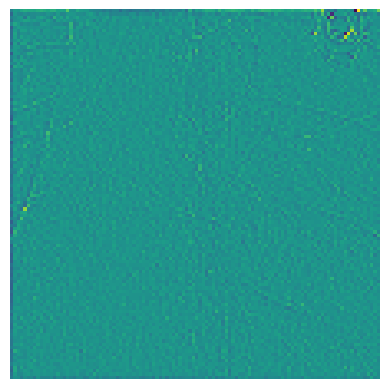

Epoch [1/5], Step [117/512], Loss: 0.0657, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 0.0000, cumulative_f1_score: nan
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


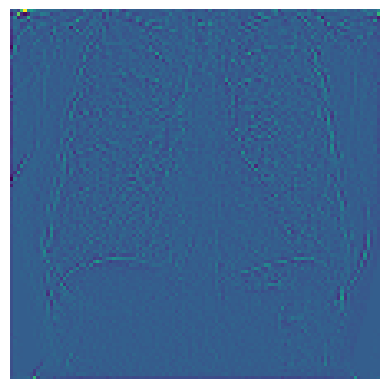

heres an image


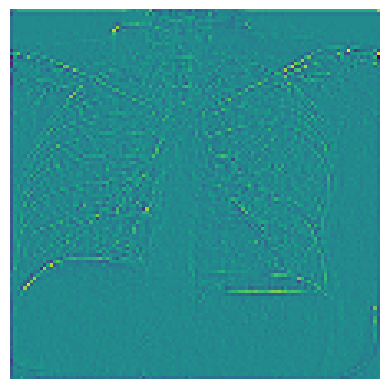

heres an image


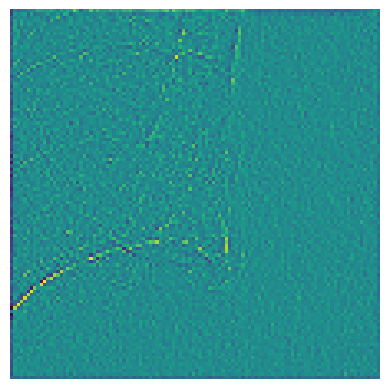

heres an image


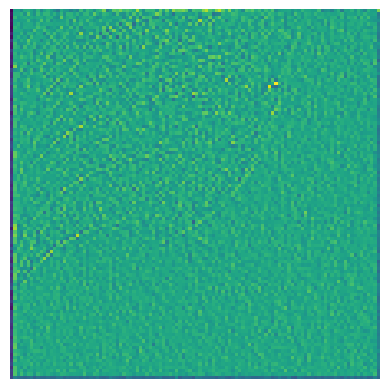

Epoch [1/5], Step [118/512], Loss: 0.1355, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


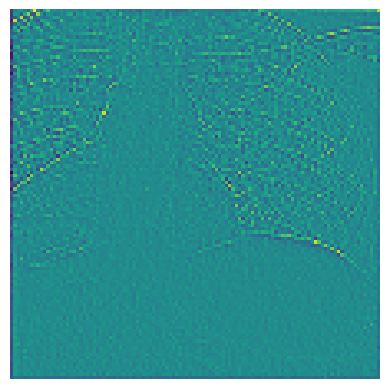

heres an image


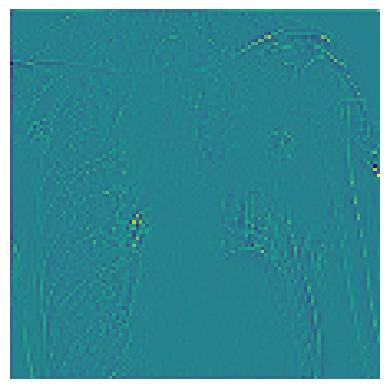

heres an image


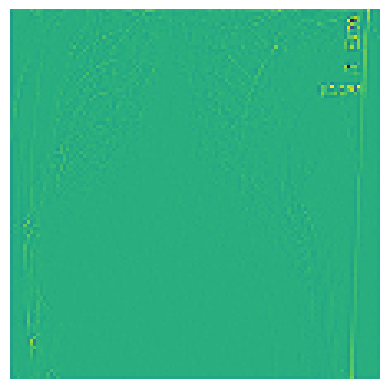

heres an image


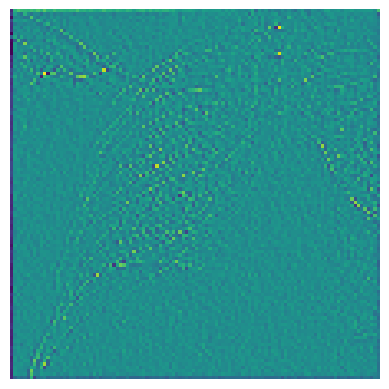

Epoch [1/5], Step [119/512], Loss: 0.2351, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 4.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


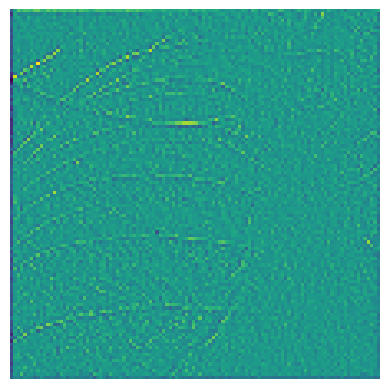

heres an image


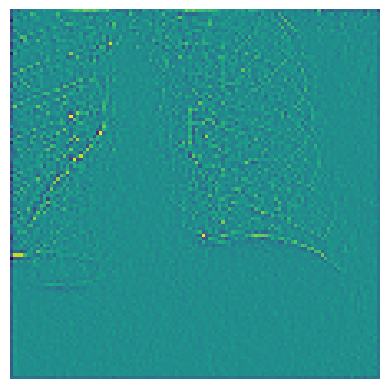

heres an image


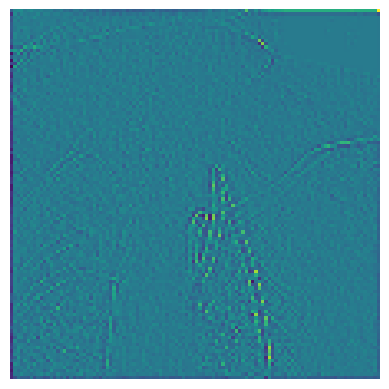

heres an image


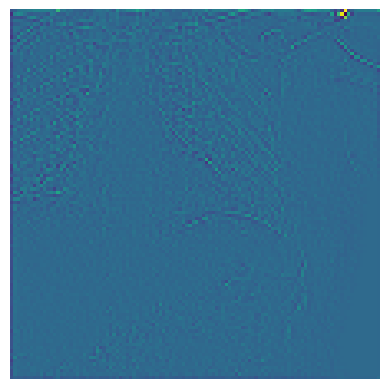

Epoch [1/5], Step [120/512], Loss: 0.0678, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


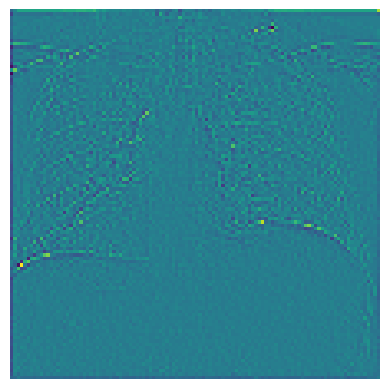

heres an image


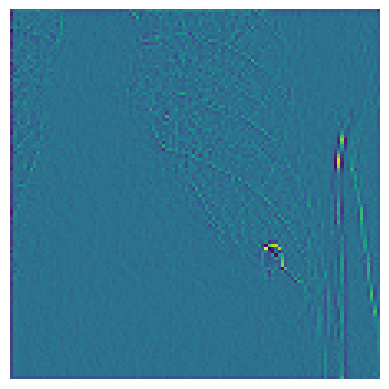

heres an image


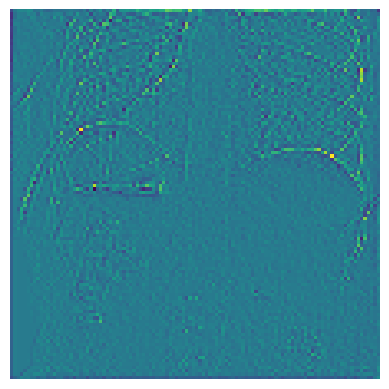

heres an image


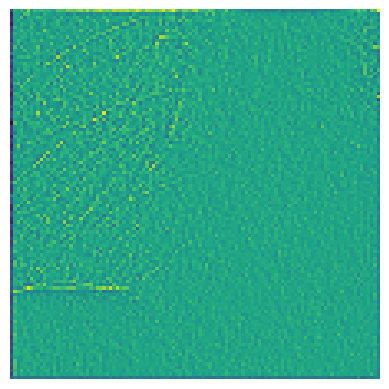

Epoch [1/5], Step [121/512], Loss: 0.0940, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


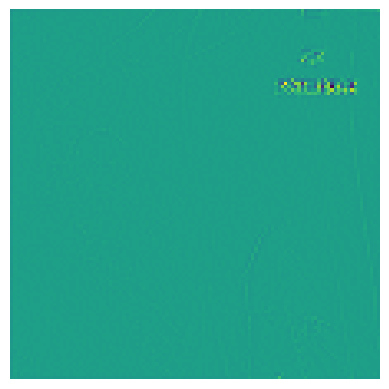

heres an image


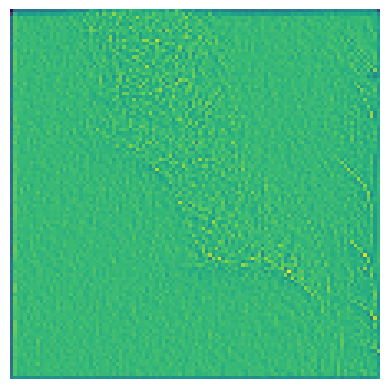

heres an image


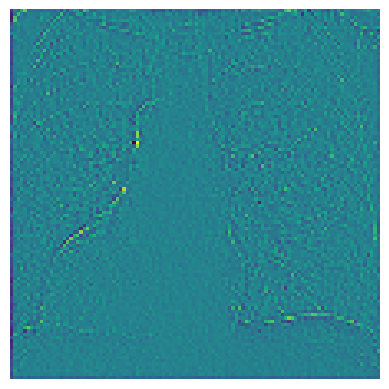

heres an image


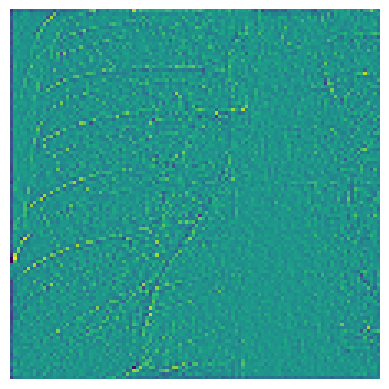

Epoch [1/5], Step [122/512], Loss: 0.1651, tp_sum: 1.0000, fp_sum: 0.0000, fn_sum: 1.0000, cumulative_f1_score: 0.6667
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


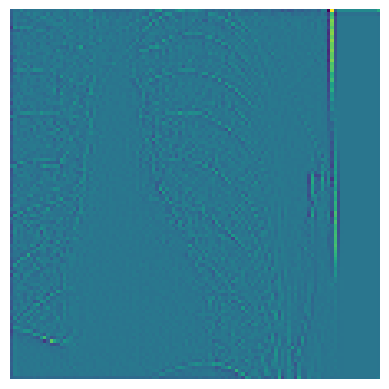

heres an image


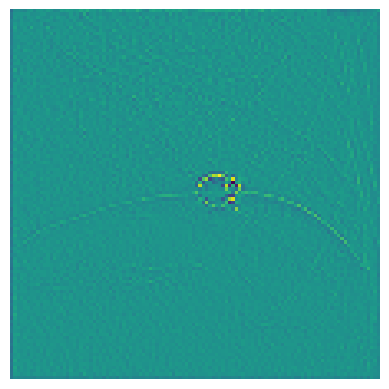

heres an image


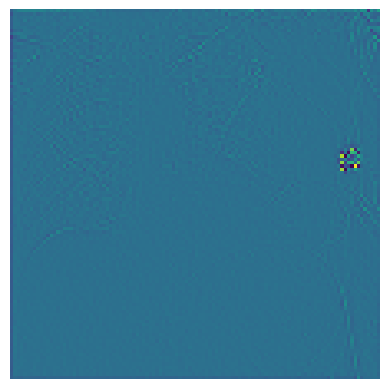

heres an image


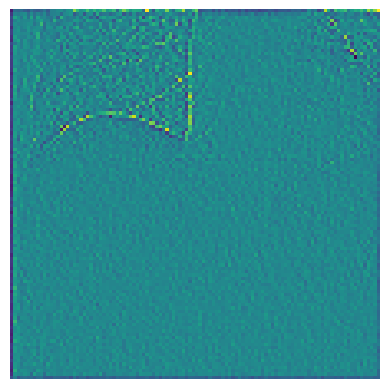

Epoch [1/5], Step [123/512], Loss: 0.1184, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


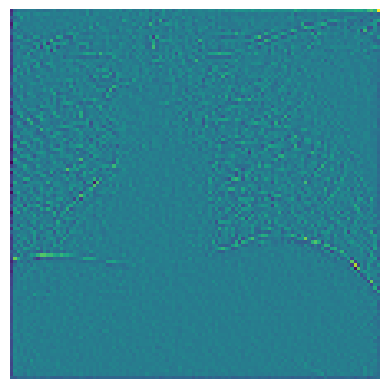

heres an image


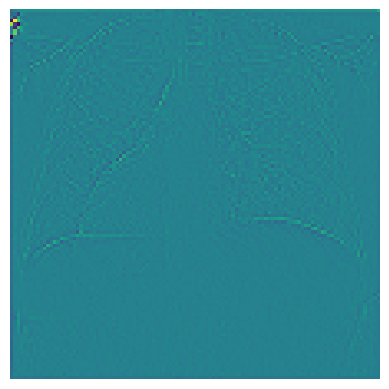

heres an image


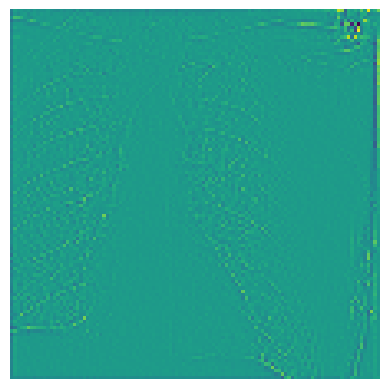

heres an image


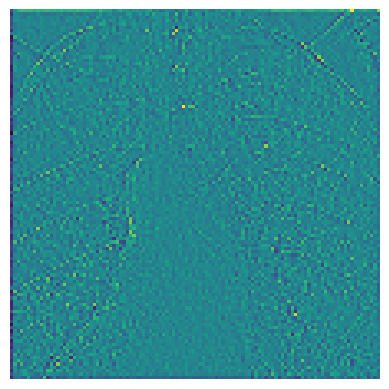

Epoch [1/5], Step [124/512], Loss: 0.1084, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 1.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


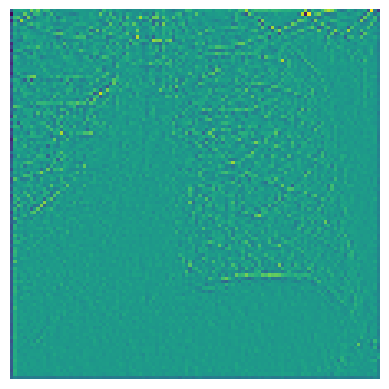

heres an image


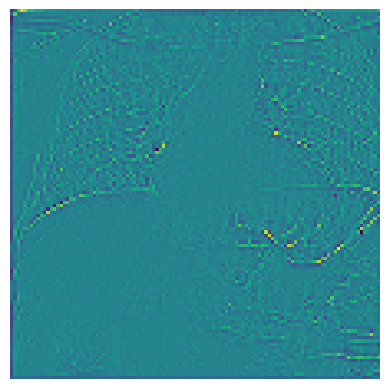

heres an image


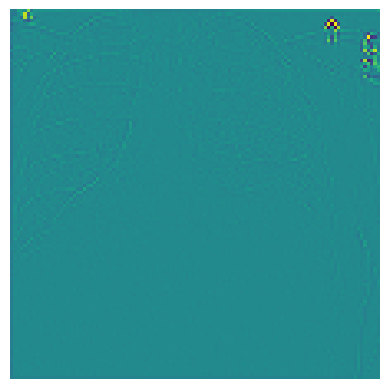

heres an image


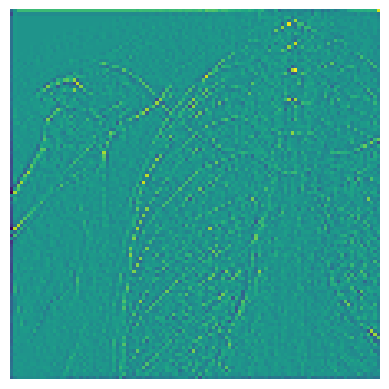

Epoch [1/5], Step [125/512], Loss: 0.1183, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


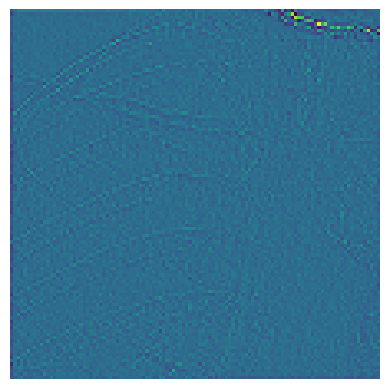

heres an image


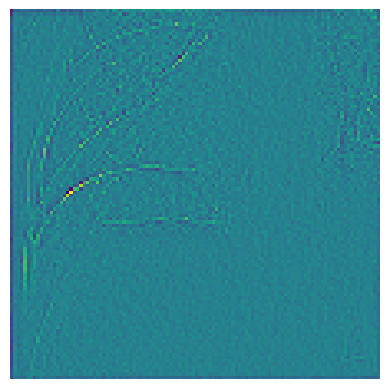

heres an image


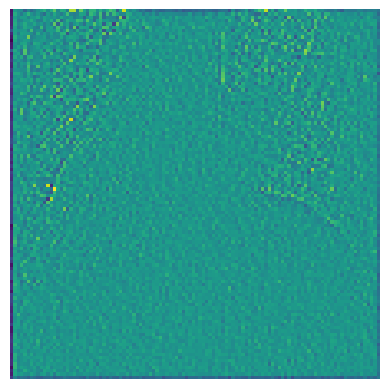

heres an image


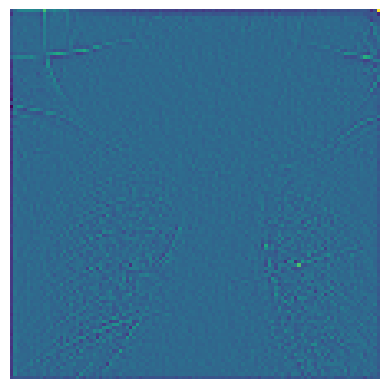

Epoch [1/5], Step [126/512], Loss: 0.1526, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 2.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
image tensor shape: torch.Size([1, 112, 112])
heres an image


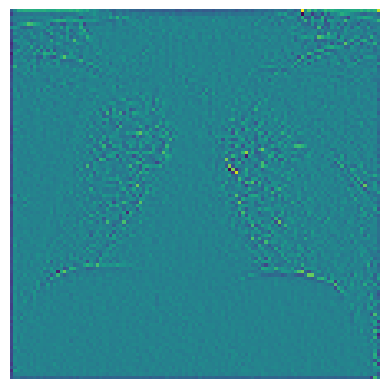

heres an image


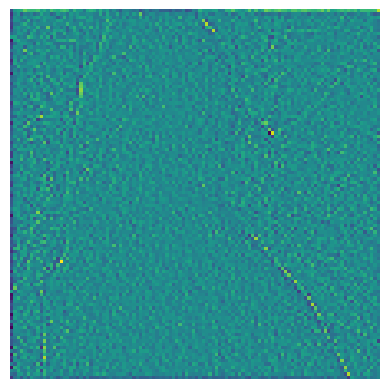

heres an image


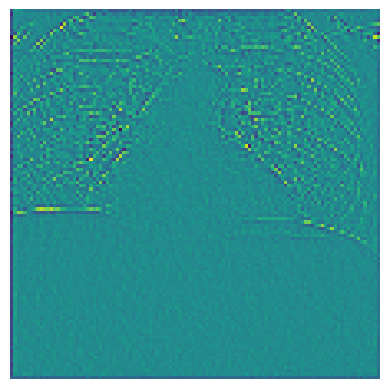

heres an image


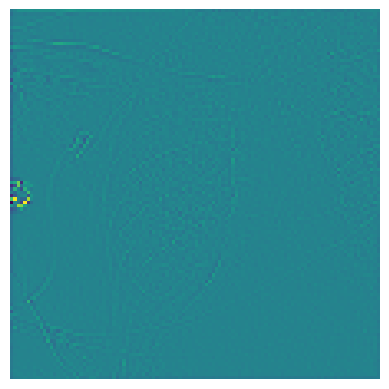

Epoch [1/5], Step [127/512], Loss: 0.2807, tp_sum: 0.0000, fp_sum: 0.0000, fn_sum: 4.0000, cumulative_f1_score: 0.0000
torch.Size([4, 3, 224, 224])


KeyboardInterrupt: 

In [12]:
# Define the loss function and optimizer
criterion = nn.BCELoss(reduction='mean')
optimizer = torch.optim.Adam(model.parameters(), lr = 0.001)
scheduler = ReduceLROnPlateau(optimizer, factor = 0.1, patience = 5, mode = 'min')

# Create a TensorBoard writer
# writer = SummaryWriter()

# Train the model
n_epochs = 5
model.train()
for epoch in range(n_epochs):

    for i, (images, labels, _) in enumerate(train_loader):
        images = images.to(device)
        labels = labels.to(device)
        print(images.shape)
        # Forward pass
        outputs, eda_images = model(images)
        for eda_image in eda_images:
            print("heres an image")
            plt.imshow(eda_image)
            plt.axis('off')
            plt.show()
        loss = criterion(outputs, labels)

        # calculate statistics
        # pred_labels = (nn.Softmax(dim=1)(outputs) > 1/14).long()
        
        tp_array = [0 for x in range(num_class)]
        fp_array = [0 for x in range(num_class)]
        fn_array = [0 for x in range(num_class)]
        pred_labels = (outputs > 1/4).long()
        tp_array += sum(torch.logical_and(pred_labels, labels))
        fp_array += sum(torch.logical_and(torch.logical_xor(pred_labels, labels).long(), pred_labels))
        fn_array += sum(torch.logical_and(torch.logical_xor(pred_labels, labels).long(), labels))
        
        # Backprop
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        
        scheduler.step(loss)

        # Display
        # if (i + 1) % 100 == 0:
        print("Epoch [{}/{}], Step [{}/{}], Loss: {:.4f}, tp_sum: {:.4f}, fp_sum: {:.4f}, fn_sum: {:.4f}, cumulative_f1_score: {:.4f}".format(epoch + 1, \
                                                                     n_epochs, \
                                                                     i + 1, \
                                                                     len(train_loader), \
                                                                     loss,\
                                                                     sum(tp_array), \
                                                                     sum(fp_array),\
                                                                     sum(fn_array),\
                                                                     f1_score(sum(tp_array), sum(fp_array), sum(fn_array))))
    #     print("outputs\n", outputs)
    #     print("pred_labels\n", pred_labels)
    #     print("actual labels\n", labels)
    break

In [ ]:
images[[0],:,:,:].shape

torch.Size([1, 3, 224, 224])